In [1]:
#import packages

In [2]:
#use this with schpf_p37 environment
!conda list

# packages in environment at /home/wallet/miniconda3/envs/2022_Peer_SPADE_cellrank2:
#
# Name                    Version                   Build  Channel
_libgcc_mutex             0.1                 conda_forge    conda-forge
_openmp_mutex             4.5                       2_gnu    conda-forge
_r-mutex                  1.0.1               anacondar_1    conda-forge
alabaster                 0.7.12                     py_0    conda-forge
alsa-lib                  1.2.6.1              h7f98852_0    conda-forge
anndata                   0.8.0           py310hff52083_0    conda-forge
anyio                     3.6.1           py310hff52083_0    conda-forge
appdirs                   1.4.4              pyh9f0ad1d_0    conda-forge
argon2-cffi               21.3.0             pyhd8ed1ab_0    conda-forge
argon2-cffi-bindings      21.2.0          py310h5764c6d_2    conda-forge
arpack                    3.7.0                hdefa2d7_2    conda-forge
asttokens                 2.0.5            

In [ ]:
#custom library
from SPECTRA_processing_utils import *
from scrnaseq_preprocessing_utils.py import *

In [3]:
#import packages
import scanpy as sc
import scanpy.external as sce
import anndata as anndata
from anndata import AnnData

import time
import os
import numpy as np
import seaborn as sns
import pandas as pd
import re
import h5py
import scipy
import matplotlib
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
from matplotlib.colors import LinearSegmentedColormap
import matplotlib.patches as patches
import matplotlib.colors as colors
import matplotlib.font_manager
%matplotlib inline

# other packages
import glob
from collections import OrderedDict
from scipy.sparse import csr_matrix
from scanpy.external.pp import magic
from scipy.stats import zscore
import scipy.cluster.hierarchy as hc
from statistics import median
import math
from typing import Union
import numpy.matlib

In [4]:
DATA_DIR = '/data/peer/wallet/Jupyter/SPADE_Peer_validation/data/'
figure_save_path =  '/data/peer/wallet/Jupyter/SPADE_Peer_validation/figures/'

In [10]:
#set style
sns.set_style('white')
# define colors
color_map_clusters = ["#FFFF00", "#1CE6FF", "#FF34FF", "#FF4A46", "#008941", "#006FA6", "#A30059",
"#FFDBE5", "#7A4900", "#0000A6", "#63FFAC", "#B79762", "#004D43", "#8FB0FF", "#997D87",
"#5A0007", "#809693", "#1B4400", "#4FC601", "#3B5DFF", "#4A3B53", "#FF2F80",
"#61615A", "#BA0900", "#6B7900", "#00C2A0", "#FFAA92", "#FF90C9", "#B903AA", "#D16100",
"#DDEFFF", "#000035", "#7B4F4B", "#A1C299", "#300018", "#0AA6D8", "#013349", "#00846F",
"#372101", "#FFB500", "#C2FFED", "#A079BF", "#CC0744", "#C0B9B2", "#C2FF99", "#001E09",
"#00489C", "#6F0062", "#0CBD66", "#EEC3FF", "#456D75", "#B77B68", "#7A87A1", "#788D66",
"#885578", "#FAD09F", "#FF8A9A", "#D157A0", "#BEC459", "#456648", "#0086ED", "#886F4C",
"#34362D", "#B4A8BD", "#00A6AA", "#452C2C", "#636375", "#A3C8C9", "#FF913F", "#938A81",
"#575329", "#00FECF", "#B05B6F", "#8CD0FF", "#3B9700", "#04F757", "#C8A1A1", "#1E6E00",
"#7900D7", "#A77500", "#6367A9", "#A05837", "#6B002C", "#772600", "#D790FF", "#9B9700",
"#549E79", "#FFF69F", "#201625", "#72418F", "#BC23FF", "#99ADC0", "#3A2465", "#922329",
"#5B4534", "#FDE8DC", "#404E55", "#0089A3", "#CB7E98", "#A4E804", "#324E72", "#6A3A4C"]

color_map_clusters_nogrey = ["#FFFF00", "#1CE6FF", "#FF34FF", "#FF4A46", "#008941", "#006FA6", "#A30059", "#7A4900", "#0000A6", "#63FFAC", "#B79762", "#004D43", "#8FB0FF", "#997D87",
"#5A0007", "#809693", "#1B4400", "#4FC601", "#3B5DFF", "#4A3B53", "#FF2F80",
"#61615A", "#BA0900", "#6B7900", "#00C2A0", "#FFAA92", "#FF90C9", "#B903AA", "#D16100",
"#DDEFFF", "#000035", "#7B4F4B", "#A1C299", "#300018", "#0AA6D8", "#013349", "#00846F",
"#372101", "#FFB500", "#C2FFED", "#A079BF", "#CC0744", "#C0B9B2", "#C2FF99", "#001E09",
"#00489C", "#6F0062", "#0CBD66", "#EEC3FF", "#456D75", "#B77B68", "#7A87A1", "#788D66",
"#885578", "#FAD09F", "#FF8A9A", "#D157A0", "#BEC459", "#456648", "#0086ED", "#886F4C",
"#34362D", "#B4A8BD", "#00A6AA", "#452C2C", "#636375", "#A3C8C9", "#FF913F", "#938A81",
"#575329", "#00FECF", "#B05B6F", "#8CD0FF", "#3B9700", "#04F757", "#C8A1A1", "#1E6E00",
"#7900D7", "#A77500", "#6367A9", "#A05837", "#6B002C", "#772600", "#D790FF", "#9B9700",
"#549E79", "#FFF69F", "#201625", "#72418F", "#BC23FF", "#99ADC0", "#3A2465", "#922329",
"#5B4534", "#FDE8DC", "#404E55", "#0089A3", "#CB7E98", "#A4E804", "#324E72", "#6A3A4C"]

blue_red = ['#0E518F','#DF480F']
expansion_dict = {'NE':'#0E518F','E': '#DF480F','nan':'#dedede'}
timepoint_dict = {'Pre':'#0E518F','On': '#DF480F','nan':'#dedede'}
subtype_color_dict = {'global':'#FFFFFF','TAM':'#FFFF00',
                 'DC_cDC2A':'#1CE6FF',
                 'pDC':'#FF34FF',
                 'M-MDC':'#FF4A46',
                 'mono_c':'#008941',
                 'mast':'#006FA6',
                      'TAM_TRMac':'#456D75',
                 'DC_cDC1':'#A30059',
                 'Gr-MDC':'#7A4900',
                 'DC_Langerhans':'#0000A6',
                      'DC_AXLpos_ITGAXpos':'#0CBD66',
                      'DC_FDC_PTPRCpos':'#EEC3FF',
                'DC_cDC3':'#63FFAC',
                'CD8_T':'#B79762',
                'Treg':'#004D43',
                'CD4_T':'#8FB0FF',
                'CD8_T':'#997D87',
                 'NK':'#5A0007',
                 'gdT':'#809693',
                    'ILC3':'#7900D7',
                       'CD8_T_KLRG1pos_effector_preexhausted':'#4FC601',
                 'CD4_T_naive':'#3B5DFF',
                 'CD4_T_TH1':'#4A3B53',
                 'CD8_T_TRM':'#FF2F80',
                'CD8_T_TRM_exhausted':'#61615A',
                 'CD8_T_naive':'#BA0900',
                 'CD8_T_KLRG1pos_effector_preexhausted':'#6B7900',
             'CD4_T_naive_low_libsize':'#00C2A0',
                 'CD8_T_naive':'#FFAA92',
             'NK_CD56bright':'#FF90C9',
                 'CD8_T_TEM_effector_exhausted-progenitor':'#B903AA',
            'gdT':'#D16100',
              'CD8_T_KLRG1pos_effector_nonexhausted':'#DDEFFF',
              'CD8_T_TRM_exhausted_proliferating':'#000035',
            'CD4_T_TH1_proliferating':'#7B4F4B',
               'NK_CD56dim':'#A1C299',
               'Treg':'#300018',
                  'CD8_T_KLRG1pos_effector_preexhausted':'#0AA6D8',
                         'MDC':'#013349',
                 'DC':'#FF0000',
                'mixed_T_M':'#636375',
                        'B_memory':'#372101',
                
                 'B_naive':'#FFB500',
                'plasma':'#C2FFED',
                'B_GC':'#A079BF',
                    'B_memory_switched':'#CC0744',
                'plasma_IgA':'#C0B9B2',
                 'B_memory_double_neg':'#C2FF99',
               'plasma_IgG':'#001E09',
                'plasmablast':'#00489C',
               'plasma_Be1':'#6F0062',
                     'M':'#B77B68',
                     'TNK':'#7A87A1',
                     'B':'#788D66',
                     'TAM_MKlike':'#885578',
                     'mono':'#34362D',
                     'mono_c':'#B4A8BD',
                     'mono_nc':'#00A6AA',
                     'ILC1':'#452C2C',
                     'CD4_T_TFH':'#A3C8C9',
                     'CD4_T_TFH_exhausted-progenitor':'#FF913F',
                     'CD4_T_TSCM':'#938A81',
                     'CD8_T_KLRG1neg_effector_preexhausted':'#575329',
                     'CD8_T_KLRG1pos_effector_exhausted':'#00FECF',
                     'CD8_T_TRM_nonexhausted':'#B05B6F',
                     'CD8_T_innate-like':'#8CD0FF',
                     'TNK_proliferating':'#3B9700',
                     'NK_CD56dim_proliferating':'#04F757',
                     'T':'#C8A1A1',
                     'T_proliferating':'#1E6E00',
                     'B_memory':"#BC23FF",
                      'B_naive':"#A77500",
                      'plasma':"#6367A9",
                 'B_GC':"#A05837",
                      'B_memory_switched':"#6B002C",
                 'B_naive':"#772600",
              'plasma_IgA':"#D790FF",
                'B_memory_double_neg':"#9B9700",
               'plasma_IgG':"#549E79",
                 'plasmablast':"#FFF69F",
                'plasma_IgG':"#201625",
                 'plasma_Be1':"#72418F",
                      'B':"#922329", 
                      'TNK':"#99ADC0",
                      'M': "#3A2465",
                      'nan':'#000000',
                      'B_GC_proliferating':'#5B4534',
                      'B_memory_switched_Be1':'#FDE8DC',
                      'B_memory_switched_proliferating':'#404E55',
                      'plasma_IgG_Be1':'#0089A3',
                       'B_proliferating':'#CB7E98'
                }


perturbation_map = ['#EFD060','#0289DE','#0289DE','#DCA6C4']
stage_map = ['#EFD060','#0289DE','#67C6F8','#DCA6C4']
stage_map_2 = ['#EFD060','#0289DE','#DCA6C4']
perturbation_stage_map_2 = ['#F95957', '#FF0300','#EFD060','#0289DE','#0289DE','#DCA6C4','#EFD060','#0289DE','#DCA6C4']
perturbation_stage_map = ['#F95957', '#FF0300','#e1e1e1','#e1e1e1','#e1e1e1','#e1e1e1', '#EFD060','#0289DE','#DCA6C4']
color_map_clusters_plt = cm = LinearSegmentedColormap.from_list(
        'color_map_clusters', color_map_clusters)
treat_untreat_palette = ['#0E518F', '#DF480F', '#a7a7a7']
#scanpy layout
sc.set_figure_params(scanpy=True, dpi=150, dpi_save=300, frameon=False, vector_friendly=True, fontsize=7, figsize=None, color_map=None, format='pdf', facecolor=None, transparent=True, ipython_format='png2x')
sns.set_style('white')



batlow_20 = ['#1d2356','#1d2b59',
'#14375e',
'#134460',
'#1c5261',
'#235f5f',
'#396a58',
'#4c714e',
'#607843',
'#757e36',
'#8d8532',
'#a78b30',
'#c49138',
'#dc954d',
'#f09c6a',
'#f8a487',
'#f8aca2',
'#f8b5be',
'#f8c2d9',
'#eecbe1'] 
import random
random.seed(1)
random.shuffle(batlow_20)

# compare overlap coef for global scHPF and SPECTRA

In [15]:
adata_path_scHPF = DATA_DIR + 'BRCA-X-TIL-X-Bassez_2021-X-cohort1_2_annotated_211208_cell-type-spec_global0.01_delta_0.001_beta_0.0_pseudo_0.0_50PC_reembedded_scHPF-full.h5ad'

adata_path_SPECTRA =DATA_DIR +  'BRCA-X-TIL-X-Bassez_2021-X-cohort1_2_annotated_211208_cell-type-spec_global0.01_delta_0.001_beta_0.0_pseudo_0.0_50PC_reembedded.h5ad'

SPECTRA_markers = DATA_DIR + 'BRCA-X-TIL-X-Bassez_2021-X-cohort1_2_raw_filtered_clustered_drops_annotated_nodrops_log1p_clustered_leukocytes_scran_annotated_clustered_imputed_hvgenes_andmarker_15000_clustered_imputed_v2_210501_annotated_maxmarkers.csv'
SLALOM_markers =DATA_DIR +  'BRCA-X-TIL-X-Bassez_2021-X-cohort1_2_annotated_211208_cell-type-spec_global0.01_delta_0.001_beta_0.0_pseudo_0.0_50PC_reembedded_SLALOM-full.csv'
scHPF_markers = DATA_DIR + 'BRCA-X-TIL-X-Bassez_2021-X-cohort1_2_annotated_211208_cell-type-spec_global0.01_delta_0.001_beta_0.0_pseudo_0.0_50PC_reembedded_scHPF-full_allmarkers.csv'

adata_path_SLALOM = DATA_DIR + 'BRCA-X-TIL-X-Bassez_2021-X-cohort1_2_annotated_211208_cell-type-spec_global0.01_delta_0.001_beta_0.0_pseudo_0.0_50PC_reembedded_SLALOM-full.h5ad'


input_gene_sets = DATA_DIR +'SPADE_genes_x_genesets.csv'
input_spec_gs = DATA_DIR + 'SPADE_cells_x_genesets_celltype-specific_modified_for_SPADE.csv'
input_general_gs = DATA_DIR + 'SPADE_cells_x_genesets_general.csv'
metadata_gs = DATA_DIR + 'SPADE_genesets_x_geneset_metadata_mod.csv'

gs_per_g_path =DATA_DIR +  'data/gs_per_g_df.csv'
g_per_gs_path =DATA_DIR +  'g_per_gs_df.csv'

NMF_save_path = DATA_DIR + 'BRCA-X-TIL-X-Bassez_2021-X-cohort1_2_annotated_211208_cell-type-spec_global0.01_delta_0.001_beta_0.0_pseudo_0.0_50PC_reembedded_NMF100fac.h5ad'

In [16]:
#adata
adata_scHPF = sc.read(adata_path_scHPF)

Only considering the two last: ['.0_50PC_reembedded_scHPF-full', '.h5ad'].
Only considering the two last: ['.0_50PC_reembedded_scHPF-full', '.h5ad'].


In [18]:
#adata
adata_SLALOM = sc.read(adata_path_SLALOM)

Only considering the two last: ['.0_50PC_reembedded_SLALOM-full', '.h5ad'].
Only considering the two last: ['.0_50PC_reembedded_SLALOM-full', '.h5ad'].


In [20]:
adata_SLALOM.uns['SLALOM_markers_global']

{'SLALOM_0': array(['FTL', 'CST3', 'HLA-DRA', 'CD74', 'PSAP', 'HLA-DRB1', 'C1QC',
        'C1QB', 'HLA-DPA1', 'SAT1', 'C1QA', 'LYZ', 'APOE', 'HLA-DPB1',
        'NPC2', 'AIF1', 'HLA-DRB5', 'GRN', 'HLA-DQA1', 'MS4A6A',
        'HLA-DQB1', 'RNASE1', 'TYMP', 'FCGRT', 'CD63', 'CD14', 'CTSS',
        'TYROBP', 'NEAT1', 'HLA-DMA', 'CAPG', 'CTSZ', 'TMEM176B', 'MS4A7',
        'CTSH', 'CYBB', 'MAFB', 'PLD3', 'ASAH1', 'C1orf162', 'LAPTM5',
        'SGK1', 'CSF1R', 'CXCL10', 'FCER1G', 'TNFSF13B', 'MFSD1', 'FGL2',
        'CTSC', 'HLA-DMB'], dtype=object),
 'SLALOM_1': array(['SLC35A1', 'AC103831.1', 'LAG3', 'ITK', 'PRNP', 'CCDC178', 'E2F2',
        'TRIM63', 'DSCR8', 'CD207', 'MMP12', 'CD1C', 'TAB2', 'SLC26A7',
        'ANKRA2', 'LINC01152', 'NOP16', 'XBP1', 'CRLF2', 'FOSL2', 'ERI2',
        'CDC14B', 'SLC5A9', 'PBX1', 'LRAT', 'AC026471.3', 'PRDX3',
        'KIF21A', 'TMLHE', 'TAT', 'ATF3', 'IDH2', 'TNFAIP1', 'SETDB2',
        'EPAS1', 'HELZ2', 'KLF13', 'ARID1B', 'TMEM168', 'TMEM45A', 'IL32',
  

In [21]:
#adata
adata_SPECTRA = sc.read(adata_path_SPECTRA)

Only considering the two last: ['.0_50PC_reembedded', '.h5ad'].
Only considering the two last: ['.0_50PC_reembedded', '.h5ad'].


In [ ]:
#fit NMF model
import numpy as np
X = adata_SPECTRA.X
from sklearn.decomposition import NMF
model = NMF(n_components=100, init='random', random_state=0)
W = model.fit_transform(X)
H = model.components_

In [ ]:
#retrieve NMF marker genes
NMF_weights = pd.DataFrame(H, columns=adata_SPECTRA.var_names).T #dataframe genes x factors
NMF_markers = pd.DataFrame()
for i in NMF_weights.columns:
    NMF_markers[i] = NMF_weights[i].sort_values(ascending=False).index[0:50]

#add to adata

adata_NMF = adata_SPECTRA.copy()
adata_NMF.uns['NMF_markers_global'] = {'NMF_'+str(x):list(NMF_markers[x]) for x in NMF_markers.columns}#transformation to numpy array required for writing adata

for i in NMF_markers.columns:
    adata_NMF.obs['NMF_'+str(i)] = np.array(W[:,i])

In [28]:
adata_NMF.write(NMF_save_path)
print('saved data to:',NMF_save_path)

saved data to: /data/peer/wallet/Jupyter/SPADE_Peer_validation/data/BRCA-X-TIL-X-Bassez_2021-X-cohort1_2_annotated_211208_cell-type-spec_global0.01_delta_0.001_beta_0.0_pseudo_0.0_50PC_reembedded_NMF100fac.h5ad


In [28]:
input_df = pd.read_csv(input_gene_sets)
input_df

,gs.name,g.name
0,all_multidrug-resistance,ABCC4
1,all_multidrug-resistance,ABCB4
2,all_multidrug-resistance,ABCC3
3,all_multidrug-resistance,ABCC1
4,all_porphyrine-heme_metabolism,UROS
...,...,...
7855,all_folate_metabolism,SLC19A1
7856,all_folate_metabolism,AMT
7857,all_folate_metabolism,FOLR3
7858,all_folate_metabolism,FTCD


In [29]:
input_spec = pd.read_csv(input_spec_gs)
input_spec

,gs.name,c.name
0,CD8-T_tumor-reactive-like_UP,CD8_T
1,DC_antigen-crosspresentation,DC
2,CD8-T_terminal-exhaustion,CD8_T
3,B_Breg_UP,B_memory
4,M_angiogenic-effectors,MDC
5,CD4-T_IL12_response,CD4_T
6,TNK_IL2_response,CD4_T
7,T_tcr-activation,CD8_T
8,CD4-T_TH22_UP,CD4_T
9,Mac_LPS_response,MDC


In [30]:
input_glob = pd.read_csv(input_general_gs)
input_glob

,gs.name,c.name
0,all_multidrug-resistance,all-cells
1,all_porphyrine-heme_metabolism,all-cells
2,all_TNF-via-NFkB_signaling,all-cells
3,all_glyoxylate-dicarboxylate_metabolism,all-cells
4,all_IL6-JAK-STAT3_signaling,all-cells
...,...,...
145,all_ethanol_metabolism,all-cells
146,all_taurine-hypotaurine_metabolism,all-cells
147,all_glycerophospholipid_metabolism,all-cells
148,all_complement_production,all-cells


In [31]:
#subset to gs used for SPECTRA

input_df_sub = input_df[input_df['gs.name'].isin(list(set(input_glob['gs.name']))+list(set(input_spec['gs.name'])))]
input_df_sub

,gs.name,g.name
0,all_multidrug-resistance,ABCC4
1,all_multidrug-resistance,ABCB4
2,all_multidrug-resistance,ABCC3
3,all_multidrug-resistance,ABCC1
4,all_porphyrine-heme_metabolism,UROS
...,...,...
7855,all_folate_metabolism,SLC19A1
7856,all_folate_metabolism,AMT
7857,all_folate_metabolism,FOLR3
7858,all_folate_metabolism,FTCD


In [32]:
metadata_df = pd.read_csv(metadata_gs)
metadata_df

,v.id,v.author,gs.name,gst.name,gsto.name,a.name
0,v_hs239,wallet,all_MYC_targets,bulk_curated,proliferation_cell_cycle,cellular_process
1,v_hs243,"wallet, Arthur_Liberzon_(MSigDB_Team)",all_TGFb_response,bulk_curated,immune_cellular_response,cellular_process
2,v_hs98,"Arthur_Liberzon_(MSigDB Team), wallet",all_TNF-via-NFkB_signaling,bulk_curated,immune_cellular_response,cellular_process
3,v_hs234,wallet,B_IgM-ligation_response,bulk_curated,immune_cellular_response,cellular_process
4,v_hs232,wallet,CD4-T_IL12_response,bulk_curated,immune_cellular_response,cellular_process
...,...,...,...,...,...,...
176,v_hs63b,wallet,M_angiogenic-effectors,manual_internal,immune_function,cellular_process
177,v_hs91,wallet,Mac_IFNG_response,manual_internal,immune_cellular_response,cellular_process
178,v_hs90,wallet,Mac_IL4-IL13_response,manual_internal,immune_cellular_response,cellular_process
179,v_hs52b,wallet,TNK_cytotoxicity-effectors,manual_internal,immune_function,cellular_process


In [33]:
metadata_df[metadata_df['gsto.name']=='cellular_homeostasis']

,v.id,v.author,gs.name,gst.name,gsto.name,a.name
16,v_hs219,10.5281/zenodo.2529950_210828,all_actin-cytoskeleton_regulation,manual_external,cellular_homeostasis,cellular_process
38,v_hs218,10.5281/zenodo.2529950_210828,all_circadian-rhythm,manual_external,cellular_homeostasis,cellular_process
52,v_hs221,10.5281/zenodo.2529950_210828,all_exocytosis,manual_external,cellular_homeostasis,cellular_process
111,v_hs224,10.5281/zenodo.2529950_210828,all_protein-degradation-proteasome,manual_external,cellular_homeostasis,cellular_process
131,v_hs185,10.1038/ncomms13041,all_transmembrane-transport-cellmembrane,manual_external,cellular_homeostasis,cellular_process
132,v_hs184,10.1038/ncomms13041,all_transmembrane-transport-ER,manual_external,cellular_homeostasis,cellular_process
133,v_hs186,10.1038/ncomms13041,all_transmembrane-transport-golgi,manual_external,cellular_homeostasis,cellular_process
134,v_hs187,10.1038/ncomms13041,all_transmembrane-transport-lysosome,manual_external,cellular_homeostasis,cellular_process
135,v_hs188,10.1038/ncomms13041,all_transmembrane-transport-mitochondrial,manual_external,cellular_homeostasis,cellular_process


In [34]:
#get dict to convert gs to gene set group annotations
metadata_df = metadata_df.set_index('gs.name')
topic_dict = metadata_df['gsto.name'].to_dict()
topic_dict

{'all_MYC_targets': 'proliferation_cell_cycle',
 'all_TGFb_response': 'immune_cellular_response',
 'all_TNF-via-NFkB_signaling': 'immune_cellular_response',
 'B_IgM-ligation_response': 'immune_cellular_response',
 'CD4-T_IL12_response': 'immune_cellular_response',
 'CD4-T_IL4_response': 'immune_cellular_response',
 'CD8-T_IL12_response': 'immune_cellular_response',
 'DC_LPS_response': 'immune_cellular_response',
 'Mac_CSF1_response': 'immune_cellular_response',
 'Mac_LPS_response': 'immune_cellular_response',
 'p-DC_CpG-TLR9_response': 'immune_cellular_response',
 'T_IL21_response': 'immune_cellular_response',
 'T_tcr-activation': 'immune_cellular_response',
 'TNK_IL2_response': 'immune_cellular_response',
 'TNK_IL2-STAT5-signaling': 'immune_cellular_response',
 'TNK_PD-1_signaling': 'immune_cellular_response',
 'all_actin-cytoskeleton_regulation': 'cellular_homeostasis',
 'all_ALA-ASP_metabolism': 'AA_metabolism',
 'all_amino-sugar-nucleotide-sugar_metabolism': 'metabolism',
 'all_apo

In [35]:
topic_dict_inv = {}
for key, value in topic_dict.items():
    if value in topic_dict_inv.keys():
        topic_dict_inv[value].append(key)
    else:
        topic_dict_inv[value] = [key]
topic_dict_inv

{'proliferation_cell_cycle': ['all_MYC_targets',
  'all_DNA_synthesis',
  'all_DNA-demethylation',
  'all_DNA-repair',
  'all_G1S-transition',
  'all_G2M-transition',
  'all_mitotic-spindle-component'],
 'immune_cellular_response': ['all_TGFb_response',
  'all_TNF-via-NFkB_signaling',
  'B_IgM-ligation_response',
  'CD4-T_IL12_response',
  'CD4-T_IL4_response',
  'CD8-T_IL12_response',
  'DC_LPS_response',
  'Mac_CSF1_response',
  'Mac_LPS_response',
  'p-DC_CpG-TLR9_response',
  'T_IL21_response',
  'T_tcr-activation',
  'TNK_IL2_response',
  'TNK_IL2-STAT5-signaling',
  'TNK_PD-1_signaling',
  'all_type-I-ifn-response',
  'all_type-II-ifn-response',
  'Mac_IFNG_response',
  'Mac_IL4-IL13_response'],
 'cellular_homeostasis': ['all_actin-cytoskeleton_regulation',
  'all_circadian-rhythm',
  'all_exocytosis',
  'all_protein-degradation-proteasome',
  'all_transmembrane-transport-cellmembrane',
  'all_transmembrane-transport-ER',
  'all_transmembrane-transport-golgi',
  'all_transmembran

In [37]:
#count genesets per gene , genes per geneset

gs_per_g = pd.DataFrame()
g_per_gs = pd.DataFrame()

for i in set(input_df_sub['gs.name']):
    g_per_gs.loc[i,'count'] = len(set(input_df_sub[input_df_sub['gs.name']==i]['g.name']))

for i in set(input_df_sub['g.name']):
    gs_per_g.loc[i,'count'] = len(set(input_df_sub[input_df_sub['g.name']==i]['gs.name']))
    
#save
gs_per_g.to_csv(gs_per_g_path)
g_per_gs.to_csv(g_per_gs_path)

In [38]:
#overlap coefficient of each gs vs each other

overlap_df = pd.DataFrame()

for i in set(input_df_sub['gs.name']):
    set_a = set(input_df_sub[input_df_sub['gs.name']==i]['g.name'])
    for j in set(input_df_sub['gs.name']):
        set_b = set(input_df_sub[input_df_sub['gs.name']==j]['g.name'])
        overlap_df.loc[i,j]=overlap_coefficient(set_a, set_b)
overlap_df
        

/home/wallet/.local/lib/python3.10/site-packages/pandas/core/indexing.py:1684: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead.  To get a de-fragmented frame, use `newframe = frame.copy()`
  self.obj[key] = infer_fill_value(value)


,all_glycogenesis,CD4-T_TH9_UP,all_ros_response,all_phosphoinositide_signaling,all_TNF-via-NFkB_signaling,all_heparan-sulfate_degradation,all_protein-degradation-proteasome,all_cyclic-nucleotide_metabolism,all_fatty-acid-beta-oxidation-peroxisomal,all_mitophagy,...,all_ethanol_metabolism,all_transmembrane-transport-ER,all_peroxisome-component,all_keratan-sulfate_degradation,all_pyruvate_metabolism,all_mTORC1_signaling,all_hyaluronan_metabolism,all_triacylglycerol_synthesis,CD4-T_TFH_UP,all_NAD_metabolism
all_glycogenesis,1.000,0.000,0.000000,0.000000,0.000000,0.000000,0.250000,0.00000,0.0,0.00,...,0.0,0.000000,0.000000,0.000000,0.0,0.375000,0.0,0.000000,0.000,0.0
CD4-T_TH9_UP,0.000,1.000,0.000000,0.000000,0.100000,0.000000,0.000000,0.00000,0.0,0.00,...,0.0,0.000000,0.000000,0.000000,0.0,0.000000,0.0,0.000000,0.125,0.0
all_ros_response,0.000,0.000,1.000000,0.000000,0.040816,0.000000,0.040816,0.00000,0.0,0.00,...,0.0,0.000000,0.081633,0.000000,0.0,0.122449,0.0,0.000000,0.000,0.0
all_phosphoinositide_signaling,0.000,0.000,0.000000,1.000000,0.000000,0.000000,0.000000,0.00000,0.0,0.00,...,0.0,0.000000,0.000000,0.000000,0.0,0.021277,0.0,0.000000,0.000,0.0
all_TNF-via-NFkB_signaling,0.000,0.100,0.040816,0.000000,1.000000,0.000000,0.029703,0.02381,0.0,0.04,...,0.0,0.000000,0.009615,0.000000,0.0,0.049505,0.0,0.041667,0.250,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
all_mTORC1_signaling,0.375,0.000,0.122449,0.021277,0.049505,0.000000,0.103448,0.00000,0.0,0.04,...,0.0,0.333333,0.067308,0.000000,0.0,1.000000,0.0,0.000000,0.000,0.0
all_hyaluronan_metabolism,0.000,0.000,0.000000,0.000000,0.000000,0.166667,0.000000,0.00000,0.0,0.00,...,0.0,0.000000,0.000000,0.333333,0.0,0.000000,1.0,0.000000,0.000,0.0
all_triacylglycerol_synthesis,0.000,0.000,0.000000,0.000000,0.041667,0.000000,0.000000,0.00000,0.0,0.00,...,0.0,0.000000,0.041667,0.000000,0.0,0.000000,0.0,1.000000,0.000,0.0
CD4-T_TFH_UP,0.000,0.125,0.000000,0.000000,0.250000,0.000000,0.000000,0.00000,0.0,0.00,...,0.0,0.000000,0.000000,0.000000,0.0,0.000000,0.0,0.000000,1.000,0.0


In [39]:
# get reordered row labels:
color_dict = {'cell_death_autophagy':batlow_20[0],
 'cellular_homeostasis':batlow_20[1],
 'cellular_stress_response':batlow_20[2],
 'hemostasis_coagulation':batlow_20[3],
 'immune_cellular_response':batlow_20[4],
 'immune_function':batlow_20[5],
 'metabolism':batlow_20[6],
 'proliferation_cell_cycle':batlow_20[11],
 'signaling':batlow_20[12],
             'AA_metabolism':batlow_20[9]}
#row_labels = [overlap_df.index[x] for x in g.dendrogram_row.reordered_ind] #retrieve row labels from clustermap
row_labels = list(overlap_df.index)
row_topics = [topic_dict[x] for x in row_labels] #convert to gs group annotations
row_colors =  [color_dict[x] for x in row_topics] #convert to colors

In [40]:
topic_dict['all_JAK-STAT_signaling']

'signaling'

In [41]:
#plot  overlap with color sidebar
#save_name = 
sns.set(font_scale=0.5)
g = sns.clustermap(overlap_df,pivot_kws=None, method='average', metric='euclidean', 
           standard_scale=None, figsize=(30, 30), cbar_kws=None, row_cluster=True, 
           col_cluster=True, row_linkage=None, col_linkage=None, row_colors=row_colors, 
           col_colors=None, mask=None, dendrogram_ratio=0.2, colors_ratio=0.03, cmap='Blues',
           cbar_pos=(0.02, 0.8, 0.05, 0.18), tree_kws=None,vmin=0,center=0.5,vmax=1)
#plt.savefig(figure_save_path + save_name)
#print(save_name)

/home/wallet/miniconda3/envs/2022_Peer_SPADE_cellrank2/lib/python3.10/site-packages/seaborn/matrix.py:654: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


# global comparison

In [42]:
#calculate overlap coefficients for each factor vs every input gene set

overlap_df_scHPF = pd.DataFrame()

for i in ['scHPF_' + str(x) for x in range(100)]:
    for j in set(input_df['gs.name']):
        set_a = set(input_df[input_df['gs.name']==j]['g.name'])
        set_b = set(adata_scHPF.uns['scHPF_markers_global'][i])
        min_len = min([len(set_a),len(set_b)])
        intersect = set_a.intersection(set_b)
        overlap_coeff = len(intersect)/min_len
        overlap_df_scHPF.loc[i,j] = overlap_coeff
overlap_df_scHPF

/home/wallet/.local/lib/python3.10/site-packages/pandas/core/indexing.py:1684: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead.  To get a de-fragmented frame, use `newframe = frame.copy()`
  self.obj[key] = infer_fill_value(value)


,all_glycogenesis,CD4-T_TH9_UP,all_ros_response,all_phosphoinositide_signaling,all_TNF-via-NFkB_signaling,all_heparan-sulfate_degradation,all_protein-degradation-proteasome,all_cyclic-nucleotide_metabolism,all_fatty-acid-beta-oxidation-peroxisomal,all_mitophagy,...,all_ethanol_metabolism,all_transmembrane-transport-ER,all_peroxisome-component,all_keratan-sulfate_degradation,all_pyruvate_metabolism,all_mTORC1_signaling,all_hyaluronan_metabolism,all_triacylglycerol_synthesis,CD4-T_TFH_UP,all_NAD_metabolism
scHPF_0,0.0,0.0,0.0,0.000000,0.00,0.0,0.00,0.047619,0.0,0.0,...,0.000000,0.0,0.00,0.0,0.0,0.00,0.0,0.0,0.0,0.000000
scHPF_1,0.0,0.0,0.0,0.000000,0.00,0.0,0.00,0.047619,0.0,0.0,...,0.000000,0.0,0.00,0.0,0.0,0.00,0.0,0.0,0.0,0.000000
scHPF_2,0.0,0.0,0.0,0.000000,0.00,0.0,0.00,0.047619,0.0,0.0,...,0.000000,0.0,0.00,0.0,0.0,0.00,0.0,0.0,0.0,0.000000
scHPF_3,0.0,0.0,0.0,0.000000,0.00,0.0,0.00,0.047619,0.0,0.0,...,0.000000,0.0,0.00,0.0,0.0,0.00,0.0,0.0,0.0,0.000000
scHPF_4,0.0,0.0,0.0,0.000000,0.10,0.0,0.00,0.000000,0.0,0.0,...,0.000000,0.0,0.00,0.0,0.0,0.02,0.0,0.0,0.0,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
scHPF_95,0.0,0.0,0.0,0.000000,0.00,0.0,0.00,0.023810,0.0,0.0,...,0.000000,0.0,0.00,0.0,0.0,0.00,0.0,0.0,0.0,0.000000
scHPF_96,0.0,0.0,0.0,0.000000,0.06,0.0,0.06,0.000000,0.0,0.0,...,0.000000,0.0,0.00,0.0,0.0,0.00,0.0,0.0,0.0,0.111111
scHPF_97,0.0,0.0,0.0,0.000000,0.00,0.0,0.00,0.047619,0.0,0.0,...,0.000000,0.0,0.00,0.0,0.0,0.00,0.0,0.0,0.0,0.000000
scHPF_98,0.0,0.0,0.0,0.000000,0.00,0.0,0.02,0.000000,0.0,0.0,...,0.000000,0.0,0.02,0.0,0.0,0.00,0.0,0.0,0.0,0.000000


In [43]:
glob_dict_scHPF = {x:'global' for x in overlap_df_scHPF.index}

In [44]:
glob_dict_NMF = {x:'global' for x in overlap_df_NMF.index}
glob_dict_NMF

NameError: name 'overlap_df_NMF' is not defined

In [53]:
overlap_df_scHPF.sort_values(by='all_LYS_metabolism',ascending=False)['all_LYS_metabolism'][0:17]


scHPF_27    0.111111
scHPF_75    0.055556
scHPF_90    0.055556
scHPF_83    0.055556
scHPF_64    0.055556
scHPF_40    0.055556
scHPF_74    0.055556
scHPF_49    0.055556
scHPF_59    0.000000
scHPF_73    0.000000
scHPF_72    0.000000
scHPF_71    0.000000
scHPF_70    0.000000
scHPF_69    0.000000
scHPF_68    0.000000
scHPF_67    0.000000
scHPF_66    0.000000
Name: all_LYS_metabolism, dtype: float64

In [54]:
overlap_df_scHPF.sort_values(by='CD8-T_tumor-reactive-like_UP',ascending=False)[['CD8-T_tumor-reactive-like_UP',
                                                                               'CD8-T_terminal-exhaustion']][0:17]

,CD8-T_tumor-reactive-like_UP,CD8-T_terminal-exhaustion
scHPF_89,0.375,0.230769
scHPF_17,0.375,0.384615
scHPF_12,0.250,0.000000
scHPF_57,0.125,0.076923
scHPF_34,0.125,0.076923
scHPF_36,0.125,0.000000
scHPF_13,0.125,0.000000
scHPF_0,0.000,0.000000
scHPF_66,0.000,0.076923
scHPF_73,0.000,0.000000


In [55]:
overlap_df_scHPF.sort_values(by='CD8-T_terminal-exhaustion',ascending=False)[['CD8-T_tumor-reactive-like_UP',
                                                                               'CD8-T_terminal-exhaustion']][0:17]

,CD8-T_tumor-reactive-like_UP,CD8-T_terminal-exhaustion
scHPF_17,0.375,0.384615
scHPF_90,0.000,0.230769
scHPF_89,0.375,0.230769
scHPF_57,0.125,0.076923
scHPF_34,0.125,0.076923
scHPF_66,0.000,0.076923
scHPF_0,0.000,0.000000
scHPF_64,0.000,0.000000
scHPF_72,0.000,0.000000
scHPF_71,0.000,0.000000


In [56]:
#plot max overlap
#save_name = 
sns.set(font_scale=0.5)
sns.clustermap(overlap_df_scHPF,pivot_kws=None, method='average', metric='euclidean', 
           standard_scale=None, figsize=(30, 30), cbar_kws=None, row_cluster=True, 
           col_cluster=True, row_linkage=None, col_linkage=None, row_colors=None, 
           col_colors=None, mask=None, dendrogram_ratio=0.2, colors_ratio=0.03, cmap='Blues',
           cbar_pos=(0.02, 0.8, 0.05, 0.18), tree_kws=None,vmin=0,center=0.5,vmax=1)
#plt.savefig(figure_save_path + save_name)
#print(save_name)

/home/wallet/miniconda3/envs/2022_Peer_SPADE_cellrank2/lib/python3.10/site-packages/seaborn/matrix.py:654: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


In [57]:
overlap_df_scHPF['all_LYS_metabolism'].sort_values(ascending=False)[0:10]

scHPF_27    0.111111
scHPF_75    0.055556
scHPF_90    0.055556
scHPF_83    0.055556
scHPF_64    0.055556
scHPF_40    0.055556
scHPF_74    0.055556
scHPF_49    0.055556
scHPF_59    0.000000
scHPF_73    0.000000
Name: all_LYS_metabolism, dtype: float64

In [60]:
global_SPECTRA_factors_global = [x+'-X-norm' for x in adata_SPECTRA.uns['SPADE_markers_global'].keys()]
global_SPECTRA_factors_global

['0-X-all_multidrug-resistance-X-norm',
 '1-X-all_porphyrine-heme_metabolism-X-norm',
 '10-X-all_type-II-ifn-response-X-norm',
 '100-X-all_JAK-STAT_signaling-X-norm',
 '101-X-all_DNA_synthesis-X-norm',
 '102-X-all_G1S-transition-X-norm',
 '103-X-all_LYS_metabolism-X-norm',
 '104-X-all_hyaluronan_metabolism-X-norm',
 '105-X-all_GABA-shunt-X-norm',
 '106-X-all_propanoate_metabolism-X-norm',
 '107-X-all_GLU_metabolism-X-norm',
 '108-X-all_exocytosis-X-norm',
 '109-X-all_pyrimidine_synthesis-X-norm',
 '11-X-all_autophagy_regulation_positive-X-norm',
 '110-X-all_fatty-acid_synthesis-X-norm',
 '111-X-all_carnitine-shuttle-X-norm',
 '112-X-all_DNA-repair-X-norm',
 '113-X-all_biotin_metabolism-X-norm',
 '114-X-all_cyclic-nucleotide_metabolism-X-norm',
 '115-X-all_macroautophagy-X-norm',
 '116-X-all_p53-signaling-X-norm',
 '117-X-all_phosphoinositide_signaling-X-norm',
 '118-X-118-X-norm',
 '119-X-all_autophagy-nucleus-X-norm',
 '12-X-all_DNA-demethylation-X-norm',
 '120-X-all_glutathione_metab

In [61]:
#calculate overlap coefficients for each factor vs every input gene set
overlap_df_SPECTRA = pd.DataFrame()
marker_key = 'SPADE_markers_global'

for i in list(adata_SPECTRA.uns['SPADE_markers_global'].keys()):
    for j in set(input_df['gs.name']):
        set_a = set(input_df[input_df['gs.name']==j]['g.name'])
        set_b = set(adata_SPECTRA.uns['SPADE_markers_global'][i])
        min_len = min([len(set_a),len(set_b)])
        intersect = set_a.intersection(set_b)
        overlap_coeff = len(intersect)/min_len
        overlap_df_SPECTRA.loc[i,j] = overlap_coeff
overlap_df_SPECTRA

/home/wallet/.local/lib/python3.10/site-packages/pandas/core/indexing.py:1684: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead.  To get a de-fragmented frame, use `newframe = frame.copy()`
  self.obj[key] = infer_fill_value(value)


,all_glycogenesis,CD4-T_TH9_UP,all_ros_response,all_phosphoinositide_signaling,all_TNF-via-NFkB_signaling,all_heparan-sulfate_degradation,all_protein-degradation-proteasome,all_cyclic-nucleotide_metabolism,all_fatty-acid-beta-oxidation-peroxisomal,all_mitophagy,...,all_ethanol_metabolism,all_transmembrane-transport-ER,all_peroxisome-component,all_keratan-sulfate_degradation,all_pyruvate_metabolism,all_mTORC1_signaling,all_hyaluronan_metabolism,all_triacylglycerol_synthesis,CD4-T_TFH_UP,all_NAD_metabolism
0-X-all_multidrug-resistance,0.000,0.0,0.061224,0.000000,0.04,0.0,0.18,0.0,0.066667,0.0,...,0.0,0.0,0.18,0.0,0.0,0.20,0.0,0.0,0.000,0.0
1-X-all_porphyrine-heme_metabolism,0.000,0.0,0.040816,0.000000,0.00,0.0,0.02,0.0,0.000000,0.0,...,0.0,0.0,0.04,0.0,0.0,0.12,0.0,0.0,0.000,0.0
10-X-all_type-II-ifn-response,0.000,0.2,0.000000,0.000000,0.14,0.0,0.00,0.0,0.000000,0.0,...,0.0,0.0,0.02,0.0,0.0,0.02,0.0,0.0,0.125,0.0
100-X-all_JAK-STAT_signaling,0.000,0.2,0.000000,0.000000,0.00,0.0,0.00,0.0,0.000000,0.0,...,0.0,0.0,0.00,0.0,0.0,0.00,0.0,0.0,0.250,0.0
101-X-all_DNA_synthesis,0.000,0.0,0.000000,0.000000,0.08,0.0,0.02,0.0,0.000000,0.0,...,0.0,0.0,0.08,0.0,0.0,0.14,0.0,0.0,0.000,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
95-X-all_TRP_metabolism,0.000,0.0,0.000000,0.000000,0.02,0.0,0.02,0.0,0.000000,0.0,...,0.0,0.0,0.02,0.0,0.0,0.02,0.0,0.0,0.000,0.0
96-X-all_fatty-acid-beta-oxidation-mitochondrial,0.000,0.0,0.000000,0.000000,0.00,0.0,0.14,0.0,0.000000,0.0,...,0.0,0.0,0.00,0.0,0.0,0.00,0.0,0.0,0.000,0.0
97-X-all_ARG-PRO_metabolism,0.000,0.0,0.000000,0.000000,0.00,0.0,0.00,0.0,0.000000,0.0,...,0.0,0.0,0.02,0.0,0.0,0.18,0.0,0.0,0.000,0.0
98-X-all_selenoamino-acid_metabolism,0.000,0.0,0.020408,0.000000,0.08,0.0,0.10,0.0,0.000000,0.0,...,0.0,0.0,0.02,0.0,0.0,0.22,0.0,0.0,0.000,0.0


In [62]:
glob_dict = {x:'global' for x in overlap_df_SPECTRA.index}

In [63]:
#metabolic factors retrieved
metabolic_retrieved = []
all_genesets = list(overlap_df_SPECTRA[list(topic_dict_inv['metabolism']+topic_dict_inv['AA_metabolism'])])

for i in all_genesets:
    max_overlap = np.max(overlap_df_SPECTRA[i])
    if max_overlap >0.7:
        metabolic_retrieved.append(i)
    else:
        print(i,'not retrieved in Spectra factors')
        
print('Spectra retrieved',(len(metabolic_retrieved)/len(all_genesets))*100,'% of gene sets')

all_bile-acid_synthesis not retrieved in Spectra factors
all_biotin_metabolism not retrieved in Spectra factors
all_chondroitine-sulfate_degradation not retrieved in Spectra factors
all_CYP_metabolism not retrieved in Spectra factors
all_DNA-methylation not retrieved in Spectra factors
all_fatty-acid-beta-oxidation-peroxisomal not retrieved in Spectra factors
all_GABA-shunt not retrieved in Spectra factors
all_glyoxylate-dicarboxylate_metabolism not retrieved in Spectra factors
all_pyrimidine_synthesis not retrieved in Spectra factors
all_pyruvate_metabolism not retrieved in Spectra factors
all_retinol_metabolism not retrieved in Spectra factors
all_thiamin_metabolism not retrieved in Spectra factors
all_xenobiotics_metabolism not retrieved in Spectra factors
all_ALA-ASP_metabolism not retrieved in Spectra factors
all_ARG-PRO_metabolism not retrieved in Spectra factors
all_Beta-Ala_metabolism not retrieved in Spectra factors
all_CYS_metabolism not retrieved in Spectra factors
all_glyce

In [64]:
a = set(input_df[input_df['gs.name']=='f']['g.name'])
b = set(adata_SPECTRA.uns['SPADE_markers_global']['103-X-all_LYS_metabolism'])
a - b

set()

In [65]:
overlap_df_SPECTRA['all_LYS_metabolism'].sort_values()

0-X-all_multidrug-resistance            0.000000
58-X-all_fructose-mannose_metabolism    0.000000
56-X-all_glycogenesis                   0.000000
55-X-all_type-I-ifn-response            0.000000
54-X-all_urea-cycle                     0.000000
                                          ...   
39-X-all_glycerin-SER-THR_metabolism    0.166667
95-X-all_TRP_metabolism                 0.222222
97-X-all_ARG-PRO_metabolism             0.222222
74-X-all_HIS_metabolism                 0.388889
103-X-all_LYS_metabolism                0.722222
Name: all_LYS_metabolism, Length: 152, dtype: float64

In [70]:
#calculate overlap coefficients for each factor vs every input gene set
marker_key = 'SPADE_markers_specific'
overlap_df_SPECTRA_spec = pd.DataFrame()

for i in list(adata_SPECTRA.uns[marker_key].keys()):
        for k in list(adata_SPECTRA.uns[marker_key][i].keys()):
            for j in set(input_df['gs.name']):
                set_a = set(input_df[input_df['gs.name']==j]['g.name'])
                set_b = set(adata_SPECTRA.uns[marker_key][i][k])
                min_len = min([len(set_a),len(set_b)])
                intersect = set_a.intersection(set_b)
                overlap_coeff = len(intersect)/min_len
                overlap_df_SPECTRA_spec.loc[k,j] = overlap_coeff
overlap_df_SPECTRA_spec

/home/wallet/.local/lib/python3.10/site-packages/pandas/core/indexing.py:1684: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead.  To get a de-fragmented frame, use `newframe = frame.copy()`
  self.obj[key] = infer_fill_value(value)


,all_glycogenesis,CD4-T_TH9_UP,all_ros_response,all_phosphoinositide_signaling,all_TNF-via-NFkB_signaling,all_heparan-sulfate_degradation,all_protein-degradation-proteasome,all_cyclic-nucleotide_metabolism,all_fatty-acid-beta-oxidation-peroxisomal,all_mitophagy,...,all_ethanol_metabolism,all_transmembrane-transport-ER,all_peroxisome-component,all_keratan-sulfate_degradation,all_pyruvate_metabolism,all_mTORC1_signaling,all_hyaluronan_metabolism,all_triacylglycerol_synthesis,CD4-T_TFH_UP,all_NAD_metabolism
152-X-152,0.0,0.0,0.020408,0.000000,0.04,0.0,0.02,0.000000,0.0,0.00,...,0.0,0.0,0.02,0.0,0.0,0.02,0.000000,0.000000,0.000,0.000000
153-X-B_Breg_UP,0.0,0.1,0.040816,0.000000,0.04,0.0,0.00,0.000000,0.0,0.00,...,0.0,0.0,0.04,0.0,0.0,0.04,0.000000,0.000000,0.000,0.000000
154-X-B_effector-2_UP,0.0,0.1,0.000000,0.000000,0.16,0.0,0.00,0.000000,0.0,0.00,...,0.0,0.0,0.00,0.0,0.0,0.00,0.000000,0.000000,0.125,0.000000
155-X-B_effector-1_UP,0.0,0.0,0.000000,0.000000,0.10,0.0,0.08,0.000000,0.0,0.00,...,0.0,0.0,0.00,0.0,0.0,0.02,0.000000,0.000000,0.000,0.000000
156-X-B_IgM-ligation_response,0.0,0.0,0.000000,0.000000,0.02,0.0,0.02,0.000000,0.0,0.00,...,0.0,0.0,0.02,0.0,0.0,0.04,0.000000,0.000000,0.000,0.000000
157-X-157,0.0,0.1,0.020408,0.000000,0.02,0.0,0.10,0.000000,0.0,0.04,...,0.0,0.0,0.00,0.0,0.0,0.04,0.000000,0.000000,0.000,0.000000
158-X-158,0.0,0.0,0.020408,0.000000,0.04,0.0,0.02,0.000000,0.0,0.00,...,0.0,0.0,0.02,0.0,0.0,0.02,0.000000,0.000000,0.000,0.000000
159-X-CD4-T_IL12_response,0.0,0.0,0.020408,0.000000,0.14,0.0,0.00,0.023810,0.0,0.00,...,0.0,0.0,0.02,0.0,0.0,0.08,0.000000,0.000000,0.000,0.000000
160-X-TNK_IL2_response,0.0,0.0,0.040816,0.021277,0.08,0.0,0.04,0.000000,0.0,0.08,...,0.0,0.0,0.00,0.0,0.0,0.04,0.166667,0.000000,0.000,0.000000
161-X-CD4-T_TH22_UP,0.0,0.2,0.000000,0.000000,0.08,0.0,0.00,0.047619,0.0,0.00,...,0.0,0.0,0.02,0.0,0.0,0.04,0.000000,0.000000,0.125,0.000000


In [71]:
spec_dict = {x:'specific' for x in overlap_df_SPECTRA_spec.index}

In [73]:
#global and specific factors
overlap_df_SPECTRA_merged = pd.concat([overlap_df_SPECTRA_spec,overlap_df_SPECTRA])

In [74]:
#metabolic factors retrieved
metabolic_retrieved = []
all_genesets = list(overlap_df_SPECTRA_merged.index)

for i in all_genesets:
    max_overlap = np.max(overlap_df_SPECTRA_merged.loc[i,:])
    if max_overlap <0.7:
        metabolic_retrieved.append(i)
    else:
        print(i,'not retrieved in Spectra factors')
        
print('Spectra retrieved',(len(metabolic_retrieved)/len(all_genesets))*100,'% of gene sets')

153-X-B_Breg_UP not retrieved in Spectra factors
154-X-B_effector-2_UP not retrieved in Spectra factors
156-X-B_IgM-ligation_response not retrieved in Spectra factors
159-X-CD4-T_IL12_response not retrieved in Spectra factors
160-X-TNK_IL2_response not retrieved in Spectra factors
161-X-CD4-T_TH22_UP not retrieved in Spectra factors
162-X-CD4-T_TH17_UP not retrieved in Spectra factors
163-X-TNK_IL2-STAT5-signaling not retrieved in Spectra factors
164-X-T_IL21_response not retrieved in Spectra factors
165-X-CD4-T_TH9_UP not retrieved in Spectra factors
166-X-CD4-T_TFH_UP not retrieved in Spectra factors
167-X-CD4-T_IL4_response not retrieved in Spectra factors
169-X-CD4-T_TH1_UP not retrieved in Spectra factors
171-X-CD8-T_tumor-reactive-like_UP not retrieved in Spectra factors
172-X-CD8-T_terminal-exhaustion not retrieved in Spectra factors
173-X-T_tcr-activation not retrieved in Spectra factors
174-X-CD8-T_IL12_response not retrieved in Spectra factors
175-X-TNK_PD-1_signaling not ret

In [75]:
list(overlap_df_SPECTRA_merged.columns)

['all_glycogenesis',
 'CD4-T_TH9_UP',
 'all_ros_response',
 'all_phosphoinositide_signaling',
 'all_TNF-via-NFkB_signaling',
 'all_heparan-sulfate_degradation',
 'all_protein-degradation-proteasome',
 'all_cyclic-nucleotide_metabolism',
 'all_fatty-acid-beta-oxidation-peroxisomal',
 'all_mitophagy',
 'TNK_cytotoxicity-effectors',
 'all_autophagy-of-mitochondria_regulation_positive',
 'all_ascorbate-uptake',
 'all_mitotic-spindle-component',
 'all_amino-sugar-nucleotide-sugar_metabolism',
 'all_glycerophospholipid_metabolism',
 'all_osmotic-stress-response',
 'T_tcr-activation',
 'all_n-glycan_degradation',
 'all_TLR_signaling',
 'all_iron-uptake-and-storage',
 'all_selenoamino-acid_metabolism',
 'all_riboflavin_metabolism',
 'B_Breg_UP',
 'all_xenobiotics_metabolism',
 'all_nucleophagy-late',
 'all_DNA-demethylation',
 'all_taurine-hypotaurine_metabolism',
 'all_citric-acid-cycle',
 'all_mitophagy_regulation_positive',
 'all_retinol_metabolism',
 'all_coagulation-factor_production',
 '

In [76]:
np.median(np.max(overlap_df_SPECTRA_merged,axis=1))

0.8775510204081632

In [77]:
adata_SPECTRA

AnnData object with n_obs × n_vars = 97863 × 19984
    obs: 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'batch', 'cohort', 'total_molecules', 'ID', 'age_rounded_up', 'postmenopause', 'TNM_version', 'T_prefix', 'T', 'T_suffix', 'N_prefix', 'N', 'N_suffix', 'M_prefix', 'M', 'M_suffix', 'HER2', 'ER', 'PR', 'CTX', 'KI67_precent_range_prePD1', 'KI67_precent_range_postPD1', 'TCR_clonotype_expansion', 'Bassez_nCount_RNA', 'Bassez_nFeature_RNA', 'Bassez_patient_id', 'Bassez_timepoint', 'Bassez_expansion', 'Bassez_BC_type', 'Bassez_cellType', 'Bassez_cellSubType', 'n_genes', 'percent_mito', 'n_counts', 'doublets', 'major_subsets', 'pheno_k10', 'pheno_k20', 'pheno_k30', 'pheno_k40', 'pheno_k50', 'pheno_k60', 'pheno_k70', 'pheno_k80', 'pheno_k90', 'pheno_k100', 'pheno_var_k10', 'pheno_var_k2

In [78]:
#plot max overlap
#save_name = 
sns.set(font_scale=0.5)
sns.clustermap(overlap_df_SPECTRA,pivot_kws=None, method='average', metric='euclidean', 
           standard_scale=None, figsize=(30, 30), cbar_kws=None, row_cluster=True, 
           col_cluster=True, row_linkage=None, col_linkage=None, row_colors=None, 
           col_colors=None, mask=None, dendrogram_ratio=0.2, colors_ratio=0.03, cmap='Blues',
           cbar_pos=(0.02, 0.8, 0.05, 0.18), tree_kws=None,vmin=0,center=0.5,vmax=1)
#plt.savefig(figure_save_path + save_name)
#print(save_name)

/home/wallet/miniconda3/envs/2022_Peer_SPADE_cellrank2/lib/python3.10/site-packages/seaborn/matrix.py:654: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


In [79]:
SPECTRA_series = pd.Series(np.max(overlap_df_SPECTRA,axis=1).reset_index()[0])
SPECTRA_series.index = ['SPECTRA']*len(SPECTRA_series)
SPECTRA_series

SPECTRA    1.000000
SPECTRA    0.850000
SPECTRA    0.882353
SPECTRA    1.000000
SPECTRA    1.000000
             ...   
SPECTRA    0.793103
SPECTRA    0.739130
SPECTRA    0.685714
SPECTRA    0.923077
SPECTRA    0.800000
Name: 0, Length: 152, dtype: float64

In [81]:
#calculate overlap coefficients for each factor vs every input gene set

overlap_df_SLALOM = pd.DataFrame()

for i in ['SLALOM_' + str(x) for x in range(20)]:
    for j in set(input_df['gs.name']):
        set_a = set(input_df[input_df['gs.name']==j]['g.name'])
        set_b = set(adata_SLALOM.uns['SLALOM_markers_global'][i])
        min_len = min([len(set_a),len(set_b)])
        intersect = set_a.intersection(set_b)
        overlap_coeff = len(intersect)/min_len
        overlap_df_SLALOM.loc[i,j] = overlap_coeff
overlap_df_SLALOM

/home/wallet/.local/lib/python3.10/site-packages/pandas/core/indexing.py:1684: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead.  To get a de-fragmented frame, use `newframe = frame.copy()`
  self.obj[key] = infer_fill_value(value)


,all_glycogenesis,CD4-T_TH9_UP,all_ros_response,all_phosphoinositide_signaling,all_TNF-via-NFkB_signaling,all_heparan-sulfate_degradation,all_protein-degradation-proteasome,all_cyclic-nucleotide_metabolism,all_fatty-acid-beta-oxidation-peroxisomal,all_mitophagy,...,all_ethanol_metabolism,all_transmembrane-transport-ER,all_peroxisome-component,all_keratan-sulfate_degradation,all_pyruvate_metabolism,all_mTORC1_signaling,all_hyaluronan_metabolism,all_triacylglycerol_synthesis,CD4-T_TFH_UP,all_NAD_metabolism
SLALOM_0,0.0,0.0,0.020408,0.0,0.06,0.0,0.00,0.0,0.0,0.0,...,0.0,0.0,0.00,0.0,0.0,0.04,0.000000,0.0,0.000,0.000000
SLALOM_1,0.0,0.0,0.020408,0.0,0.04,0.0,0.02,0.0,0.0,0.0,...,0.0,0.0,0.02,0.0,0.0,0.02,0.000000,0.0,0.000,0.000000
SLALOM_2,0.0,0.0,0.020408,0.0,0.06,0.0,0.04,0.0,0.0,0.0,...,0.0,0.0,0.02,0.0,0.0,0.04,0.000000,0.0,0.000,0.000000
SLALOM_3,0.0,0.0,0.020408,0.0,0.02,0.0,0.02,0.0,0.0,0.0,...,0.0,0.0,0.02,0.0,0.0,0.02,0.000000,0.0,0.000,0.000000
SLALOM_4,0.0,0.0,0.081633,0.0,0.00,0.0,0.02,0.0,0.0,0.0,...,0.0,0.0,0.04,0.0,0.0,0.06,0.000000,0.0,0.000,0.000000
SLALOM_5,0.0,0.0,0.020408,0.0,0.10,0.0,0.02,0.0,0.0,0.0,...,0.0,0.0,0.00,0.0,0.0,0.02,0.000000,0.0,0.000,0.000000
SLALOM_6,0.0,0.1,0.020408,0.0,0.12,0.0,0.04,0.0,0.0,0.0,...,0.0,0.0,0.02,0.0,0.0,0.04,0.000000,0.0,0.000,0.000000
SLALOM_7,0.0,0.0,0.020408,0.0,0.04,0.0,0.02,0.0,0.0,0.0,...,0.0,0.0,0.02,0.0,0.0,0.02,0.000000,0.0,0.000,0.000000
SLALOM_8,0.0,0.0,0.000000,0.0,0.00,0.0,0.10,0.0,0.0,0.0,...,0.0,0.0,0.02,0.0,0.0,0.08,0.000000,0.0,0.000,0.000000
SLALOM_9,0.0,0.0,0.040816,0.0,0.00,0.0,0.18,0.0,0.0,0.0,...,0.0,0.0,0.00,0.0,0.0,0.08,0.000000,0.0,0.000,0.111111


In [82]:
overlap_df_SLALOM.sort_values(by='all_LYS_metabolism')['all_LYS_metabolism']

SLALOM_0     0.000000
SLALOM_17    0.000000
SLALOM_16    0.000000
SLALOM_3     0.000000
SLALOM_4     0.000000
SLALOM_5     0.000000
SLALOM_6     0.000000
SLALOM_8     0.000000
SLALOM_18    0.000000
SLALOM_10    0.000000
SLALOM_11    0.000000
SLALOM_14    0.000000
SLALOM_13    0.000000
SLALOM_15    0.055556
SLALOM_19    0.055556
SLALOM_7     0.055556
SLALOM_2     0.055556
SLALOM_1     0.055556
SLALOM_12    0.055556
SLALOM_9     0.166667
Name: all_LYS_metabolism, dtype: float64

In [83]:
overlap_df_SLALOM[['CD8-T_terminal-exhaustion','CD8-T_tumor-reactive-like_UP']].sort_values(by='CD8-T_tumor-reactive-like_UP',
                                                                                            ascending=False,
                                                                                           )[0:10]

,CD8-T_terminal-exhaustion,CD8-T_tumor-reactive-like_UP
SLALOM_13,0.076923,0.375
SLALOM_15,0.153846,0.250
SLALOM_14,0.692308,0.125
SLALOM_8,0.000000,0.125
SLALOM_0,0.000000,0.000
SLALOM_11,0.000000,0.000
SLALOM_18,0.000000,0.000
SLALOM_17,0.076923,0.000
SLALOM_16,0.000000,0.000
SLALOM_12,0.076923,0.000


In [84]:
overlap_df_SLALOM[['CD8-T_terminal-exhaustion','CD8-T_tumor-reactive-like_UP']].sort_values(by='CD8-T_terminal-exhaustion',
                                                                                            ascending=False,
                                                                                           )[0:10]

,CD8-T_terminal-exhaustion,CD8-T_tumor-reactive-like_UP
SLALOM_14,0.692308,0.125
SLALOM_15,0.153846,0.250
SLALOM_19,0.076923,0.000
SLALOM_12,0.076923,0.000
SLALOM_2,0.076923,0.000
SLALOM_3,0.076923,0.000
SLALOM_17,0.076923,0.000
SLALOM_7,0.076923,0.000
SLALOM_1,0.076923,0.000
SLALOM_13,0.076923,0.375


In [ ]:
#calculate overlap coefficients for each factor vs every input gene set

overlap_df_NMF = pd.DataFrame()

for i in ['NMF_' + str(x) for x in range(100)]:
    for j in set(input_df['gs.name']):
        set_a = set(input_df[input_df['gs.name']==j]['g.name'])
        set_b = set(adata_NMF.uns['NMF_markers_global'][i])
        min_len = min([len(set_a),len(set_b)])
        intersect = set_a.intersection(set_b)
        overlap_coeff = len(intersect)/min_len
        overlap_df_NMF.loc[i,j] = overlap_coeff
overlap_df_NMF

In [85]:
#merge dict containing factor cell type identities
celltype_dict = glob_dict_scHPF | glob_dict_NMF | glob_dict | spec_dict

NameError: name 'glob_dict_NMF' is not defined

In [ ]:
SPECTRA_series = pd.Series(np.max(overlap_df_SPECTRA,axis=1).reset_index()[0])
SPECTRA_series.index = ['SPECTRA']*len(SPECTRA_series)
SPECTRA_series

In [ ]:
SLALOM_series = pd.Series(np.max(overlap_df_SLALOM,axis=1).reset_index()[0])
SLALOM_series.index = ['SLALOM']*len(SLALOM_series)
SLALOM_series

In [49]:
scHPF_series = pd.Series(np.max(overlap_df_scHPF,axis=1).reset_index()[0])
scHPF_series.index = ['scHPF']*len(scHPF_series)
scHPF_series

scHPF    0.142857
scHPF    0.100000
scHPF    0.125000
scHPF    0.100000
scHPF    0.111111
           ...   
scHPF    0.100000
scHPF    0.529412
scHPF    0.100000
scHPF    0.052632
scHPF    0.083333
Name: 0, Length: 100, dtype: float64

In [50]:
NMF_series = pd.Series(np.max(overlap_df_NMF,axis=1).reset_index()[0])
NMF_series.index = ['NMF']*len(NMF_series)
NMF_series

NameError: name 'overlap_df_NMF' is not defined

In [51]:
plotting_df  = pd.concat([SPECTRA_series,scHPF_series, NMF_series]).reset_index()
plotting_df

NameError: name 'SPECTRA_series' is not defined

In [52]:
import seaborn as sns
save_name = 'SPECTRA_scHPF_NMF_overlap.svg'
sns.set_theme(style="white")
plt.set_ylim = (0,1)
# Draw a nested violinplot and split the violins for easier comparison
sns.boxplot(data = plotting_df, x='index', y=0,fliersize=0,color='#FFFFFF',order=['SPECTRA','NMF','scHPF'])
sns.stripplot(data = plotting_df, x='index', y=0,color='#000000', order=['SPECTRA','NMF','scHPF'])
sns.despine(left=True)
plt.ylabel('max_overlap')
plt.title('max overlap coefficient per factor')
plt.savefig(figure_save_path + save_name)
print(save_name)

NameError: name 'plotting_df' is not defined

# GSEA

## Tumor reactivity GSEA

In [162]:
factors_SPECTRA_all = ['0-X-all_multidrug-resistance', '1-X-all_porphyrine-heme_metabolism', '2-X-all_TNF-via-NFkB_signaling', '3-X-all_glyoxylate-dicarboxylate_metabolism', '4-X-all_IL6-JAK-STAT3_signaling', '5-X-5', '6-X-all_triacylglycerol_synthesis', '7-X-all_circadian-rhythm', '8-X-all_heparan-sulfate_degradation', '9-X-all_autophagy-of-mitochondria_regulation_positive', '10-X-all_type-II-ifn-response', '11-X-all_autophagy_regulation_positive', '12-X-all_DNA-demethylation', '13-X-all_TYR_metabolism', '14-X-all_autophagy-of-mitochondria', '15-X-all_autophagy-chaperone-mediated', '16-X-all_transmembrane-transport-golgi', '17-X-all_osmotic-stress-response', '18-X-all_o-glycan_synthesis', '19-X-all_transmembrane-transport-mitochondrial', '20-X-all_cytosolic-DNA-sensing_signaling', '21-X-all_mitophagy_regulation_positive', '22-X-all_posttranslation-modification', '23-X-leuko_transendothelial-migration', '24-X-all_autophagic-cell-death', '25-X-all_MHC-I-presentation', '26-X-all_histone-methylation', '27-X-all_G2M-transition', '28-X-28', '29-X-all_Beta-Ala_metabolism', '30-X-all_pterin_synthesis', '31-X-all_oxidative-phosphorylation', '32-X-all_creatinine_metabolism', '33-X-all_autophagy_regulation_positive', '34-X-all_NAD_metabolism', '35-X-all_wnt-beta-catenin-signaling', '36-X-36', '37-X-all_lipophagy', '38-X-all_CYS_metabolism', '39-X-all_glycerin-SER-THR_metabolism', '40-X-all_citric-acid-cycle', '41-X-all_ROS-detoxification', '42-X-all_NOD-like-receptor_signaling', '43-X-all_xenobiotics_metabolism', '44-X-44', '45-X-all_apoptosis', '46-X-all_oxidative-phosphorylation', '47-X-all_transmembrane-transport-lysosome', '48-X-all_bile-acid_synthesis', '49-X-all_peroxisome-component', '50-X-all_pyruvate_metabolism', '51-X-all_ros_response', '52-X-all_n-glycan_synthesis', '53-X-53', '54-X-all_urea-cycle', '55-X-all_type-I-ifn-response', '56-X-all_glycogenesis', '57-X-all_polyamines_metabolism', '58-X-all_fructose-mannose_metabolism', '59-X-all_thiamin_metabolism', '60-X-all_PI3K-AKT-mTOR_signaling', '61-X-all_fatty-acid-metabolism', '62-X-all_NOTCH_signaling', '63-X-all_purine_metabolism', '64-X-all_nucleotide_metabolism', '65-X-all_CoA_synthesis', '66-X-all_platelet-activation-factor_production', '67-X-all_ubiquinone_synthesis', '68-X-all_CYP_metabolism', '69-X-all_iron-uptake-and-storage', '70-X-all_chondroitine-and-heparan-sulfate_synthesis', '71-X-all_coagulation-factor_production', '72-X-all_VAL-LEU-ILE_metabolism', '73-X-all_glycogenolysis', '74-X-all_HIS_metabolism', '75-X-all_actin-cytoskeleton_regulation', '76-X-all_lactate_production', '77-X-all_SASP', '78-X-all_eicosanoid_metabolism', '79-X-all_riboflavin_metabolism', '80-X-leuko_ROS_production', '81-X-all_GPI-anchor_synthesis', '82-X-all_cholesterol_metabolism', '83-X-all_inositol-phosphate_metabolism', '84-X-all_unfolded-protein-response', '85-X-all_protein-degradation-proteasome', '86-X-all_retinol_metabolism', '87-X-all_cholesterol-homeostasis', '88-X-all_sphingolipid_metabolism', '89-X-all_transmembrane-transport-cellmembrane', '90-X-all_DNA-methylation', '91-X-all_pyrimidine_metabolism', '92-X-all_TLR_signaling', '93-X-all_ascorbate-uptake', '94-X-all_glycolysis', '95-X-all_TRP_metabolism', '96-X-all_fatty-acid-beta-oxidation-mitochondrial', '97-X-all_ARG-PRO_metabolism', '98-X-all_selenoamino-acid_metabolism', '99-X-all_galactose_metabolism', '100-X-all_JAK-STAT_signaling', '101-X-all_DNA_synthesis', '102-X-all_G1S-transition', '103-X-all_LYS_metabolism', '104-X-all_hyaluronan_metabolism', '105-X-all_GABA-shunt', '106-X-all_propanoate_metabolism', '107-X-all_GLU_metabolism', '108-X-all_exocytosis', '109-X-all_pyrimidine_synthesis', '110-X-all_fatty-acid_synthesis', '111-X-all_carnitine-shuttle', '112-X-all_DNA-repair', '113-X-all_biotin_metabolism', '114-X-all_cyclic-nucleotide_metabolism', '115-X-all_macroautophagy', '116-X-all_p53-signaling', '117-X-all_phosphoinositide_signaling', '118-X-118', '119-X-all_autophagy-nucleus', '120-X-all_glutathione_metabolism', '121-X-all_thrombolysis-factor_production', '122-X-all_ketone-body_metabolism', '123-X-all_nucleophagy-late', '124-X-124', '125-X-all_n-glycan_degradation', '126-X-all_autophagy-chaperone-mediated', '127-X-all_MHC-II-presentation', '128-X-all_transmembrane-transport-ER', '129-X-all_hypoxia-response', '130-X-all_TGFb_response', '131-X-all_n-glycan_degradation', '132-X-all_RIG-I-like-receptor_signaling', '133-X-all_amino-sugar-nucleotide-sugar_metabolism', '134-X-all_mitotic-spindle-component', '135-X-all_steroid_metabolism', '136-X-all_MYC_targets', '137-X-all_keratan-sulfate_synthesis', '138-X-all_hedgehog_signaling', '139-X-all_lipophagy', '140-X-all_pentose-phosphate-pathway', '141-X-all_mTORC1_signaling', '142-X-142', '143-X-all_pyroptosis', '144-X-all_purine_metabolism', '145-X-all_ethanol_metabolism', '146-X-all_taurine-hypotaurine_metabolism', '147-X-all_glycerophospholipid_metabolism', '148-X-all_complement_production', '149-X-all_folate_metabolism', '150-X-150', '151-X-151', '152-X-152', '153-X-B_Breg_UP', '154-X-B_effector-2_UP', '155-X-B_effector-1_UP', '156-X-B_IgM-ligation_response', '157-X-157', '158-X-158', '159-X-CD4-T_IL12_response', '160-X-TNK_IL2_response', '161-X-CD4-T_TH22_UP', '162-X-CD4-T_TH17_UP', '163-X-TNK_IL2-STAT5-signaling', '164-X-T_IL21_response', '165-X-CD4-T_TH9_UP', '166-X-CD4-T_TFH_UP', '167-X-CD4-T_IL4_response', '168-X-CD4-T_TH2_UP', '169-X-CD4-T_TH1_UP', '170-X-170', '171-X-CD8-T_tumor-reactive-like_UP', '172-X-CD8-T_terminal-exhaustion', '173-X-T_tcr-activation', '174-X-CD8-T_IL12_response', '175-X-TNK_PD-1_signaling', '176-X-TNK_cytotoxicity-effectors', '177-X-177', '178-X-178', '179-X-DC_LPS_response', '180-X-180', '181-X-181', '182-X-M_angiogenic-effectors', '183-X-Mac_LPS_response', '184-X-Mac_IL4-IL13_response', '185-X-Mac_CSF1_response', '186-X-Mac_IFNG_response', '187-X-187', '188-X-188', '189-X-Treg_FoxP3-stabilization', '190-X-190', '191-X-191', '192-X-mast_granule-exocytosis', '193-X-193', '194-X-p-DC_CpG-TLR9_response', '195-X-195', '196-X-196']

In [163]:
SPECTRA_marker_df = pd.read_csv(SPECTRA_markers,index_col=0) 
SPECTRA_marker_df = SPECTRA_marker_df.drop(columns = ['best_match','jaccard','cell_type','eta','eta_high'])
SPECTRA_marker_df.index = factors_SPECTRA_all
SPECTRA_marker_df = SPECTRA_marker_df.T
SPECTRA_marker_df

,0-X-all_multidrug-resistance,1-X-all_porphyrine-heme_metabolism,2-X-all_TNF-via-NFkB_signaling,3-X-all_glyoxylate-dicarboxylate_metabolism,4-X-all_IL6-JAK-STAT3_signaling,5-X-5,6-X-all_triacylglycerol_synthesis,7-X-all_circadian-rhythm,8-X-all_heparan-sulfate_degradation,9-X-all_autophagy-of-mitochondria_regulation_positive,...,187-X-187,188-X-188,189-X-Treg_FoxP3-stabilization,190-X-190,191-X-191,192-X-mast_granule-exocytosis,193-X-193,194-X-p-DC_CpG-TLR9_response,195-X-195,196-X-196
0,ABCC3,ALAS2,FOSB,GLO1,IL17RA,ACOX3,AGPAT3,NR1D1,SGSH,MUL1,...,SLC35A1,SLC35A1,SMAD3,SLC35A1,SLC35A1,VAMP8,SLC35A1,RNF145,TNFRSF9,SLC35A1
1,ABCC4,PPOX,NR4A1,HAGHL,PTPN1,EHHADH,AGPAT4,BHLHE41,NAGLU,CAMKK2,...,PPAT,PRDX3,ATF1,USP30,PRDX3,SNX4,RETREG2,HMGB2,ASS1,PRDX3
2,ABCC1,CYBRD1,NR4A3,GRHPR,REG1A,GEM,GPAT4,PER3,IDUA,FBXO7,...,UBE3D,AC103831.1,IL2RA,CYP11A1,AC103831.1,BTK,EGFR,OTULINL,ANKRD55,AC103831.1
3,ABCB4,FECH,F2RL1,HSPA8,IL18R1,DUSP4,MOGAT1,PER2,AC244197.3,ATP5IF1,...,RNF180,PBX1,CREB1,FBXO27,PBX1,VAMP7,PIGP,ZAP70,PLA2G4A,PBX1
4,HSD17B4,BLVRB,SIK1,HSP90AA1,PTPN2,NAMPT,AGPAT1,CRY1,IDS,PARK7,...,PPP4R2,LAG3,NFATC2,PTPN11,LAG3,SNAP23,HSPA4L,TCF7,DCP1A,LAG3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6392,SLC6A9,HTT,B3GNT8,HEYL,HTT,EMB,B3GNT8,AIF1,CH25H,B3GNT8,...,PDCD1LG2,HSD17B8,CUL1,NFATC1,HSD17B8,ITGAM,LYN,KIAA1109,ZAP70,HSD17B8
6393,AIF1,B3GNT8,CHDH,AMBRA1,EMB,AIF1,HPGDS,HTT,DBT,EGR1,...,CCL8,LINC02422,CHFR,TGFBR2,LINC02422,LAMTOR5,SNAP23,SEMA5A,ID2,LINC02422
6394,C1QB,CH25H,CH25H,CHST13,CH25H,HTT,ASRGL1,CH25H,TLR1,CHDH,...,PLCB2,SAC3D1,LINC02273,IL2RB,SAC3D1,YWHAB,SNX4,SUPT5H,HMGB2,SAC3D1
6395,FOSB,ST3GAL3,ACY3,AIF1,ST3GAL3,FOSB,EMB,ST3GAL3,ACY3,CH25H,...,OGFOD2,PI4K2A,CYB5D2,IL2RG,PI4K2A,RCHY1,VAMP8,DNAJC10,TCF7,PI4K2A


In [164]:
SLALOM_marker_df = pd.read_csv(SLALOM_markers,index_col=0) 
SLALOM_marker_df

,SLALOM_0,SLALOM_1,SLALOM_2,SLALOM_3,SLALOM_4,SLALOM_5,SLALOM_6,SLALOM_7,SLALOM_8,SLALOM_9,SLALOM_10,SLALOM_11,SLALOM_12,SLALOM_13,SLALOM_14,SLALOM_15,SLALOM_16,SLALOM_17,SLALOM_18,SLALOM_19
0,FTL,SLC35A1,HLA-B,CCNG2,S100A11,ISG15,CTSB,SLC35A1,STMN1,IGKC,CD74,GAPDH,TALDO1,CXCL13,CXCL13,CCL4,BATF,GNLY,THBS1,CLEC10A
1,CST3,AC103831.1,HLA-A,SLC35A1,GAPDH,IFI6,FTH1,LRAT,HMGB2,JCHAIN,HLA-DRA,PLIN2,TKT,TNFRSF18,PDCD1,CCL3,SH2D2A,CTSW,CXCL8,MRC1
2,HLA-DRA,LAG3,HLA-C,NOP16,LGALS1,LY6E,GLUL,PBX1,UBE2C,MZB1,HLA-DPA1,TPI1,PGD,ENTPD1,LAG3,CCL4L2,ITM2A,CD7,TYMP,IL13RA1
3,CD74,ITK,HLA-E,E2F2,GSTP1,MX1,TYROBP,LAG3,MKI67,SSR4,HLA-DRB1,ALDOA,PGLS,NOP16,ID2,EGR1,SLA,GZMB,ENG,CCL8
4,PSAP,PRNP,TAP1,TRIM63,YBX1,MT2A,CTSD,ITK,CKS2,XBP1,HLA-DPB1,MIF,G6PD,TRIM63,TOX,CCL3L1,LCP2,KLRD1,CCL2,CCL17
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6392,RAC2,SLC25A1,LINC02422,CENPM,MTRF1,THRA,PFKP,RRM2,TSGA10,SLC3A1,AP2A2,RORA,THRA,GZMK,KCNC3,TNFSF8,IL10RB,LAMP1,PDGFB,ARG1
6393,CD2,SLC33A1,SAC3D1,SLBP,ACADSB,ATP2A2,ENO2,RRM1,MYL12B,PIPOX,AP2S1,CDKN1B,ATP2A2,GZMA,EOMES,LTA,NT5E,STXBP2,TGFB1,CDH1
6394,CD3D,PLOD3,PI4K2A,PCNA,SLC25A12,HSD17B8,GPI,SLC25A19,NCOR2,TMLHE,AP2B1,ETS1,HSD17B8,CCL4,NR4A3,CD40LG,PTPRO,LAMP2,SEMA4D,SOCS2
6395,BTG1,PLOD1,KCNC3,RRM2,SUPV3L1,KCNC3,TPI1,TYMS,CD160,AASS,AP2M1,CXCR4,LINC02422,NKG7,NR4A1,TNFRSF4,ANXA1,GZMA,PLAU,NR2F6


In [165]:
scHPF_marker_df = pd.read_csv(scHPF_markers,index_col=0) 
scHPF_marker_df

,scHPF_0,scHPF_1,scHPF_2,scHPF_3,scHPF_4,scHPF_5,scHPF_6,scHPF_7,scHPF_8,scHPF_9,...,scHPF_90,scHPF_91,scHPF_92,scHPF_93,scHPF_94,scHPF_95,scHPF_96,scHPF_97,scHPF_98,scHPF_99
0,AOC2,SH3TC2,PHKG1,SLC2A4,S100A12,CGA,AC010680.3,RAB3B,TPSAB1,NUPR2,...,SLC3A1,PRSS2,PTGDS,CCL18,CLGN,LINC00461,IFIT1,SLC2A4,ANKRD30A,AKR1B15
1,SLC2A4,SLC2A4,MAPK10,NGF,CD1B,DRAIC,LRP1B,GPT2,TPSB2,CLDN8,...,DCDC2,SLC17A3,LILRA4,C1QC,NKD2,INSM1,IFIT3,NGF,CHGB,UGT2B11
2,NGF,NGF,CHST1,SLC7A10,FCN1,ASB2,SLC2A4,BCAR3,CPA3,AP000350.6,...,PDE4C,LIPG,LRRC26,CCL13,OTX1,SLC2A4,RSAD2,SLC7A10,TFF1,UGT2B28
3,SLC7A10,SLC7A10,CA1,SLC6A4,LGALS2,RAB15,NGF,FOXP2,MS4A2,LGALS7B,...,BMP4,SLC2A4,DNASE1L3,ADAMDEC1,FAM69B,NGF,CMPK2,SLC6A4,TBX3,SYT8
4,SLC6A4,SLC6A4,GLRA3,THEM5,CDA,PTTG1,SLC7A10,C16orf74,GATA2,AC069277.1,...,AC096586.1,NGF,SCT,C1QB,LINC00309,SLC7A10,IFIT2,THEM5,TFF3,IL20RA
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6392,TPT1,TPT1,TPT1,TPT1,LTB,CD69,TPT1,HLA-DRA,CD3D,TPT1,...,HLA-DRB5,TPT1,ZFP36L1,CD69,TPT1,TPT1,CCL5,TPT1,HLA-DRB5,PSME1
6393,HLA-B,HLA-B,HLA-B,HLA-B,ISG20,NKG7,HLA-B,MT2A,LTB,HLA-B,...,CCL4,HLA-B,TXNIP,LTB,HLA-B,HLA-B,TSC22D3,HLA-B,CCL4,ATP5MC2
6394,ACTB,ACTB,ACTB,ACTB,CD3D,CCL4,ACTB,HLA-DRB1,LSP1,ACTB,...,HLA-DRA,ACTB,JUN,CD2,ACTB,ACTB,DUSP1,ACTB,CCL5,CCL5
6395,TMSB4X,TMSB4X,TMSB4X,TMSB4X,CCL5,CCL5,TMSB4X,CCL5,CCL5,TMSB4X,...,HLA-DRB1,TMSB4X,CCL5,ISG20,TMSB4X,TMSB4X,FOS,TMSB4X,DUSP1,RAC2


In [166]:
SPECTRA_marker_df

,0-X-all_multidrug-resistance,1-X-all_porphyrine-heme_metabolism,2-X-all_TNF-via-NFkB_signaling,3-X-all_glyoxylate-dicarboxylate_metabolism,4-X-all_IL6-JAK-STAT3_signaling,5-X-5,6-X-all_triacylglycerol_synthesis,7-X-all_circadian-rhythm,8-X-all_heparan-sulfate_degradation,9-X-all_autophagy-of-mitochondria_regulation_positive,...,187-X-187,188-X-188,189-X-Treg_FoxP3-stabilization,190-X-190,191-X-191,192-X-mast_granule-exocytosis,193-X-193,194-X-p-DC_CpG-TLR9_response,195-X-195,196-X-196
0,ABCC3,ALAS2,FOSB,GLO1,IL17RA,ACOX3,AGPAT3,NR1D1,SGSH,MUL1,...,SLC35A1,SLC35A1,SMAD3,SLC35A1,SLC35A1,VAMP8,SLC35A1,RNF145,TNFRSF9,SLC35A1
1,ABCC4,PPOX,NR4A1,HAGHL,PTPN1,EHHADH,AGPAT4,BHLHE41,NAGLU,CAMKK2,...,PPAT,PRDX3,ATF1,USP30,PRDX3,SNX4,RETREG2,HMGB2,ASS1,PRDX3
2,ABCC1,CYBRD1,NR4A3,GRHPR,REG1A,GEM,GPAT4,PER3,IDUA,FBXO7,...,UBE3D,AC103831.1,IL2RA,CYP11A1,AC103831.1,BTK,EGFR,OTULINL,ANKRD55,AC103831.1
3,ABCB4,FECH,F2RL1,HSPA8,IL18R1,DUSP4,MOGAT1,PER2,AC244197.3,ATP5IF1,...,RNF180,PBX1,CREB1,FBXO27,PBX1,VAMP7,PIGP,ZAP70,PLA2G4A,PBX1
4,HSD17B4,BLVRB,SIK1,HSP90AA1,PTPN2,NAMPT,AGPAT1,CRY1,IDS,PARK7,...,PPP4R2,LAG3,NFATC2,PTPN11,LAG3,SNAP23,HSPA4L,TCF7,DCP1A,LAG3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6392,SLC6A9,HTT,B3GNT8,HEYL,HTT,EMB,B3GNT8,AIF1,CH25H,B3GNT8,...,PDCD1LG2,HSD17B8,CUL1,NFATC1,HSD17B8,ITGAM,LYN,KIAA1109,ZAP70,HSD17B8
6393,AIF1,B3GNT8,CHDH,AMBRA1,EMB,AIF1,HPGDS,HTT,DBT,EGR1,...,CCL8,LINC02422,CHFR,TGFBR2,LINC02422,LAMTOR5,SNAP23,SEMA5A,ID2,LINC02422
6394,C1QB,CH25H,CH25H,CHST13,CH25H,HTT,ASRGL1,CH25H,TLR1,CHDH,...,PLCB2,SAC3D1,LINC02273,IL2RB,SAC3D1,YWHAB,SNX4,SUPT5H,HMGB2,SAC3D1
6395,FOSB,ST3GAL3,ACY3,AIF1,ST3GAL3,FOSB,EMB,ST3GAL3,ACY3,CH25H,...,OGFOD2,PI4K2A,CYB5D2,IL2RG,PI4K2A,RCHY1,VAMP8,DNAJC10,TCF7,PI4K2A


In [167]:
#get background markers (identical to Spectra preprocessing)
adata = adata_SPECTRA
hv =3000

adata.var['ighm'] = adata.var_names.str.startswith('IGHM')
adata.var['iglc'] = adata.var_names.str.startswith('IGLC')
adata.var['ighg'] = adata.var_names.str.startswith('IGHG')
adata.var['igha'] = adata.var_names.str.startswith('IGHA')
adata.var['ighv'] = adata.var_names.str.startswith('IGHV')
adata.var['iglv'] = adata.var_names.str.startswith('IGLV')
adata.var['igkv'] = adata.var_names.str.startswith('IGKV')
adata.var['trbv'] = adata.var_names.str.startswith('TRBV')
adata.var['trav'] = adata.var_names.str.startswith('TRAV')
adata.var['trgv'] = adata.var_names.str.startswith('TRGV')
adata.var['trdv'] = adata.var_names.str.startswith('TRDV')
adata.var['hb'] = adata.var_names.str.startswith('HB')
adata = adata[:,~(adata.var['hb']|adata.var['ighm']|adata.var['iglc']|adata.var['ighg']|adata.var['igha']|adata.var['ighv']|adata.var['trgv']|adata.var['trdv']|adata.var['iglv']|adata.var['igkv']|adata.var['trav']|adata.var['trbv'])]  
sc.pp.highly_variable_genes(adata, n_top_genes = hv, flavor = "cell_ranger")

#remove genes that don't appear in the data
gene_lst = adata.var.index
remove = []
genes = []
for gene_name in input_df["g.name"]:
    if gene_name not in gene_lst:
        input_df = input_df[input_df["g.name"] != gene_name]
full_genes = list(input_df["g.name"])
bools = []
for name in adata.var.index:
    if name in full_genes:
        bools.append(True)
    else:
        bools.append(False)
bools = np.array(bools)
adata2 = adata[:,adata.var.highly_variable.values|bools]

vocab = list(adata2.var_names)

/home/wallet/miniconda3/envs/2022_Peer_SPADE_cellrank2/lib/python3.10/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


In [168]:
#enrich gs for SPECTRA
#factor_dict = adata_SPECTRA.uns['SPADE_markers_specific']['CD8_T'] | adata_SPECTRA.uns['SPADE_markers_global']
factor_dict = SPECTRA_marker_df.to_dict(orient='list')
#restrict to spec number of makers 
factor_dict = {k:v[0:50] for k,v in factor_dict.items()}
#gene_sets_of_interest = list(input_glob['gs.name']) + list(input_spec[input_spec['c.name']=='CD8_T']['gs.name'])
gene_sets_of_interest = list(input_glob['gs.name']) + list(input_spec['gs.name'])

all_gs = {}
for i in set(input_df['gs.name']):
    if i in gene_sets_of_interest:
        all_gs[i]= list(input_df[input_df['gs.name']==i]['g.name'])


enr_df_SPECTRA,enr_dict_SPECTRA = enrich_factors(all_gs, factor_dict, background=6398)

2022-11-30 16:19:20,200 Connecting to Enrichr Server to get latest library names
2022-11-30 16:19:20,228 Connecting to Enrichr Server to get latest library names
2022-11-30 16:19:20,246 Connecting to Enrichr Server to get latest library names
2022-11-30 16:19:20,256 Connecting to Enrichr Server to get latest library names
2022-11-30 16:19:20,286 Connecting to Enrichr Server to get latest library names
2022-11-30 16:19:20,310 Connecting to Enrichr Server to get latest library names
2022-11-30 16:19:20,332 Connecting to Enrichr Server to get latest library names
2022-11-30 16:19:20,347 Connecting to Enrichr Server to get latest library names
2022-11-30 16:19:20,365 Connecting to Enrichr Server to get latest library names
2022-11-30 16:19:20,382 Connecting to Enrichr Server to get latest library names
2022-11-30 16:19:20,410 Connecting to Enrichr Server to get latest library names
2022-11-30 16:19:20,443 Connecting to Enrichr Server to get latest library names
2022-11-30 16:19:20,460 Conn

2022-11-30 16:19:22,281 Connecting to Enrichr Server to get latest library names
2022-11-30 16:19:22,295 Connecting to Enrichr Server to get latest library names
2022-11-30 16:19:22,317 Connecting to Enrichr Server to get latest library names
2022-11-30 16:19:22,345 Connecting to Enrichr Server to get latest library names
2022-11-30 16:19:22,362 Connecting to Enrichr Server to get latest library names
2022-11-30 16:19:22,392 Connecting to Enrichr Server to get latest library names
2022-11-30 16:19:22,414 Connecting to Enrichr Server to get latest library names
2022-11-30 16:19:22,419 Connecting to Enrichr Server to get latest library names
2022-11-30 16:19:22,444 Connecting to Enrichr Server to get latest library names
2022-11-30 16:19:22,471 Connecting to Enrichr Server to get latest library names
2022-11-30 16:19:22,488 Connecting to Enrichr Server to get latest library names
2022-11-30 16:19:22,493 Connecting to Enrichr Server to get latest library names
2022-11-30 16:19:22,517 Conn

In [169]:
enr_df_SPECTRA

,Gene_set,Term,Overlap,P-value,Adjusted P-value,Odds Ratio,Genes,factor
0,CUSTOM47915677506432,CD8-T_IL12_response,2/146,0.316697,0.438504,2.199958,PI4K2A;RAE1,0-X-all_multidrug-resistance
1,CUSTOM47915677506432,TNK_IL2-STAT5-signaling,1/195,0.788530,0.790234,0.961559,CD44,0-X-all_multidrug-resistance
2,CUSTOM47915677506432,all_DNA-repair,3/150,0.111725,0.223450,3.059241,BCAP31;RAE1;GTF2H1,0-X-all_multidrug-resistance
3,CUSTOM47915677506432,all_G1S-transition,1/20,0.145422,0.249294,9.428677,CDKN2D,0-X-all_multidrug-resistance
4,CUSTOM47915677506432,all_IL6-JAK-STAT3_signaling,1/85,0.488963,0.533414,2.237640,CD44,0-X-all_multidrug-resistance
...,...,...,...,...,...,...,...,...
35,CUSTOM47915677506432,all_ros_response,1/49,0.320156,0.572585,3.887052,PRNP,196-X-196
36,CUSTOM47915677506432,all_transmembrane-transport-cellmembrane,1/49,0.320156,0.572585,3.887052,SLC26A7,196-X-196
37,CUSTOM47915677506432,all_transmembrane-transport-golgi,1/10,0.075509,0.468065,18.437229,SLC35A1,196-X-196
38,CUSTOM47915677506432,all_unfolded-protein-response,2/108,0.206364,0.485562,2.988503,ATF3;XBP1,196-X-196


In [170]:
#enrich gs for SPECTRA
#factor_dict = adata_SPECTRA.uns['SPADE_markers_specific']['CD8_T'] | adata_SPECTRA.uns['SPADE_markers_global']
factor_dict = SPECTRA_marker_df.to_dict(orient='list')
#restrict to spec number of makers 
factor_dict = {k:v[0:50] for k,v in factor_dict.items()}
#gene_sets_of_interest = list(input_glob['gs.name']) + list(input_spec[input_spec['c.name']=='CD8_T']['gs.name'])
gene_sets_of_interest = list(input_glob['gs.name']) + list(input_spec['gs.name'])

all_gs = {}
for i in set(input_df['gs.name']):
    if i in gene_sets_of_interest:
        all_gs[i]= list(input_df[input_df['gs.name']==i]['g.name'])


enr_df_SPECTRA,enr_dict_SPECTRA = enrich_factors(all_gs, factor_dict, background=vocab)

2022-11-30 16:19:24,727 Connecting to Enrichr Server to get latest library names
2022-11-30 16:19:24,755 Connecting to Enrichr Server to get latest library names
2022-11-30 16:19:24,774 Connecting to Enrichr Server to get latest library names
2022-11-30 16:19:24,785 Connecting to Enrichr Server to get latest library names
2022-11-30 16:19:24,817 Connecting to Enrichr Server to get latest library names
2022-11-30 16:19:24,842 Connecting to Enrichr Server to get latest library names
2022-11-30 16:19:24,865 Connecting to Enrichr Server to get latest library names
2022-11-30 16:19:24,881 Connecting to Enrichr Server to get latest library names
2022-11-30 16:19:24,899 Connecting to Enrichr Server to get latest library names
2022-11-30 16:19:24,918 Connecting to Enrichr Server to get latest library names
2022-11-30 16:19:24,947 Connecting to Enrichr Server to get latest library names
2022-11-30 16:19:24,981 Connecting to Enrichr Server to get latest library names
2022-11-30 16:19:24,999 Conn

2022-11-30 16:19:26,944 Connecting to Enrichr Server to get latest library names
2022-11-30 16:19:26,959 Connecting to Enrichr Server to get latest library names
2022-11-30 16:19:26,982 Connecting to Enrichr Server to get latest library names
2022-11-30 16:19:27,011 Connecting to Enrichr Server to get latest library names
2022-11-30 16:19:27,030 Connecting to Enrichr Server to get latest library names
2022-11-30 16:19:27,060 Connecting to Enrichr Server to get latest library names
2022-11-30 16:19:27,084 Connecting to Enrichr Server to get latest library names
2022-11-30 16:19:27,089 Connecting to Enrichr Server to get latest library names
2022-11-30 16:19:27,115 Connecting to Enrichr Server to get latest library names
2022-11-30 16:19:27,144 Connecting to Enrichr Server to get latest library names
2022-11-30 16:19:27,164 Connecting to Enrichr Server to get latest library names
2022-11-30 16:19:27,171 Connecting to Enrichr Server to get latest library names
2022-11-30 16:19:27,196 Conn

In [171]:
enr_df_SPECTRA

,Gene_set,Term,Overlap,P-value,Adjusted P-value,Odds Ratio,Genes,factor
0,CUSTOM47915692348928,CD8-T_IL12_response,2/146,0.316763,0.438595,2.199606,PI4K2A;RAE1,0-X-all_multidrug-resistance
1,CUSTOM47915692348928,TNK_IL2-STAT5-signaling,1/195,0.788582,0.790286,0.961404,CD44,0-X-all_multidrug-resistance
2,CUSTOM47915692348928,all_DNA-repair,3/150,0.111764,0.223528,3.058752,BCAP31;RAE1;GTF2H1,0-X-all_multidrug-resistance
3,CUSTOM47915692348928,all_G1S-transition,1/20,0.145443,0.249331,9.427199,CDKN2D,0-X-all_multidrug-resistance
4,CUSTOM47915692348928,all_IL6-JAK-STAT3_signaling,1/85,0.489017,0.533473,2.237285,CD44,0-X-all_multidrug-resistance
...,...,...,...,...,...,...,...,...
35,CUSTOM47915692348928,all_ros_response,1/49,0.320197,0.572647,3.886440,PRNP,196-X-196
36,CUSTOM47915692348928,all_transmembrane-transport-cellmembrane,1/49,0.320197,0.572647,3.886440,SLC26A7,196-X-196
37,CUSTOM47915692348928,all_transmembrane-transport-golgi,1/10,0.075520,0.468133,18.434343,SLC35A1,196-X-196
38,CUSTOM47915692348928,all_unfolded-protein-response,2/108,0.206412,0.485676,2.988028,ATF3;XBP1,196-X-196


#enrich gs for SPECTRA
factor_dict = adata_SPECTRA.uns['SPADE_markers_specific']['CD8_T'] | adata_SPECTRA.uns['SPADE_markers_global']
gene_sets_of_interest = list(input_glob['gs.name']) + list(input_spec[input_spec['c.name']=='CD8_T']['gs.name'])

all_gs = {}
for i in set(input_df['gs.name']):
    if i in gene_sets_of_interest:
        all_gs[i]= list(input_df[input_df['gs.name']==i]['g.name'])


enr_df_SPECTRA,enr_dict_SPECTRA = enrich_factors(all_gs, factor_dict, background=6398)

In [172]:
#enrich gs for scHPF
#factor_dict = adata_scHPF.uns['SPADE_markers_specific']['CD8_T'] | adata_scHPF.uns['SPADE_markers_global']
factor_dict = scHPF_marker_df.to_dict(orient='list')
#gene_sets_of_interest = list(input_glob['gs.name']) + list(input_spec[input_spec['c.name']=='CD8_T']['gs.name'])
gene_sets_of_interest = list(input_glob['gs.name']) + list(input_spec['gs.name'])
#restrict to spec number of makers 
factor_dict = {k:v[0:50] for k,v in factor_dict.items()}

all_gs = {}
for i in set(input_df['gs.name']):
    if i in gene_sets_of_interest:
        all_gs[i]= list(input_df[input_df['gs.name']==i]['g.name'])


enr_df_scHPF,enr_dict_scHPF = enrich_factors(all_gs, factor_dict, background=vocab)

2022-11-30 16:19:29,442 Connecting to Enrichr Server to get latest library names
2022-11-30 16:19:29,466 Connecting to Enrichr Server to get latest library names
2022-11-30 16:19:29,485 Connecting to Enrichr Server to get latest library names
2022-11-30 16:19:29,508 Connecting to Enrichr Server to get latest library names
2022-11-30 16:19:29,527 Connecting to Enrichr Server to get latest library names
2022-11-30 16:19:29,550 Connecting to Enrichr Server to get latest library names
2022-11-30 16:19:29,579 Connecting to Enrichr Server to get latest library names
2022-11-30 16:19:29,599 Connecting to Enrichr Server to get latest library names
2022-11-30 16:19:29,625 Connecting to Enrichr Server to get latest library names
2022-11-30 16:19:29,639 Connecting to Enrichr Server to get latest library names
2022-11-30 16:19:29,660 Connecting to Enrichr Server to get latest library names
2022-11-30 16:19:29,680 Connecting to Enrichr Server to get latest library names
2022-11-30 16:19:29,700 Conn

In [173]:
#enrich gs for SLALOM
#factor_dict = adata_SLALOM.uns['SPADE_markers_specific']['CD8_T'] | adata_SLALOM.uns['SPADE_markers_global']
factor_dict = SLALOM_marker_df.to_dict(orient='list')
#gene_sets_of_interest = list(input_glob['gs.name']) + list(input_spec[input_spec['c.name']=='CD8_T']['gs.name'])
gene_sets_of_interest = list(input_glob['gs.name']) + list(input_spec['gs.name'])

#restrict to spec number of makers 
factor_dict = {k:v[0:50] for k,v in factor_dict.items()}

all_gs = {}
for i in set(input_df['gs.name']):
    if i in gene_sets_of_interest:
        all_gs[i]= list(input_df[input_df['gs.name']==i]['g.name'])


enr_df_SLALOM,enr_dict_SLALOM = enrich_factors(all_gs, factor_dict, background=vocab)

2022-11-30 16:19:31,729 Connecting to Enrichr Server to get latest library names
2022-11-30 16:19:31,750 Connecting to Enrichr Server to get latest library names
2022-11-30 16:19:31,779 Connecting to Enrichr Server to get latest library names
2022-11-30 16:19:31,808 Connecting to Enrichr Server to get latest library names
2022-11-30 16:19:31,838 Connecting to Enrichr Server to get latest library names
2022-11-30 16:19:31,862 Connecting to Enrichr Server to get latest library names
2022-11-30 16:19:31,885 Connecting to Enrichr Server to get latest library names
2022-11-30 16:19:31,913 Connecting to Enrichr Server to get latest library names
2022-11-30 16:19:31,942 Connecting to Enrichr Server to get latest library names
2022-11-30 16:19:31,957 Connecting to Enrichr Server to get latest library names
2022-11-30 16:19:31,974 Connecting to Enrichr Server to get latest library names
2022-11-30 16:19:31,986 Connecting to Enrichr Server to get latest library names
2022-11-30 16:19:32,022 Conn

In [174]:
enr_df_SPECTRA

,Gene_set,Term,Overlap,P-value,Adjusted P-value,Odds Ratio,Genes,factor
0,CUSTOM47915692348928,CD8-T_IL12_response,2/146,0.316763,0.438595,2.199606,PI4K2A;RAE1,0-X-all_multidrug-resistance
1,CUSTOM47915692348928,TNK_IL2-STAT5-signaling,1/195,0.788582,0.790286,0.961404,CD44,0-X-all_multidrug-resistance
2,CUSTOM47915692348928,all_DNA-repair,3/150,0.111764,0.223528,3.058752,BCAP31;RAE1;GTF2H1,0-X-all_multidrug-resistance
3,CUSTOM47915692348928,all_G1S-transition,1/20,0.145443,0.249331,9.427199,CDKN2D,0-X-all_multidrug-resistance
4,CUSTOM47915692348928,all_IL6-JAK-STAT3_signaling,1/85,0.489017,0.533473,2.237285,CD44,0-X-all_multidrug-resistance
...,...,...,...,...,...,...,...,...
35,CUSTOM47915692348928,all_ros_response,1/49,0.320197,0.572647,3.886440,PRNP,196-X-196
36,CUSTOM47915692348928,all_transmembrane-transport-cellmembrane,1/49,0.320197,0.572647,3.886440,SLC26A7,196-X-196
37,CUSTOM47915692348928,all_transmembrane-transport-golgi,1/10,0.075520,0.468133,18.434343,SLC35A1,196-X-196
38,CUSTOM47915692348928,all_unfolded-protein-response,2/108,0.206412,0.485676,2.988028,ATF3;XBP1,196-X-196


In [175]:
#prepare data for plotting (SPECTRA)
factors_of_interest = ['CD8-T_tumor-reactive-like_UP', 'CD8-T_terminal-exhaustion']
enr_df_factor_sub = enr_df_SPECTRA[enr_df_SPECTRA['Term'].isin(factors_of_interest)]#[['Odds Ratio','Adjusted P-value']]

enr_df_factor_plot = pd.DataFrame()

for i in set(enr_df_factor_sub['factor']):
    enr_df_factor_sub_fac = enr_df_factor_sub[enr_df_factor_sub['factor']==i].set_index('Term')
    if 'CD8-T_terminal-exhaustion' in enr_df_factor_sub_fac.index and 'CD8-T_tumor-reactive-like_UP' not in enr_df_factor_sub_fac.index:
            enr_df_factor_plot.loc[i,'CD8-T_terminal-exhaustion'] = enr_df_factor_sub_fac.loc['CD8-T_terminal-exhaustion','Odds Ratio']
            enr_df_factor_plot.loc[i,'CD8-T_terminal-exhaustion_p'] = enr_df_factor_sub_fac.loc['CD8-T_terminal-exhaustion','Adjusted P-value']
            enr_df_factor_plot.loc[i,'CD8-T_tumor-reactive-like_UP_p'] = 1
            enr_df_factor_plot.loc[i,'CD8-T_tumor-reactive-like_UP'] = 1
    elif 'CD8-T_terminal-exhaustion' not in enr_df_factor_sub_fac.index and 'CD8-T_tumor-reactive-like_UP'in enr_df_factor_sub_fac.index:
            enr_df_factor_plot.loc[i,'CD8-T_terminal-exhaustion'] =1
            enr_df_factor_plot.loc[i,'CD8-T_terminal-exhaustion_p'] = 1
            enr_df_factor_plot.loc[i,'CD8-T_tumor-reactive-like_UP_p'] = enr_df_factor_sub_fac.loc['CD8-T_tumor-reactive-like_UP','Adjusted P-value']
            enr_df_factor_plot.loc[i,'CD8-T_tumor-reactive-like_UP'] = enr_df_factor_sub_fac.loc['CD8-T_tumor-reactive-like_UP','Odds Ratio']
    elif 'CD8-T_terminal-exhaustion' in enr_df_factor_sub_fac.index and 'CD8-T_tumor-reactive-like_UP'in enr_df_factor_sub_fac.index:
            enr_df_factor_plot.loc[i,'CD8-T_terminal-exhaustion'] =enr_df_factor_sub_fac.loc['CD8-T_terminal-exhaustion','Odds Ratio']   
            enr_df_factor_plot.loc[i,'CD8-T_terminal-exhaustion_p'] = enr_df_factor_sub_fac.loc['CD8-T_terminal-exhaustion','Adjusted P-value']
            enr_df_factor_plot.loc[i,'CD8-T_tumor-reactive-like_UP_p'] = enr_df_factor_sub_fac.loc['CD8-T_tumor-reactive-like_UP','Adjusted P-value']
            enr_df_factor_plot.loc[i,'CD8-T_tumor-reactive-like_UP'] = enr_df_factor_sub_fac.loc['CD8-T_tumor-reactive-like_UP','Odds Ratio']   
    else:
        print('skipping',i)

enr_df_factor_plot_SPECTRA = enr_df_factor_plot

In [176]:
#prepare data for plotting (scHPF)
factors_of_interest = ['CD8-T_tumor-reactive-like_UP', 'CD8-T_terminal-exhaustion']
enr_df_factor_sub = enr_df_scHPF[enr_df_scHPF['Term'].isin(factors_of_interest)]#[['Odds Ratio','Adjusted P-value']]

enr_df_factor_plot = pd.DataFrame()

for i in set(enr_df_factor_sub['factor']):
    enr_df_factor_sub_fac = enr_df_factor_sub[enr_df_factor_sub['factor']==i].set_index('Term')
    if 'CD8-T_terminal-exhaustion' in enr_df_factor_sub_fac.index and 'CD8-T_tumor-reactive-like_UP' not in enr_df_factor_sub_fac.index:
            enr_df_factor_plot.loc[i,'CD8-T_terminal-exhaustion'] = enr_df_factor_sub_fac.loc['CD8-T_terminal-exhaustion','Odds Ratio']
            enr_df_factor_plot.loc[i,'CD8-T_terminal-exhaustion_p'] = enr_df_factor_sub_fac.loc['CD8-T_terminal-exhaustion','Adjusted P-value']
            enr_df_factor_plot.loc[i,'CD8-T_tumor-reactive-like_UP_p'] = 1
            enr_df_factor_plot.loc[i,'CD8-T_tumor-reactive-like_UP'] = 1
    elif 'CD8-T_terminal-exhaustion' not in enr_df_factor_sub_fac.index and 'CD8-T_tumor-reactive-like_UP'in enr_df_factor_sub_fac.index:
            enr_df_factor_plot.loc[i,'CD8-T_terminal-exhaustion'] =1
            enr_df_factor_plot.loc[i,'CD8-T_terminal-exhaustion_p'] = 1
            enr_df_factor_plot.loc[i,'CD8-T_tumor-reactive-like_UP_p'] = enr_df_factor_sub_fac.loc['CD8-T_tumor-reactive-like_UP','Adjusted P-value']
            enr_df_factor_plot.loc[i,'CD8-T_tumor-reactive-like_UP'] = enr_df_factor_sub_fac.loc['CD8-T_tumor-reactive-like_UP','Odds Ratio']
    elif 'CD8-T_terminal-exhaustion' in enr_df_factor_sub_fac.index and 'CD8-T_tumor-reactive-like_UP'in enr_df_factor_sub_fac.index:
            enr_df_factor_plot.loc[i,'CD8-T_terminal-exhaustion'] =enr_df_factor_sub_fac.loc['CD8-T_terminal-exhaustion','Odds Ratio']   
            enr_df_factor_plot.loc[i,'CD8-T_terminal-exhaustion_p'] = enr_df_factor_sub_fac.loc['CD8-T_terminal-exhaustion','Adjusted P-value']
            enr_df_factor_plot.loc[i,'CD8-T_tumor-reactive-like_UP_p'] = enr_df_factor_sub_fac.loc['CD8-T_tumor-reactive-like_UP','Adjusted P-value']
            enr_df_factor_plot.loc[i,'CD8-T_tumor-reactive-like_UP'] = enr_df_factor_sub_fac.loc['CD8-T_tumor-reactive-like_UP','Odds Ratio']   
    else:
        print('skipping',i)

enr_df_factor_plot_scHPF = enr_df_factor_plot

In [177]:
#prepare data for plotting (SLALOM)
factors_of_interest = ['CD8-T_tumor-reactive-like_UP', 'CD8-T_terminal-exhaustion']
enr_df_factor_sub = enr_df_SLALOM[enr_df_SLALOM['Term'].isin(factors_of_interest)]#[['Odds Ratio','Adjusted P-value']]

enr_df_factor_plot = pd.DataFrame()

for i in set(enr_df_factor_sub['factor']):
    enr_df_factor_sub_fac = enr_df_factor_sub[enr_df_factor_sub['factor']==i].set_index('Term')
    if 'CD8-T_terminal-exhaustion' in enr_df_factor_sub_fac.index and 'CD8-T_tumor-reactive-like_UP' not in enr_df_factor_sub_fac.index:
            enr_df_factor_plot.loc[i,'CD8-T_terminal-exhaustion'] = enr_df_factor_sub_fac.loc['CD8-T_terminal-exhaustion','Odds Ratio']
            enr_df_factor_plot.loc[i,'CD8-T_terminal-exhaustion_p'] = enr_df_factor_sub_fac.loc['CD8-T_terminal-exhaustion','Adjusted P-value']
            enr_df_factor_plot.loc[i,'CD8-T_tumor-reactive-like_UP_p'] = 1
            enr_df_factor_plot.loc[i,'CD8-T_tumor-reactive-like_UP'] = 1
    elif 'CD8-T_terminal-exhaustion' not in enr_df_factor_sub_fac.index and 'CD8-T_tumor-reactive-like_UP'in enr_df_factor_sub_fac.index:
            enr_df_factor_plot.loc[i,'CD8-T_terminal-exhaustion'] =1
            enr_df_factor_plot.loc[i,'CD8-T_terminal-exhaustion_p'] = 1
            enr_df_factor_plot.loc[i,'CD8-T_tumor-reactive-like_UP_p'] = enr_df_factor_sub_fac.loc['CD8-T_tumor-reactive-like_UP','Adjusted P-value']
            enr_df_factor_plot.loc[i,'CD8-T_tumor-reactive-like_UP'] = enr_df_factor_sub_fac.loc['CD8-T_tumor-reactive-like_UP','Odds Ratio']
    elif 'CD8-T_terminal-exhaustion' in enr_df_factor_sub_fac.index and 'CD8-T_tumor-reactive-like_UP'in enr_df_factor_sub_fac.index:
            enr_df_factor_plot.loc[i,'CD8-T_terminal-exhaustion'] =enr_df_factor_sub_fac.loc['CD8-T_terminal-exhaustion','Odds Ratio']   
            enr_df_factor_plot.loc[i,'CD8-T_terminal-exhaustion_p'] = enr_df_factor_sub_fac.loc['CD8-T_terminal-exhaustion','Adjusted P-value']
            enr_df_factor_plot.loc[i,'CD8-T_tumor-reactive-like_UP_p'] = enr_df_factor_sub_fac.loc['CD8-T_tumor-reactive-like_UP','Adjusted P-value']
            enr_df_factor_plot.loc[i,'CD8-T_tumor-reactive-like_UP'] = enr_df_factor_sub_fac.loc['CD8-T_tumor-reactive-like_UP','Odds Ratio']   
    else:
        print('skipping',i)

enr_df_factor_plot_SLALOM = enr_df_factor_plot

In [178]:
#merge for plotting
enr_df_factor_plot_scHPF['method'] = len(enr_df_factor_plot_scHPF)*['scHPF']
enr_df_factor_plot_SPECTRA['method'] = len(enr_df_factor_plot_SPECTRA)*['SPECTRA']
enr_df_factor_plot_SLALOM['method'] = len(enr_df_factor_plot_SLALOM)*['SLALOM']

enr_df_factor_plot_merge = pd.concat([enr_df_factor_plot_SLALOM,enr_df_factor_plot_scHPF, enr_df_factor_plot_SPECTRA])
enr_df_factor_plot_merge['tumor_reac_10log(1/pval)'] = enr_df_factor_plot_merge['CD8-T_tumor-reactive-like_UP_p'].apply(lambda x: math.log(1/x, 10))
enr_df_factor_plot_merge['exhaust_10log(1/pval)'] = enr_df_factor_plot_merge['CD8-T_terminal-exhaustion_p'].apply(lambda x: math.log(1/x, 10))

In [179]:
enr_df_factor_plot_merge[enr_df_factor_plot_merge['CD8-T_tumor-reactive-like_UP_p']<0.05]

,CD8-T_terminal-exhaustion,CD8-T_terminal-exhaustion_p,CD8-T_tumor-reactive-like_UP_p,CD8-T_tumor-reactive-like_UP,method,tumor_reac_10log(1/pval),exhaust_10log(1/pval)
SLALOM_13,14.331089,0.375488,9.303687e-04,55.388854,SLALOM,3.031345,0.425405
SLALOM_15,24.377625,0.015302,6.655860e-03,38.747726,SLALOM,2.176796,1.815258
scHPF_12,1.000000,1.000000,1.016868e-02,38.747726,scHPF,1.992736,0.000000
scHPF_17,57.166870,0.000001,5.019094e-04,55.388854,scHPF,3.299375,5.922018
scHPF_89,34.847173,0.001004,4.039759e-04,55.388854,scHPF,3.393645,2.998480
176-X-TNK_cytotoxicity-effectors,14.331089,0.200420,1.008733e-02,38.747726,SPECTRA,1.996224,0.698058
77-X-all_SASP,14.331089,0.159873,5.061741e-03,38.747726,SPECTRA,2.295700,0.796225
189-X-Treg_FoxP3-stabilization,14.331089,0.210309,1.591420e-04,55.388854,SPECTRA,3.798215,0.677142
171-X-CD8-T_tumor-reactive-like_UP,45.767025,0.000017,9.820868e-17,150.341176,SPECTRA,16.007850,4.768427
161-X-CD4-T_TH22_UP,45.767025,0.000026,3.465093e-06,72.745731,SPECTRA,5.460285,4.588543


In [180]:
enr_df_factor_plot_merge[enr_df_factor_plot_merge['method']=='SPECTRA']

,CD8-T_terminal-exhaustion,CD8-T_terminal-exhaustion_p,CD8-T_tumor-reactive-like_UP_p,CD8-T_tumor-reactive-like_UP,method,tumor_reac_10log(1/pval),exhaust_10log(1/pval)
75-X-all_actin-cytoskeleton_regulation,1.000000,1.000000e+00,9.131642e-02,22.778966,SPECTRA,1.039451,0.000000
167-X-CD4-T_IL4_response,14.331089,3.391358e-01,3.391358e-01,22.778966,SPECTRA,0.469626,0.469626
143-X-all_pyroptosis,14.331089,2.010647e-01,1.765451e-01,22.778966,SPECTRA,0.753144,0.696664
27-X-all_G2M-transition,1.000000,1.000000e+00,2.296761e-01,22.778966,SPECTRA,0.638884,0.000000
191-X-191,14.331089,4.681327e-01,1.000000e+00,1.000000,SPECTRA,0.000000,0.329631
188-X-188,14.331089,4.681327e-01,1.000000e+00,1.000000,SPECTRA,0.000000,0.329631
152-X-152,14.331089,4.681327e-01,1.000000e+00,1.000000,SPECTRA,0.000000,0.329631
126-X-all_autophagy-chaperone-mediated,1.000000,1.000000e+00,1.429300e-01,22.778966,SPECTRA,0.844876,0.000000
179-X-DC_LPS_response,1.000000,1.000000e+00,3.547811e-01,22.778966,SPECTRA,0.450040,0.000000
158-X-158,14.331089,4.681327e-01,1.000000e+00,1.000000,SPECTRA,0.000000,0.329631


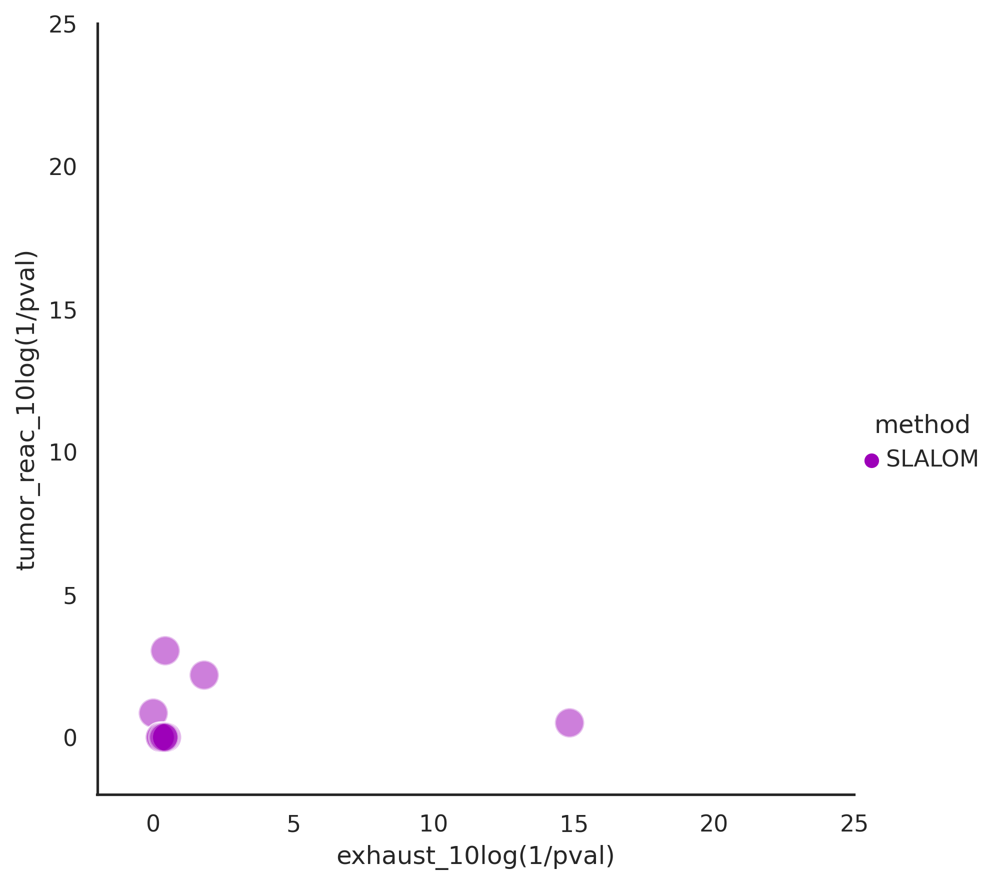

In [202]:
import seaborn as sns
sns.set_theme(style="white")
save_name = 'Bassez_tumorreac_exhaustion_GSEA_factors_SLALOM.svg'

sns.relplot(x="exhaust_10log(1/pval)", y="tumor_reac_10log(1/pval)", hue="method", s=200,
            alpha=0.5,palette=['#9d00b9'],
            height=6, data=enr_df_factor_plot_merge[enr_df_factor_plot_merge['method']=='SLALOM'])
plt.xlim(-2,25)
plt.ylim(-2,25)
plt.savefig(figure_save_path + save_name)

In [203]:
print(figure_save_path + save_name)

/data/peer/wallet/Jupyter/SPADE_Peer_validation/figures/Bassez_tumorreac_exhaustion_GSEA_factors_SLALOM.svg


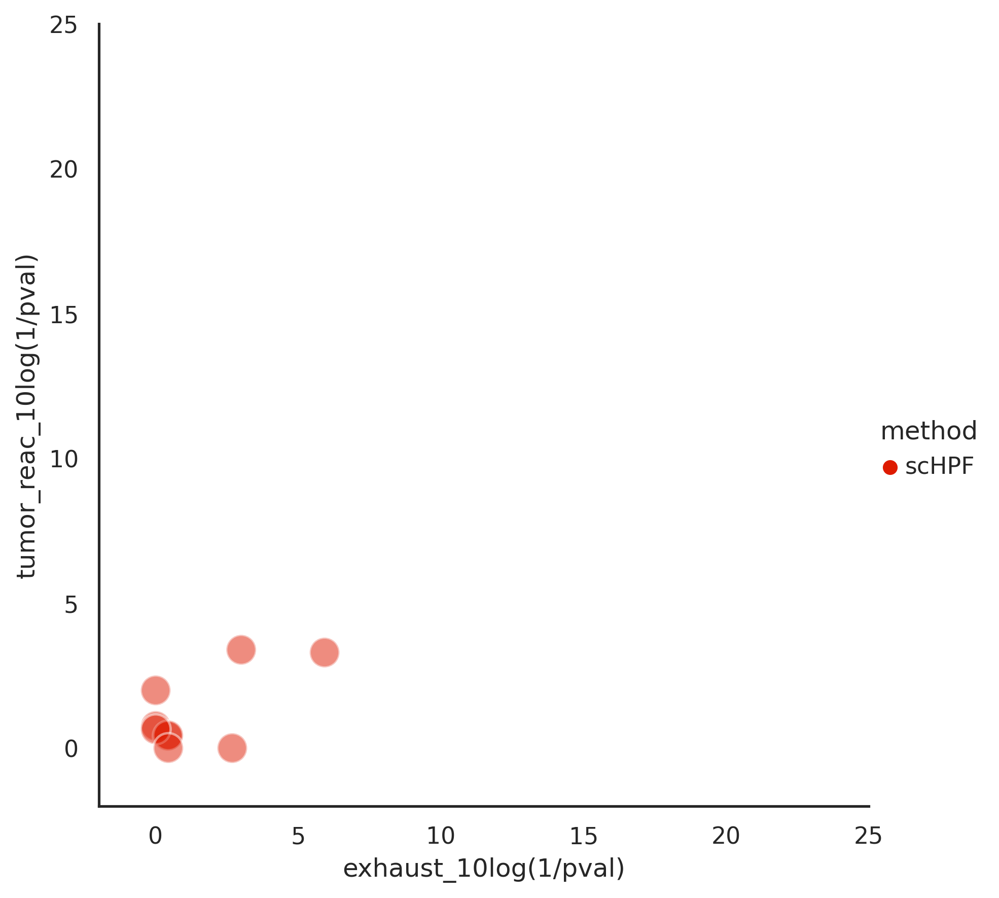

In [204]:
import seaborn as sns
sns.set_theme(style="white")
save_name = 'Bassez_tumorreac_exhaustion_GSEA_factors_scHPF.svg'

# Plot miles per gallon against horsepower with other semantics
sns.relplot(x="exhaust_10log(1/pval)", y="tumor_reac_10log(1/pval)", hue="method", s=200,
            alpha=.5,palette=['#de1b00'],
            height=6, data=enr_df_factor_plot_merge[enr_df_factor_plot_merge['method']=='scHPF'])
plt.xlim(-2,25)
plt.ylim(-2,25)
plt.savefig(figure_save_path + save_name)

In [205]:
print(figure_save_path + save_name)

/data/peer/wallet/Jupyter/SPADE_Peer_validation/figures/Bassez_tumorreac_exhaustion_GSEA_factors_scHPF.svg


In [206]:
enr_df_factor_plot_merge[enr_df_factor_plot_merge['method']=='SPECTRA'].sort_values('CD8-T_terminal-exhaustion')

,CD8-T_terminal-exhaustion,CD8-T_terminal-exhaustion_p,CD8-T_tumor-reactive-like_UP_p,CD8-T_tumor-reactive-like_UP,method,tumor_reac_10log(1/pval),exhaust_10log(1/pval)
75-X-all_actin-cytoskeleton_regulation,1.000000,1.000000e+00,9.131642e-02,22.778966,SPECTRA,1.039451,0.000000
195-X-195,1.000000,1.000000e+00,4.207340e-01,22.778966,SPECTRA,0.375992,0.000000
155-X-B_effector-1_UP,1.000000,1.000000e+00,1.754412e-01,22.778966,SPECTRA,0.755868,0.000000
102-X-all_G1S-transition,1.000000,1.000000e+00,1.423514e-01,22.778966,SPECTRA,0.846638,0.000000
64-X-all_nucleotide_metabolism,1.000000,1.000000e+00,1.555761e-01,22.778966,SPECTRA,0.808057,0.000000
179-X-DC_LPS_response,1.000000,1.000000e+00,3.547811e-01,22.778966,SPECTRA,0.450040,0.000000
126-X-all_autophagy-chaperone-mediated,1.000000,1.000000e+00,1.429300e-01,22.778966,SPECTRA,0.844876,0.000000
11-X-all_autophagy_regulation_positive,1.000000,1.000000e+00,2.232179e-01,22.778966,SPECTRA,0.651271,0.000000
27-X-all_G2M-transition,1.000000,1.000000e+00,2.296761e-01,22.778966,SPECTRA,0.638884,0.000000
188-X-188,14.331089,4.681327e-01,1.000000e+00,1.000000,SPECTRA,0.000000,0.329631


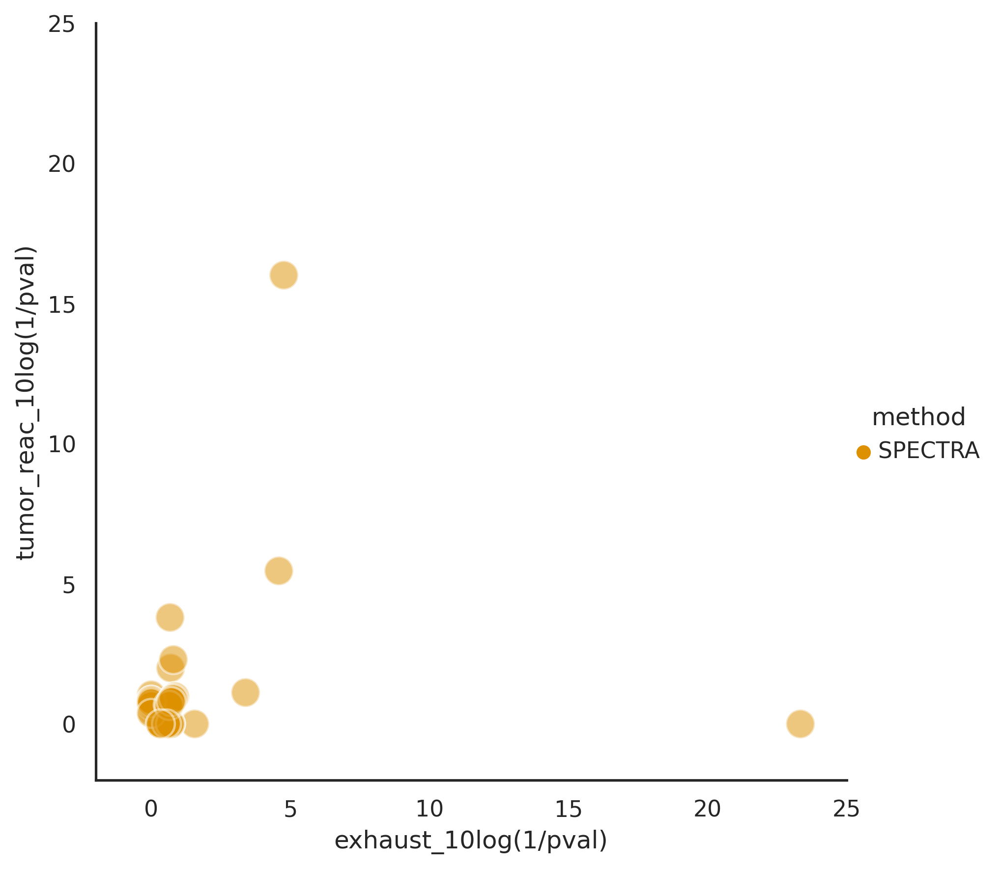

In [207]:
import seaborn as sns
sns.set_theme(style="white")
save_name = 'Bassez_tumorreac_exhaustion_GSEA_factors_SPECTRA.svg'

# Plot miles per gallon against horsepower with other semantics
sns.relplot(x="exhaust_10log(1/pval)", y="tumor_reac_10log(1/pval)", hue="method", s=200,
            alpha=0.5,palette=['#de9100'],
            height=6, data=enr_df_factor_plot_merge[enr_df_factor_plot_merge['method']=='SPECTRA'])
plt.xlim(-2,25)
plt.ylim(-2,25)
plt.savefig(figure_save_path + save_name)

In [208]:
print(figure_save_path + save_name)

/data/peer/wallet/Jupyter/SPADE_Peer_validation/figures/Bassez_tumorreac_exhaustion_GSEA_factors_SPECTRA.svg


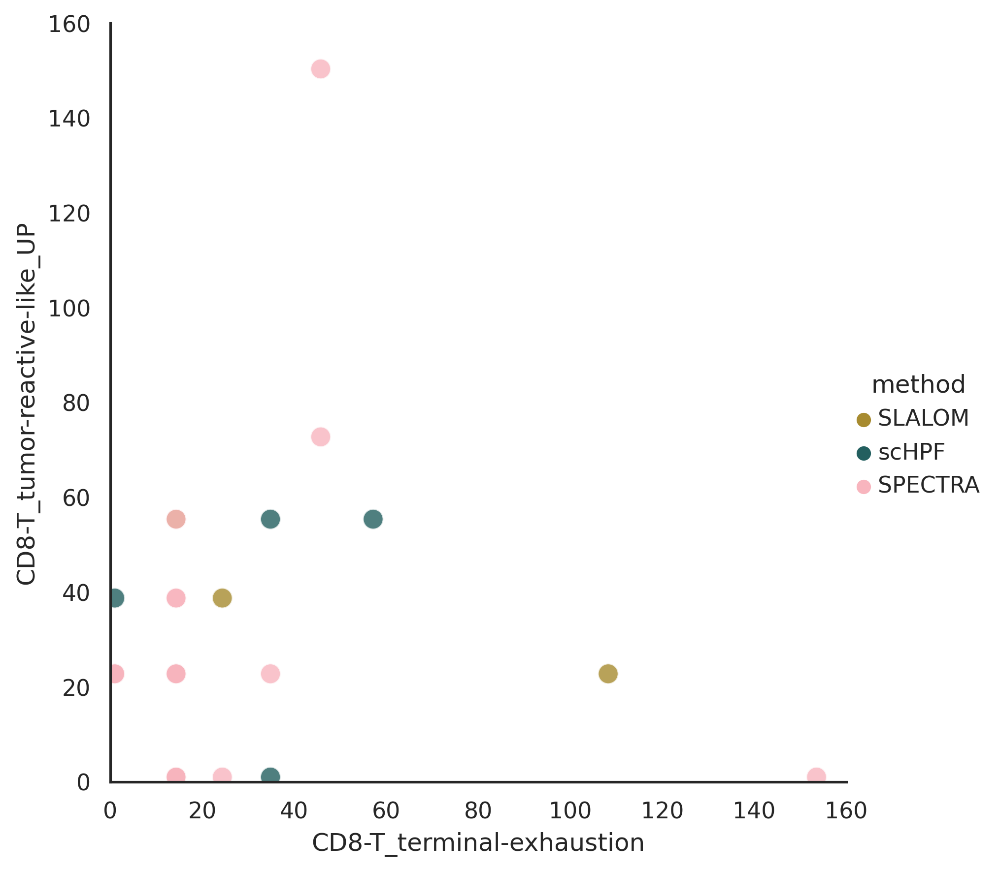

In [209]:
import seaborn as sns
sns.set_theme(style="white")
save_name = 'Bassez_tumorreac_exhaustion_GSEA_factors.svg'

# Plot miles per gallon against horsepower with other semantics
sns.relplot(x="CD8-T_terminal-exhaustion", y="CD8-T_tumor-reactive-like_UP", hue="method",
            s=100, alpha=.8, palette=batlow_20[0:3],
            height=6, data=enr_df_factor_plot_merge)
plt.xlim(0,160)
plt.ylim(0,160)
plt.savefig(figure_save_path + save_name)

In [210]:
enr_df_factor_plot_merge[enr_df_factor_plot_merge['method']=='scHPF']

,CD8-T_terminal-exhaustion,CD8-T_terminal-exhaustion_p,CD8-T_tumor-reactive-like_UP_p,CD8-T_tumor-reactive-like_UP,method,tumor_reac_10log(1/pval),exhaust_10log(1/pval)
scHPF_13,1.000000,1.000000,0.172487,22.778966,scHPF,0.763245,0.000000
scHPF_57,14.331089,0.381838,0.381838,22.778966,scHPF,0.418121,0.418121
scHPF_12,1.000000,1.000000,0.010169,38.747726,scHPF,1.992736,0.000000
scHPF_17,57.166870,0.000001,0.000502,55.388854,scHPF,3.299375,5.922018
scHPF_89,34.847173,0.001004,0.000404,55.388854,scHPF,3.393645,2.998480
scHPF_90,34.847173,0.002068,1.000000,1.000000,scHPF,0.000000,2.684485
scHPF_34,14.331089,0.361931,0.361931,22.778966,scHPF,0.441374,0.441374
scHPF_36,1.000000,1.000000,0.225247,22.778966,scHPF,0.647341,0.000000
scHPF_66,14.331089,0.360596,1.000000,1.000000,scHPF,0.000000,0.442980


In [211]:
## compare overlaps in scatter plots 

#subset to gene sets of interest
overlap_df_SLALOM_sub = overlap_df_SLALOM[['CD8-T_terminal-exhaustion','CD8-T_tumor-reactive-like_UP']]
overlap_df_SLALOM_sub['method'] = len(overlap_df_SLALOM_sub)*['SLALOM']
overlap_df_scHPF_sub = overlap_df_scHPF[['CD8-T_terminal-exhaustion','CD8-T_tumor-reactive-like_UP']]
overlap_df_scHPF_sub['method'] = len(overlap_df_scHPF_sub)*['scHPF']
overlap_df_SPECTRA_sub = overlap_df_SPECTRA[['CD8-T_terminal-exhaustion','CD8-T_tumor-reactive-like_UP']]
overlap_df_SPECTRA_sub['method'] = len(overlap_df_SPECTRA_sub)*['SPECTRA']

#concatenate dfs
combined_df  = pd.concat([overlap_df_SLALOM_sub,overlap_df_scHPF_sub,overlap_df_SPECTRA_sub])

/scratch/lsftmp/12897336.tmpdir/ipykernel_120660/2459671691.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  overlap_df_SLALOM_sub['method'] = len(overlap_df_SLALOM_sub)*['SLALOM']
/scratch/lsftmp/12897336.tmpdir/ipykernel_120660/2459671691.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  overlap_df_scHPF_sub['method'] = len(overlap_df_scHPF_sub)*['scHPF']
/scratch/lsftmp/12897336.tmpdir/ipykernel_120660/2459671691.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a 

## Lysine metabolism GSEA

In [138]:
#prepare data for plotting (SPECTRA)
factors_of_interest = ['all_LYS_metabolism']
enr_df_factor_sub = enr_df_SPECTRA[enr_df_SPECTRA['Term'].isin(factors_of_interest)]#[['Odds Ratio','Adjusted P-value']]

enr_df_factor_plot = pd.DataFrame()

for i in set(enr_df_factor_sub['factor']):
    enr_df_factor_sub_fac = enr_df_factor_sub[enr_df_factor_sub['factor']==i].set_index('Term')
    if 'all_LYS_metabolism' not in enr_df_factor_sub_fac.index:
            enr_df_factor_plot.loc[i,'all_LYS_metabolism_p'] = 1
            enr_df_factor_plot.loc[i,'all_LYS_metabolism'] = 1
    elif 'all_LYS_metabolism'in enr_df_factor_sub_fac.index:
            enr_df_factor_plot.loc[i,'all_LYS_metabolism_p'] = enr_df_factor_sub_fac.loc['all_LYS_metabolism','Adjusted P-value']
            enr_df_factor_plot.loc[i,'all_LYS_metabolism'] = enr_df_factor_sub_fac.loc['all_LYS_metabolism','Odds Ratio']
    else:
        print('skipping',i)

enr_df_factor_plot_SPECTRA = enr_df_factor_plot

In [139]:
enr_df_factor_plot_SPECTRA

,all_LYS_metabolism_p,all_LYS_metabolism
61-X-all_fatty-acid-metabolism,3.071089e-01,11.719927
36-X-36,2.885010e-01,11.719927
191-X-191,4.681327e-01,11.719927
188-X-188,4.681327e-01,11.719927
152-X-152,4.681327e-01,11.719927
95-X-all_TRP_metabolism,3.506642e-05,37.428152
158-X-158,4.681327e-01,11.719927
13-X-all_TYR_metabolism,1.900172e-01,11.719927
41-X-all_ROS-detoxification,2.529440e-01,11.719927
38-X-all_CYS_metabolism,2.716733e-01,11.719927


In [140]:
#prepare data for plotting (scHPF)
factors_of_interest = ['all_LYS_metabolism']
enr_df_factor_sub = enr_df_scHPF[enr_df_scHPF['Term'].isin(factors_of_interest)]#[['Odds Ratio','Adjusted P-value']]

enr_df_factor_plot = pd.DataFrame()

for i in set(enr_df_factor_sub['factor']):
    enr_df_factor_sub_fac = enr_df_factor_sub[enr_df_factor_sub['factor']==i].set_index('Term')
    if 'all_LYS_metabolism' not in enr_df_factor_sub_fac.index:
            enr_df_factor_plot.loc[i,'all_LYS_metabolism_p'] = 1
            enr_df_factor_plot.loc[i,'all_LYS_metabolism'] = 1
    elif 'all_LYS_metabolism'in enr_df_factor_sub_fac.index:
            enr_df_factor_plot.loc[i,'all_LYS_metabolism_p'] = enr_df_factor_sub_fac.loc['all_LYS_metabolism','Adjusted P-value']
            enr_df_factor_plot.loc[i,'all_LYS_metabolism'] = enr_df_factor_sub_fac.loc['all_LYS_metabolism','Odds Ratio']
    else:
        print('skipping',i)

enr_df_factor_plot_scHPF = enr_df_factor_plot

In [141]:
#prepare data for plotting (SLALOM)
factors_of_interest = ['all_LYS_metabolism']
enr_df_factor_sub = enr_df_SLALOM[enr_df_SLALOM['Term'].isin(factors_of_interest)]#[['Odds Ratio','Adjusted P-value']]

enr_df_factor_plot = pd.DataFrame()

for i in set(enr_df_factor_sub['factor']):
    enr_df_factor_sub_fac = enr_df_factor_sub[enr_df_factor_sub['factor']==i].set_index('Term')
    if 'all_LYS_metabolism' not in enr_df_factor_sub_fac.index:
            enr_df_factor_plot.loc[i,'all_LYS_metabolism_p'] = 1
            enr_df_factor_plot.loc[i,'all_LYS_metabolism'] = 1
    elif 'all_LYS_metabolism'in enr_df_factor_sub_fac.index:
            enr_df_factor_plot.loc[i,'all_LYS_metabolism_p'] = enr_df_factor_sub_fac.loc['all_LYS_metabolism','Adjusted P-value']
            enr_df_factor_plot.loc[i,'all_LYS_metabolism'] = enr_df_factor_sub_fac.loc['all_LYS_metabolism','Odds Ratio']
    else:
        print('skipping',i)

enr_df_factor_plot_SLALOM = enr_df_factor_plot

In [142]:
#merge for plotting
enr_df_factor_plot_scHPF['method'] = len(enr_df_factor_plot_scHPF)*['scHPF']
enr_df_factor_plot_SPECTRA['method'] = len(enr_df_factor_plot_SPECTRA)*['SPECTRA']
enr_df_factor_plot_SLALOM['method'] = len(enr_df_factor_plot_SLALOM)*['SLALOM']

enr_df_factor_plot_merge = pd.concat([enr_df_factor_plot_SLALOM,enr_df_factor_plot_scHPF, enr_df_factor_plot_SPECTRA])
enr_df_factor_plot_merge['all_LYS_metabolism_10log(1/pval)'] = enr_df_factor_plot_merge['all_LYS_metabolism_p'].apply(lambda x: math.log(1/x, 10))
enr_df_factor_plot_merge

,all_LYS_metabolism_p,all_LYS_metabolism,method,all_LYS_metabolism_10log(1/pval)
SLALOM_1,4.564294e-01,11.719927,SLALOM,0.340626
SLALOM_7,4.681327e-01,11.719927,SLALOM,0.329631
SLALOM_12,5.610644e-01,11.719927,SLALOM,0.250987
SLALOM_19,3.374823e-01,11.719927,SLALOM,0.471749
SLALOM_15,1.832878e-01,11.719927,SLALOM,0.736866
SLALOM_2,4.187849e-01,11.719927,SLALOM,0.378009
SLALOM_9,2.459768e-03,28.497927,SLALOM,2.609106
scHPF_64,4.593509e-01,11.719927,scHPF,0.337855
scHPF_74,2.952970e-01,11.719927,scHPF,0.529741
scHPF_83,2.952970e-01,11.719927,scHPF,0.529741


In [143]:
enr_df_factor_plot_merge[enr_df_factor_plot_merge['all_LYS_metabolism_p']<0.05]

,all_LYS_metabolism_p,all_LYS_metabolism,method,all_LYS_metabolism_10log(1/pval)
SLALOM_9,2.459768e-03,28.497927,SLALOM,2.609106
95-X-all_TRP_metabolism,3.506642e-05,37.428152,SPECTRA,4.455109
74-X-all_HIS_metabolism,1.224857e-10,66.682341,SPECTRA,9.911915
90-X-all_DNA-methylation,3.349918e-02,19.935958,SPECTRA,1.474966
103-X-all_LYS_metabolism,1.189868e-24,139.232727,SPECTRA,23.924501
28-X-28,6.601976e-04,28.497927,SPECTRA,3.180326
39-X-all_glycerin-SER-THR_metabolism,2.342637e-03,28.497927,SPECTRA,2.630295
97-X-all_ARG-PRO_metabolism,2.244251e-05,37.428152,SPECTRA,4.648929
3-X-all_glyoxylate-dicarboxylate_metabolism,3.684910e-02,19.935958,SPECTRA,1.433573


In [144]:
enr_df_factor_plot_merge[enr_df_factor_plot_merge['method']=='SPECTRA']

,all_LYS_metabolism_p,all_LYS_metabolism,method,all_LYS_metabolism_10log(1/pval)
61-X-all_fatty-acid-metabolism,3.071089e-01,11.719927,SPECTRA,0.512708
36-X-36,2.885010e-01,11.719927,SPECTRA,0.539853
191-X-191,4.681327e-01,11.719927,SPECTRA,0.329631
188-X-188,4.681327e-01,11.719927,SPECTRA,0.329631
152-X-152,4.681327e-01,11.719927,SPECTRA,0.329631
95-X-all_TRP_metabolism,3.506642e-05,37.428152,SPECTRA,4.455109
158-X-158,4.681327e-01,11.719927,SPECTRA,0.329631
13-X-all_TYR_metabolism,1.900172e-01,11.719927,SPECTRA,0.721207
41-X-all_ROS-detoxification,2.529440e-01,11.719927,SPECTRA,0.596976
38-X-all_CYS_metabolism,2.716733e-01,11.719927,SPECTRA,0.565953


In [145]:
math.log(1/0.05,10)

1.301029995663981

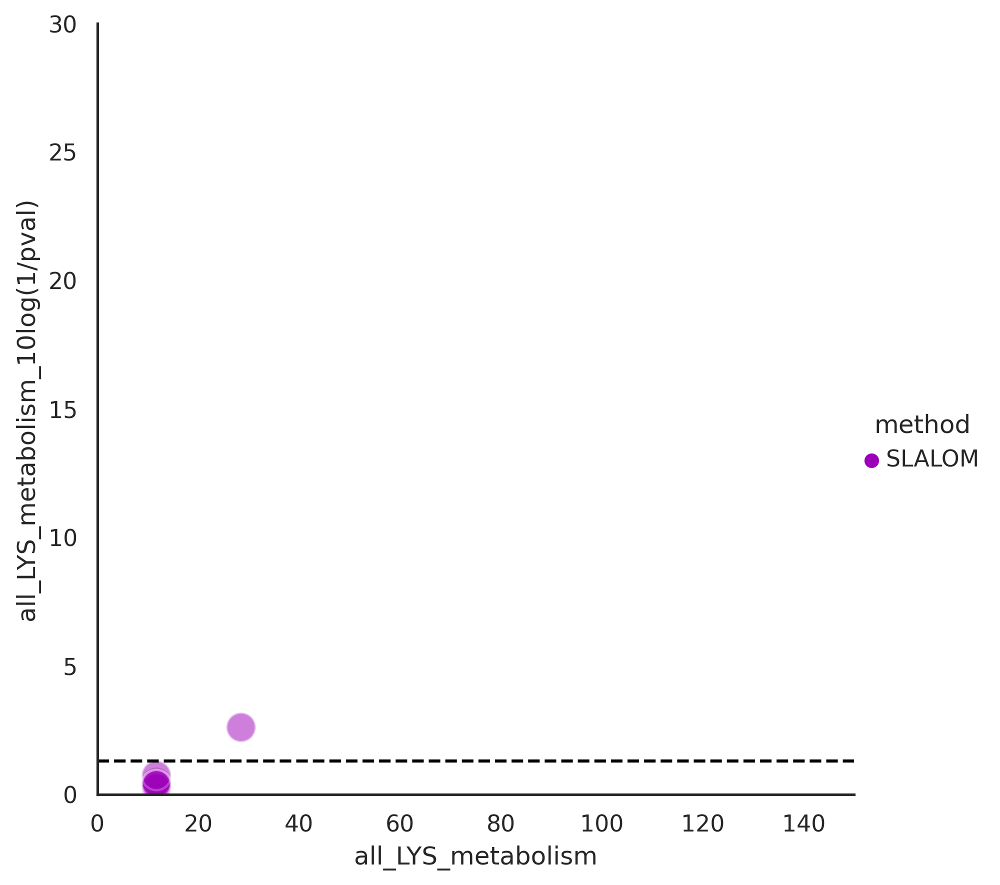

In [155]:
import seaborn as sns
sns.set_theme(style="white")
save_name = 'Bassez_LYS_GSEA_factors_SLALOM.svg'

# Plot miles per gallon against horsepower with other semantics
sns.relplot(x="all_LYS_metabolism", y="all_LYS_metabolism_10log(1/pval)", hue="method", s=200,
            alpha=0.5,palette=['#9d00b9'],
            height=6, data=enr_df_factor_plot_merge[enr_df_factor_plot_merge['method']=='SLALOM'])
plt.xlim(0,150)
plt.ylim(0,30)
plt.axhline(math.log(1/0.05,10),color='#000000',linestyle='--')
plt.savefig(figure_save_path + save_name)

In [156]:
enr_df_factor_plot_merge[enr_df_factor_plot_merge['method']=='scHPF']

,all_LYS_metabolism_p,all_LYS_metabolism,method,all_LYS_metabolism_10log(1/pval)
scHPF_64,0.459351,11.719927,scHPF,0.337855
scHPF_74,0.295297,11.719927,scHPF,0.529741
scHPF_83,0.295297,11.719927,scHPF,0.529741
scHPF_49,0.281668,11.719927,scHPF,0.550263
scHPF_40,0.201497,11.719927,scHPF,0.695732
scHPF_90,0.344858,11.719927,scHPF,0.462360
scHPF_75,0.314983,11.719927,scHPF,0.501712
scHPF_27,0.057619,19.935958,scHPF,1.239437


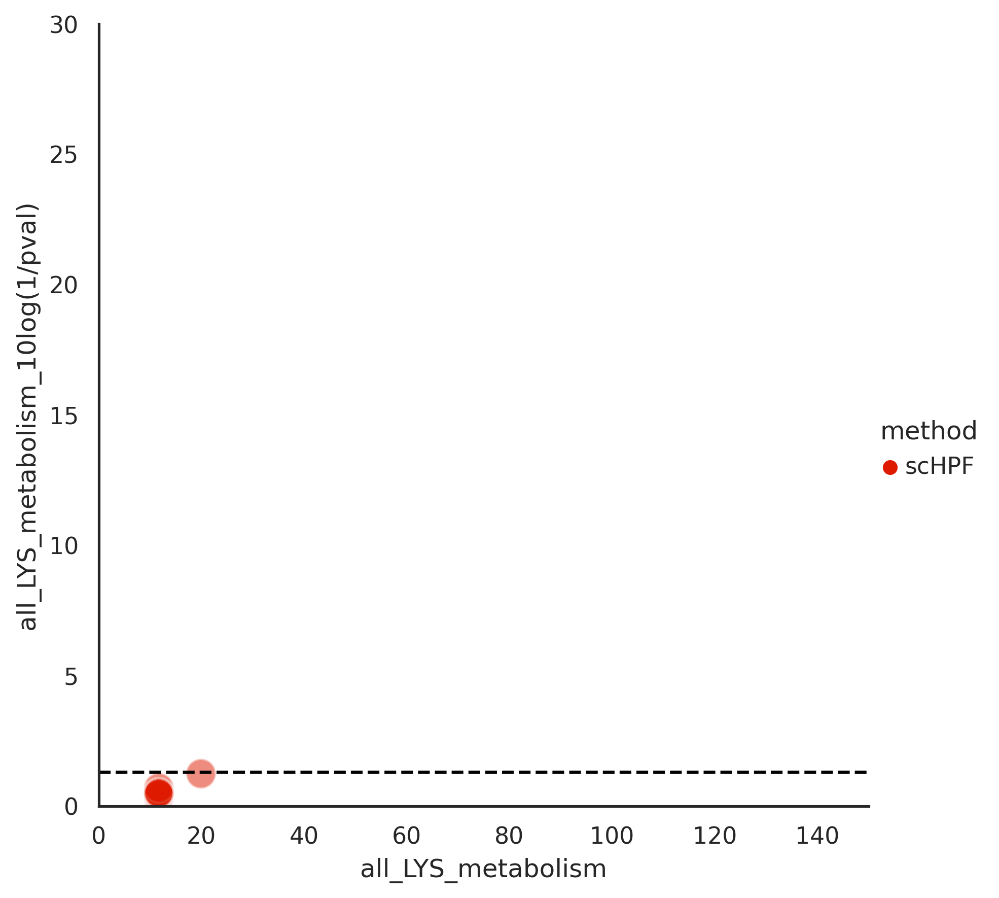

In [158]:
import seaborn as sns
sns.set_theme(style="white")
save_name = 'Bassez_LYS_GSEA_factors_scHPF.svg'

# Plot miles per gallon against horsepower with other semantics
sns.relplot(x="all_LYS_metabolism", y="all_LYS_metabolism_10log(1/pval)", hue="method", s=200,
            alpha=0.5,palette=['#de1b00'],
            height=6, data=enr_df_factor_plot_merge[enr_df_factor_plot_merge['method']=='scHPF'])
plt.xlim(0,150)
plt.ylim(0,30)
plt.axhline(math.log(1/0.05,10),color='#000000',linestyle='--')
plt.savefig(figure_save_path + save_name)

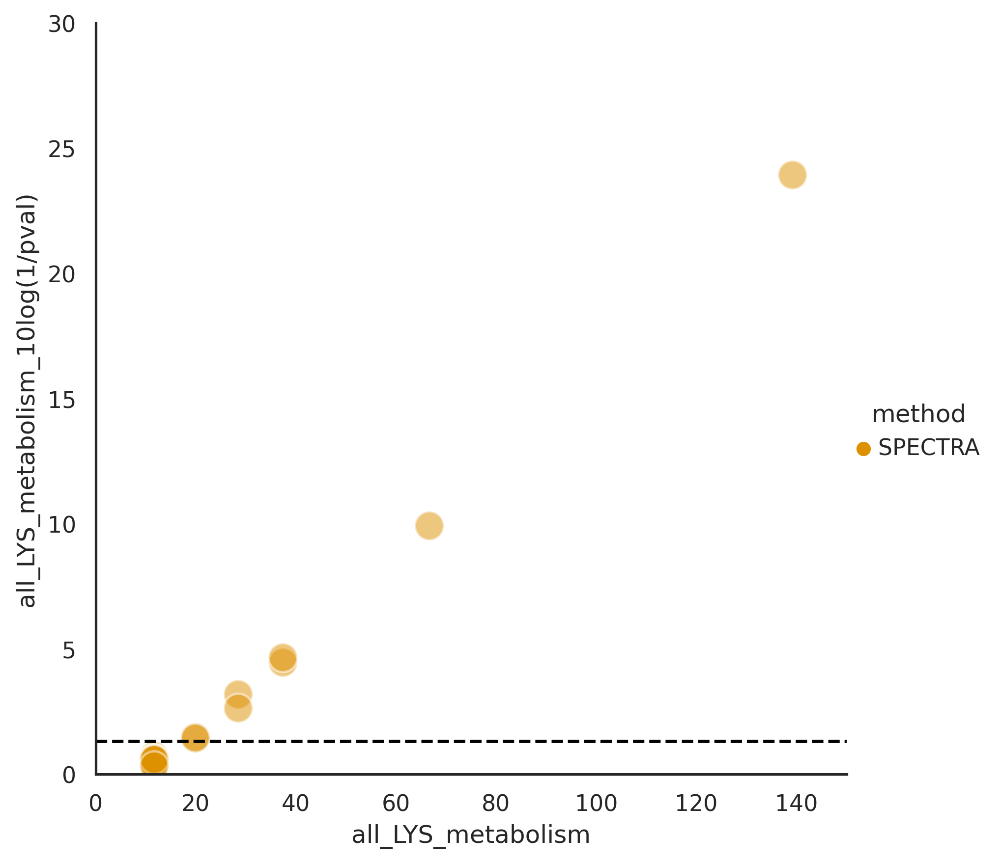

In [159]:
import seaborn as sns
sns.set_theme(style="white")
save_name = 'Bassez_LYS_GSEA_factors_SPECTRA.svg'

# Plot miles per gallon against horsepower with other semantics
sns.relplot(x="all_LYS_metabolism", y="all_LYS_metabolism_10log(1/pval)", hue="method", s=200,
            alpha=0.5,palette=['#de9100'],
            height=6, data=enr_df_factor_plot_merge[enr_df_factor_plot_merge['method']=='SPECTRA'])
plt.xlim(0,150)
plt.ylim(0,30)
plt.axhline(math.log(1/0.05,10),color='#000000',linestyle='--')
plt.savefig(figure_save_path + save_name)

In [160]:
figure_save_path + save_name

'/data/peer/wallet/Jupyter/SPADE_Peer_validation/figures/Bassez_LYS_GSEA_factors_SPECTRA.svg'

# compare overlap coef for SLALOM and SPECTRA only using gene sets used for SLALOM

In [83]:
#gene sets used for SLALOM
gene_sets_SLALOM = ['CD8-T_tumor-reactive-like_UP',
'all_type-II-ifn-response',
'M_angiogenic-effectors',
'all_posttranslation-modification',
'all_MHC-I-presentation',
'all_G2M-transition',
'all_oxidative-phosphorylation',
'all_type-I-ifn-response',
'Mac_IL4-IL13_response',
'all_glycolysis',
'all_DNA_synthesis',
'all_G1S-transition',
'all_LYS_metabolism',
'all_MHC-II-presentation',
'all_hypoxia-response',
'all_pentose-phosphate-pathway',
'CD8-T_terminal-exhaustion',
                   'TNK_PD-1_signaling',
'T_tcr-activation',
'TNK_cytotoxicity-effectors']

In [84]:
#retrieve specific SPECTRA factors and a flat dictionary (non hierarchical for spec factors)

spec_fac = []
flat_dict = {}

for i in list(adata_SPECTRA.uns['SPADE_markers_specific'].keys()):
    cell_type_spec_fac = list(adata_SPECTRA.uns['SPADE_markers_specific'][i].keys())
    spec_fac = spec_fac + cell_type_spec_fac
    for j in cell_type_spec_fac:
        flat_dict[j] = adata_SPECTRA.uns['SPADE_markers_specific'][i][j]
spec_fac

['152-X-152',
 '153-X-B_Breg_UP',
 '154-X-B_effector-2_UP',
 '155-X-B_effector-1_UP',
 '156-X-B_IgM-ligation_response',
 '157-X-157',
 '158-X-158',
 '159-X-CD4-T_IL12_response',
 '160-X-TNK_IL2_response',
 '161-X-CD4-T_TH22_UP',
 '162-X-CD4-T_TH17_UP',
 '163-X-TNK_IL2-STAT5-signaling',
 '164-X-T_IL21_response',
 '165-X-CD4-T_TH9_UP',
 '166-X-CD4-T_TFH_UP',
 '167-X-CD4-T_IL4_response',
 '168-X-CD4-T_TH2_UP',
 '169-X-CD4-T_TH1_UP',
 '170-X-170',
 '171-X-CD8-T_tumor-reactive-like_UP',
 '172-X-CD8-T_terminal-exhaustion',
 '173-X-T_tcr-activation',
 '174-X-CD8-T_IL12_response',
 '175-X-TNK_PD-1_signaling',
 '176-X-TNK_cytotoxicity-effectors',
 '177-X-177',
 '178-X-178',
 '179-X-DC_LPS_response',
 '180-X-180',
 '181-X-181',
 '182-X-M_angiogenic-effectors',
 '183-X-Mac_LPS_response',
 '184-X-Mac_IL4-IL13_response',
 '185-X-Mac_CSF1_response',
 '186-X-Mac_IFNG_response',
 '187-X-187',
 '188-X-188',
 '189-X-Treg_FoxP3-stabilization',
 '190-X-190',
 '191-X-191',
 '192-X-mast_granule-exocytosis',

In [85]:
#retrieve spectra factors based on the gene sets used for SLALOM
all_SPECTRA_factors = list(adata_SPECTRA.uns['SPADE_markers_global'].keys()) + spec_fac
SPECTRA_fac_names  = [x for x in all_SPECTRA_factors if x.split('-X-')[1] in gene_sets_SLALOM]
SPECTRA_fac_names

['10-X-all_type-II-ifn-response',
 '101-X-all_DNA_synthesis',
 '102-X-all_G1S-transition',
 '103-X-all_LYS_metabolism',
 '127-X-all_MHC-II-presentation',
 '129-X-all_hypoxia-response',
 '140-X-all_pentose-phosphate-pathway',
 '22-X-all_posttranslation-modification',
 '25-X-all_MHC-I-presentation',
 '27-X-all_G2M-transition',
 '31-X-all_oxidative-phosphorylation',
 '46-X-all_oxidative-phosphorylation',
 '55-X-all_type-I-ifn-response',
 '94-X-all_glycolysis',
 '171-X-CD8-T_tumor-reactive-like_UP',
 '172-X-CD8-T_terminal-exhaustion',
 '173-X-T_tcr-activation',
 '175-X-TNK_PD-1_signaling',
 '176-X-TNK_cytotoxicity-effectors',
 '182-X-M_angiogenic-effectors',
 '184-X-Mac_IL4-IL13_response']

In [86]:
#calculate overlap coefficients for each factor vs every input gene set

overlap_df_SPECTRA_focussed = pd.DataFrame()

for i in list(SPECTRA_fac_names):
    for j in gene_sets_SLALOM:
        set_a = set(input_df[input_df['gs.name']==j]['g.name'])
        if i in list(adata_SPECTRA.uns['SPADE_markers_global'].keys()):
            set_b = set(adata_SPECTRA.uns['SPADE_markers_global'][i])
        else:
            set_b = set(flat_dict[i])
        min_len = min([len(set_a),len(set_b)])
        intersect = set_a.intersection(set_b)
        overlap_coeff = len(intersect)/min_len
        overlap_df_SPECTRA_focussed.loc[i,j] = overlap_coeff
overlap_df_SPECTRA_focussed

,CD8-T_tumor-reactive-like_UP,all_type-II-ifn-response,M_angiogenic-effectors,all_posttranslation-modification,all_MHC-I-presentation,all_G2M-transition,all_oxidative-phosphorylation,all_type-I-ifn-response,Mac_IL4-IL13_response,all_glycolysis,all_DNA_synthesis,all_G1S-transition,all_LYS_metabolism,all_MHC-II-presentation,all_hypoxia-response,all_pentose-phosphate-pathway,CD8-T_terminal-exhaustion,TNK_PD-1_signaling,T_tcr-activation,TNK_cytotoxicity-effectors
10-X-all_type-II-ifn-response,0.125,0.882353,0.032258,0.000000,0.3,0.00,0.00,0.058824,0.055556,0.000000,0.0,0.0,0.000000,0.317073,0.02,0.0,0.076923,0.04,0.04,0.000000
101-X-all_DNA_synthesis,0.000,0.000000,0.000000,0.000000,0.0,0.22,0.02,0.235294,0.000000,0.000000,1.0,0.0,0.055556,0.073171,0.02,0.0,0.000000,0.00,0.02,0.000000
102-X-all_G1S-transition,0.125,0.000000,0.000000,0.000000,0.0,0.04,0.00,0.000000,0.000000,0.000000,0.0,1.0,0.000000,0.000000,0.00,0.0,0.000000,0.00,0.00,0.000000
103-X-all_LYS_metabolism,0.000,0.000000,0.000000,0.000000,0.0,0.00,0.00,0.000000,0.000000,0.000000,0.0,0.0,0.722222,0.000000,0.02,0.0,0.000000,0.00,0.02,0.000000
127-X-all_MHC-II-presentation,0.000,0.235294,0.000000,0.000000,0.0,0.00,0.06,0.000000,0.000000,0.000000,0.0,0.0,0.000000,0.731707,0.04,0.0,0.000000,0.00,0.02,0.000000
129-X-all_hypoxia-response,0.000,0.000000,0.000000,0.000000,0.0,0.00,0.00,0.000000,0.000000,0.000000,0.0,0.0,0.000000,0.000000,1.00,0.0,0.000000,0.00,0.00,0.000000
140-X-all_pentose-phosphate-pathway,0.000,0.000000,0.000000,0.000000,0.0,0.00,0.06,0.117647,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.08,0.9,0.000000,0.04,0.00,0.000000
22-X-all_posttranslation-modification,0.000,0.000000,0.000000,0.818182,0.0,0.00,0.00,0.000000,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.10,0.0,0.000000,0.00,0.00,0.000000
25-X-all_MHC-I-presentation,0.000,0.058824,0.000000,0.000000,1.0,0.00,0.06,0.058824,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.00,0.0,0.000000,0.00,0.00,0.000000
27-X-all_G2M-transition,0.125,0.000000,0.000000,0.000000,0.0,0.44,0.00,0.000000,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.04,0.0,0.000000,0.00,0.02,0.000000


In [87]:
#max overlap 

max_overlap_SPECTRA_foc = np.max(overlap_df_SPECTRA_focussed,axis=1)
max_overlap_SPECTRA_foc

10-X-all_type-II-ifn-response            0.882353
101-X-all_DNA_synthesis                  1.000000
102-X-all_G1S-transition                 1.000000
103-X-all_LYS_metabolism                 0.722222
127-X-all_MHC-II-presentation            0.731707
129-X-all_hypoxia-response               1.000000
140-X-all_pentose-phosphate-pathway      0.900000
22-X-all_posttranslation-modification    0.818182
25-X-all_MHC-I-presentation              1.000000
27-X-all_G2M-transition                  0.440000
31-X-all_oxidative-phosphorylation       1.000000
46-X-all_oxidative-phosphorylation       1.000000
55-X-all_type-I-ifn-response             1.000000
94-X-all_glycolysis                      0.814815
171-X-CD8-T_tumor-reactive-like_UP       1.000000
172-X-CD8-T_terminal-exhaustion          0.923077
173-X-T_tcr-activation                   1.000000
175-X-TNK_PD-1_signaling                 1.000000
176-X-TNK_cytotoxicity-effectors         1.000000
182-X-M_angiogenic-effectors             0.967742


In [88]:
#calculate overlap coefficients for each factor vs every input gene set

overlap_df_SLALOM = pd.DataFrame()

for i in ['SLALOM_' + str(x) for x in range(20)]:
    for j in gene_sets_SLALOM:
        set_a = set(input_df[input_df['gs.name']==j]['g.name'])
        set_b = set(adata_SLALOM.uns['SLALOM_markers_global'][i])
        min_len = min([len(set_a),len(set_b)])
        intersect = set_a.intersection(set_b)
        overlap_coeff = len(intersect)/min_len
        overlap_df_SLALOM.loc[i,j] = overlap_coeff
overlap_df_SLALOM

,CD8-T_tumor-reactive-like_UP,all_type-II-ifn-response,M_angiogenic-effectors,all_posttranslation-modification,all_MHC-I-presentation,all_G2M-transition,all_oxidative-phosphorylation,all_type-I-ifn-response,Mac_IL4-IL13_response,all_glycolysis,all_DNA_synthesis,all_G1S-transition,all_LYS_metabolism,all_MHC-II-presentation,all_hypoxia-response,all_pentose-phosphate-pathway,CD8-T_terminal-exhaustion,TNK_PD-1_signaling,T_tcr-activation,TNK_cytotoxicity-effectors
SLALOM_0,0.000,0.470588,0.032258,0.000000,0.0,0.00,0.00,0.000000,0.000000,0.000000,0.000000,0.00,0.000000,0.243902,0.00,0.0,0.000000,0.00,0.00,0.000000
SLALOM_1,0.000,0.000000,0.000000,0.000000,0.0,0.00,0.04,0.000000,0.000000,0.000000,0.000000,0.00,0.055556,0.000000,0.08,0.0,0.076923,0.00,0.04,0.000000
SLALOM_2,0.000,0.058824,0.000000,0.000000,0.9,0.00,0.04,0.000000,0.000000,0.000000,0.000000,0.00,0.055556,0.000000,0.08,0.0,0.076923,0.00,0.04,0.000000
SLALOM_3,0.000,0.000000,0.000000,0.000000,0.0,0.02,0.04,0.000000,0.000000,0.000000,0.000000,0.00,0.000000,0.000000,0.10,0.0,0.076923,0.00,0.02,0.000000
SLALOM_4,0.000,0.000000,0.000000,0.000000,0.0,0.00,0.60,0.000000,0.000000,0.074074,0.000000,0.00,0.000000,0.024390,0.04,0.0,0.000000,0.00,0.00,0.000000
SLALOM_5,0.000,0.058824,0.000000,0.000000,0.0,0.00,0.00,0.941176,0.000000,0.000000,0.000000,0.00,0.000000,0.000000,0.04,0.0,0.000000,0.04,0.00,0.071429
SLALOM_6,0.000,0.000000,0.032258,0.000000,0.0,0.00,0.00,0.000000,0.000000,0.037037,0.000000,0.00,0.000000,0.024390,0.06,0.0,0.000000,0.04,0.00,0.000000
SLALOM_7,0.000,0.000000,0.000000,0.000000,0.0,0.00,0.04,0.000000,0.000000,0.000000,0.000000,0.00,0.055556,0.000000,0.08,0.0,0.076923,0.00,0.04,0.000000
SLALOM_8,0.125,0.000000,0.000000,0.000000,0.0,0.08,0.00,0.000000,0.000000,0.000000,0.333333,0.75,0.000000,0.000000,0.00,0.0,0.000000,0.00,0.00,0.000000
SLALOM_9,0.000,0.000000,0.000000,0.000000,0.0,0.00,0.00,0.058824,0.000000,0.000000,0.000000,0.00,0.166667,0.000000,0.02,0.0,0.000000,0.00,0.00,0.000000


In [89]:
#max overlap 

max_overlap_SLALOM_foc = np.max(overlap_df_SLALOM,axis=1)
max_overlap_SLALOM_foc

SLALOM_0     0.470588
SLALOM_1     0.080000
SLALOM_2     0.900000
SLALOM_3     0.100000
SLALOM_4     0.600000
SLALOM_5     0.941176
SLALOM_6     0.060000
SLALOM_7     0.080000
SLALOM_8     0.750000
SLALOM_9     0.166667
SLALOM_10    0.470588
SLALOM_11    0.940000
SLALOM_12    0.900000
SLALOM_13    0.375000
SLALOM_14    0.692308
SLALOM_15    0.720000
SLALOM_16    0.600000
SLALOM_17    0.571429
SLALOM_18    0.677419
SLALOM_19    0.722222
dtype: float64

In [90]:
np.mean(max_overlap_SPECTRA_foc)

0.9142903796204424

In [91]:
np.mean(max_overlap_SLALOM_foc)

0.5408698724320167

In [92]:
SLALOM_series_foc = pd.Series(np.max(overlap_df_SLALOM,axis=1).reset_index()[0])
SLALOM_series_foc.index = ['SLALOM']*len(SLALOM_series_foc)
SLALOM_series_foc

SLALOM    0.470588
SLALOM    0.080000
SLALOM    0.900000
SLALOM    0.100000
SLALOM    0.600000
SLALOM    0.941176
SLALOM    0.060000
SLALOM    0.080000
SLALOM    0.750000
SLALOM    0.166667
SLALOM    0.470588
SLALOM    0.940000
SLALOM    0.900000
SLALOM    0.375000
SLALOM    0.692308
SLALOM    0.720000
SLALOM    0.600000
SLALOM    0.571429
SLALOM    0.677419
SLALOM    0.722222
Name: 0, dtype: float64

In [93]:
SPECTRA_series_foc = pd.Series(np.max(overlap_df_SPECTRA_focussed,axis=1).reset_index()[0])
SPECTRA_series_foc.index = ['SPECTRA']*len(SPECTRA_series_foc)
SPECTRA_series_foc

SPECTRA    0.882353
SPECTRA    1.000000
SPECTRA    1.000000
SPECTRA    0.722222
SPECTRA    0.731707
SPECTRA    1.000000
SPECTRA    0.900000
SPECTRA    0.818182
SPECTRA    1.000000
SPECTRA    0.440000
SPECTRA    1.000000
SPECTRA    1.000000
SPECTRA    1.000000
SPECTRA    0.814815
SPECTRA    1.000000
SPECTRA    0.923077
SPECTRA    1.000000
SPECTRA    1.000000
SPECTRA    1.000000
SPECTRA    0.967742
SPECTRA    1.000000
Name: 0, dtype: float64

In [94]:
plotting_df  = pd.concat([SPECTRA_series_foc,SLALOM_series_foc]).reset_index()
plotting_df

,index,0
0,SPECTRA,0.882353
1,SPECTRA,1.000000
2,SPECTRA,1.000000
3,SPECTRA,0.722222
4,SPECTRA,0.731707
5,SPECTRA,1.000000
6,SPECTRA,0.900000
7,SPECTRA,0.818182
8,SPECTRA,1.000000
9,SPECTRA,0.440000


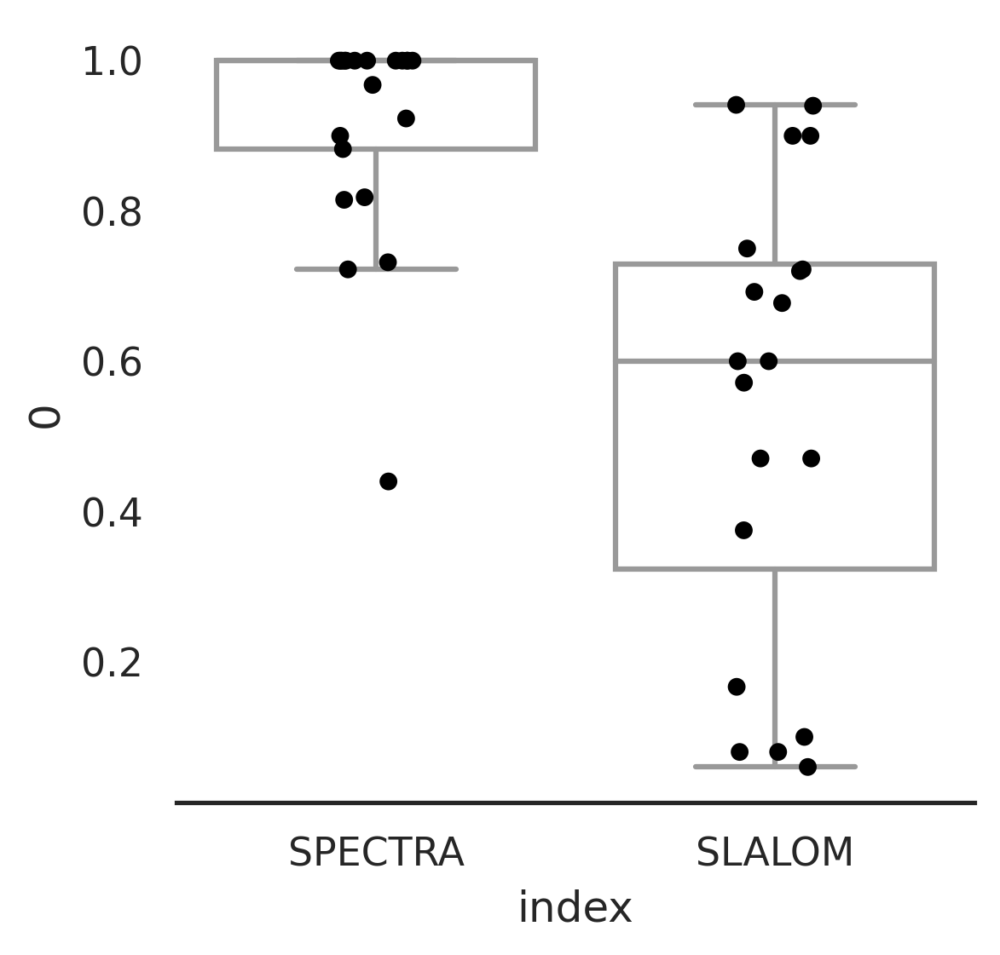

In [95]:
import seaborn as sns
save_name = 'SLALOM_SPECTRA_overlap.svg'
sns.set_theme(style="white")
plt.set_ylim = (0,1)
# Draw a nested violinplot and split the violins for easier comparison
sns.boxplot(data = plotting_df, x='index', y=0,fliersize=0,color='#FFFFFF')
sns.stripplot(data = plotting_df, x='index', y=0,color='#000000')
sns.despine(left=True)
plt.savefig(figure_save_path + save_name)

# calculate entropy of factor expression for scHPF vs SPECTRA

## calculate entropy for SPECTRA global factors

In [96]:
#get loadings of global SPECTRA factors
global_fac_names = list(adata_SPECTRA.obs.columns[adata_SPECTRA.obs.columns.isin(list(adata_SPECTRA.uns['SPADE_markers_global'].keys()))]) 

In [97]:
#retrieve specific SPECTRA factors and a flat dictionary (non hierarchical for spec factors)

spec_fac = []
flat_dict = {}

for i in list(adata_SPECTRA.uns['SPADE_markers_specific'].keys()):
    cell_type_spec_fac = list(adata_SPECTRA.uns['SPADE_markers_specific'][i].keys())
    spec_fac = spec_fac + cell_type_spec_fac
    for j in cell_type_spec_fac:
        flat_dict[j] = adata_SPECTRA.uns['SPADE_markers_specific'][i][j]
spec_fac

['152-X-152',
 '153-X-B_Breg_UP',
 '154-X-B_effector-2_UP',
 '155-X-B_effector-1_UP',
 '156-X-B_IgM-ligation_response',
 '157-X-157',
 '158-X-158',
 '159-X-CD4-T_IL12_response',
 '160-X-TNK_IL2_response',
 '161-X-CD4-T_TH22_UP',
 '162-X-CD4-T_TH17_UP',
 '163-X-TNK_IL2-STAT5-signaling',
 '164-X-T_IL21_response',
 '165-X-CD4-T_TH9_UP',
 '166-X-CD4-T_TFH_UP',
 '167-X-CD4-T_IL4_response',
 '168-X-CD4-T_TH2_UP',
 '169-X-CD4-T_TH1_UP',
 '170-X-170',
 '171-X-CD8-T_tumor-reactive-like_UP',
 '172-X-CD8-T_terminal-exhaustion',
 '173-X-T_tcr-activation',
 '174-X-CD8-T_IL12_response',
 '175-X-TNK_PD-1_signaling',
 '176-X-TNK_cytotoxicity-effectors',
 '177-X-177',
 '178-X-178',
 '179-X-DC_LPS_response',
 '180-X-180',
 '181-X-181',
 '182-X-M_angiogenic-effectors',
 '183-X-Mac_LPS_response',
 '184-X-Mac_IL4-IL13_response',
 '185-X-Mac_CSF1_response',
 '186-X-Mac_IFNG_response',
 '187-X-187',
 '188-X-188',
 '189-X-Treg_FoxP3-stabilization',
 '190-X-190',
 '191-X-191',
 '192-X-mast_granule-exocytosis',

In [98]:
#normalized factors:
norm_factors_glob_spec = [x+'-X-norm' for x in global_fac_names+spec_fac ]
norm_factors_glob_spec

['0-X-all_multidrug-resistance-X-norm',
 '1-X-all_porphyrine-heme_metabolism-X-norm',
 '2-X-all_TNF-via-NFkB_signaling-X-norm',
 '3-X-all_glyoxylate-dicarboxylate_metabolism-X-norm',
 '4-X-all_IL6-JAK-STAT3_signaling-X-norm',
 '5-X-5-X-norm',
 '6-X-all_triacylglycerol_synthesis-X-norm',
 '7-X-all_circadian-rhythm-X-norm',
 '8-X-all_heparan-sulfate_degradation-X-norm',
 '9-X-all_autophagy-of-mitochondria_regulation_positive-X-norm',
 '10-X-all_type-II-ifn-response-X-norm',
 '11-X-all_autophagy_regulation_positive-X-norm',
 '12-X-all_DNA-demethylation-X-norm',
 '13-X-all_TYR_metabolism-X-norm',
 '14-X-all_autophagy-of-mitochondria-X-norm',
 '15-X-all_autophagy-chaperone-mediated-X-norm',
 '16-X-all_transmembrane-transport-golgi-X-norm',
 '17-X-all_osmotic-stress-response-X-norm',
 '18-X-all_o-glycan_synthesis-X-norm',
 '19-X-all_transmembrane-transport-mitochondrial-X-norm',
 '20-X-all_cytosolic-DNA-sensing_signaling-X-norm',
 '21-X-all_mitophagy_regulation_positive-X-norm',
 '22-X-all_p

In [99]:
SPECTRA_global_df = adata_SPECTRA.obs[norm_factors_glob_spec+['annotation_SPADE_1']]

In [100]:
SPECTRA_global_df_mean = SPECTRA_global_df.groupby('annotation_SPADE_1').mean()
SPECTRA_global_df_mean.shape

(14, 197)

In [101]:
SPECTRA_global_df_mean

,0-X-all_multidrug-resistance-X-norm,1-X-all_porphyrine-heme_metabolism-X-norm,2-X-all_TNF-via-NFkB_signaling-X-norm,3-X-all_glyoxylate-dicarboxylate_metabolism-X-norm,4-X-all_IL6-JAK-STAT3_signaling-X-norm,5-X-5-X-norm,6-X-all_triacylglycerol_synthesis-X-norm,7-X-all_circadian-rhythm-X-norm,8-X-all_heparan-sulfate_degradation-X-norm,9-X-all_autophagy-of-mitochondria_regulation_positive-X-norm,...,187-X-187-X-norm,188-X-188-X-norm,189-X-Treg_FoxP3-stabilization-X-norm,190-X-190-X-norm,191-X-191-X-norm,192-X-mast_granule-exocytosis-X-norm,193-X-193-X-norm,194-X-p-DC_CpG-TLR9_response-X-norm,195-X-195-X-norm,196-X-196-X-norm
annotation_SPADE_1,,,,,,,,,,,,,,,,,,,,,
B_GC,0.001460,0.000705,0.004307,0.192359,0.001111,0.005421,0.000267,0.000258,0.000133,0.016675,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
B_memory,0.002740,0.000467,0.021450,0.057346,0.001243,0.002962,0.000403,0.000366,0.000419,0.013981,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
B_naive,0.001674,0.000429,0.015460,0.049460,0.001083,0.002539,0.000363,0.000322,0.000271,0.014122,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
CD4_T,0.003094,0.000723,0.018680,0.066585,0.001600,0.008233,0.000450,0.000561,0.000447,0.015231,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
CD8_T,0.002683,0.000754,0.020097,0.059912,0.001497,0.007546,0.000428,0.000468,0.000458,0.016586,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
DC,0.004669,0.000538,0.045866,0.183788,0.001864,0.005593,0.000681,0.000438,0.000415,0.013353,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
ILC3,0.003448,0.000575,0.040138,0.046170,0.001115,0.005209,0.000382,0.000782,0.000276,0.014271,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
MDC,0.003185,0.000442,0.033359,0.125964,0.001544,0.004079,0.000563,0.000379,0.000385,0.013927,...,0.202363,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
NK,0.002170,0.000736,0.030148,0.048727,0.001147,0.005762,0.000395,0.000511,0.000368,0.016137,...,0.000000,0.916954,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000


In [102]:
[2]*14

[2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]

In [103]:
#calculate max entropy
max_entrop = scipy.stats.entropy([1]*SPECTRA_global_df_mean.shape[0], base=None, axis=0)
print('max entropy is:',max_entrop)

max entropy is: 2.639057329615258


In [104]:
#calculate max entropy
two_entrop = scipy.stats.entropy([0,0,0,0,0,0,0,0,0,0,0,0,2,2], base=None, axis=0)
print('two entropy is:',two_entrop)

two entropy is: 0.6931471805599453


In [105]:
#calculate max entropy
three_entrop = scipy.stats.entropy([0,0,0,0,0,0,0,0,0,0,0,2,2,2], base=None, axis=0)
print('three entropy is:',three_entrop)

three entropy is: 1.0986122886681096


In [106]:
#calculate max entropy
four_entrop = scipy.stats.entropy([0,0,0,0,0,0,0,0,0,0,2,2,2,2], base=None, axis=0)
print('three entropy is:',four_entrop)

three entropy is: 1.3862943611198906


In [107]:
#calculate max entropy
five_entrop = scipy.stats.entropy([0,0,0,0,0,0,0,0,0,2,2,2,2,2], base=None, axis=0)
print('three entropy is:',five_entrop)

three entropy is: 1.6094379124341005


In [108]:
#calculate max entropy
six_entrop = scipy.stats.entropy([0,0,0,0,0,0,0,0,2,2,2,2,2,2], base=None, axis=0)
print('three entropy is:',six_entrop)

three entropy is: 1.7917594692280547


#normalize df
SPECTRA_global_df_mean = SPECTRA_global_df_mean/SPECTRA_global_df_mean.sum(axis = 0)
SPECTRA_global_df_mean

In [109]:
SPECTRA_global_df_entropy = pd.DataFrame(scipy.stats.entropy(SPECTRA_global_df_mean, base=None, axis=0),index=list(SPECTRA_global_df_mean.columns))
SPECTRA_global_df_entropy.sort_values(0)[40:60]

,0
177-X-177-X-norm,0.000000
181-X-181-X-norm,0.000000
180-X-180-X-norm,0.000000
178-X-178-X-norm,0.000000
179-X-DC_LPS_response-X-norm,0.000000
36-X-36-X-norm,1.148795
148-X-all_complement_production-X-norm,1.623724
143-X-all_pyroptosis-X-norm,1.712113
102-X-all_G1S-transition-X-norm,1.774074
121-X-all_thrombolysis-factor_production-X-norm,1.809789


In [110]:
#add category specific vs global to df for scatter

glob_spec_ls = []

SPECTRA_global_df_entropy_index_nonorm = [x[:-7] for x in SPECTRA_global_df_entropy.index]
for i in SPECTRA_global_df_entropy_index_nonorm:
    if i in spec_fac and i in global_fac_names:
        print('check factor lists',i,'found in both global and specific factors')
    elif i in global_fac_names:
        glob_spec_ls.append('global')
    elif i in spec_fac:
        glob_spec_ls.append('specific')
    else:
        print('check factor lists',i,'was not found in any list')
    

In [111]:
SPECTRA_global_df_entropy['type'] = glob_spec_ls
SPECTRA_global_df_entropy

,0,type
0-X-all_multidrug-resistance-X-norm,2.481332,global
1-X-all_porphyrine-heme_metabolism-X-norm,2.616712,global
2-X-all_TNF-via-NFkB_signaling-X-norm,2.518411,global
3-X-all_glyoxylate-dicarboxylate_metabolism-X-norm,2.501746,global
4-X-all_IL6-JAK-STAT3_signaling-X-norm,2.608161,global
...,...,...
192-X-mast_granule-exocytosis-X-norm,0.000000,specific
193-X-193-X-norm,0.000000,specific
194-X-p-DC_CpG-TLR9_response-X-norm,0.000000,specific
195-X-195-X-norm,0.000000,specific


In [112]:
SPECTRA_global_df_entropy.index = ['SPECTRA']*SPECTRA_global_df_entropy.shape[0]
SPECTRA_global_df_entropy = SPECTRA_global_df_entropy.reset_index()
SPECTRA_global_df_entropy

,index,0,type
0,SPECTRA,2.481332,global
1,SPECTRA,2.616712,global
2,SPECTRA,2.518411,global
3,SPECTRA,2.501746,global
4,SPECTRA,2.608161,global
...,...,...,...
192,SPECTRA,0.000000,specific
193,SPECTRA,0.000000,specific
194,SPECTRA,0.000000,specific
195,SPECTRA,0.000000,specific


## calculate entropy for scHPF factors

In [113]:
#get loadings of global scHPF factors
global_fac_names = list(adata_scHPF.obs.columns[adata_scHPF.obs.columns.isin(list(adata_scHPF.uns['scHPF_markers_global'].keys()))]) + ['annotation_SPADE_1']
scHPF_global_df = adata_scHPF.obs[global_fac_names]

In [114]:
scHPF_global_df_mean = scHPF_global_df.groupby('annotation_SPADE_1').mean()
scHPF_global_df_mean.shape

(14, 100)

In [115]:
scHPF_global_df_entropy = pd.DataFrame(scipy.stats.entropy(scHPF_global_df_mean,  qk=None, base=None, axis=0),index= list(scHPF_global_df_mean.columns))
scHPF_global_df_entropy.sort_values(0)

,0
scHPF_8,0.531589
scHPF_92,0.661550
scHPF_45,0.999880
scHPF_60,1.026452
scHPF_12,1.108369
...,...
scHPF_33,2.638871
scHPF_3,2.638871
scHPF_97,2.638871
scHPF_76,2.638871


In [116]:
#indicate whether factors are global or specific
scHPF_global_df_entropy['type'] = len(scHPF_global_df_entropy)*['global']

In [117]:
scHPF_global_df_entropy.index = ['scHPF']*scHPF_global_df_entropy.shape[0]
scHPF_global_df_entropy = scHPF_global_df_entropy.reset_index()
scHPF_global_df_entropy

,index,0,type
0,scHPF,2.638859,global
1,scHPF,2.638876,global
2,scHPF,2.638671,global
3,scHPF,2.638871,global
4,scHPF,1.442261,global
...,...,...,...
95,scHPF,2.638865,global
96,scHPF,2.428899,global
97,scHPF,2.638871,global
98,scHPF,2.275997,global


### plot entropy

In [118]:
plotting_df = pd.concat([SPECTRA_global_df_entropy,scHPF_global_df_entropy])

In [119]:
plotting_df

,index,0,type
0,SPECTRA,2.481332,global
1,SPECTRA,2.616712,global
2,SPECTRA,2.518411,global
3,SPECTRA,2.501746,global
4,SPECTRA,2.608161,global
...,...,...,...
95,scHPF,2.638865,global
96,scHPF,2.428899,global
97,scHPF,2.638871,global
98,scHPF,2.275997,global


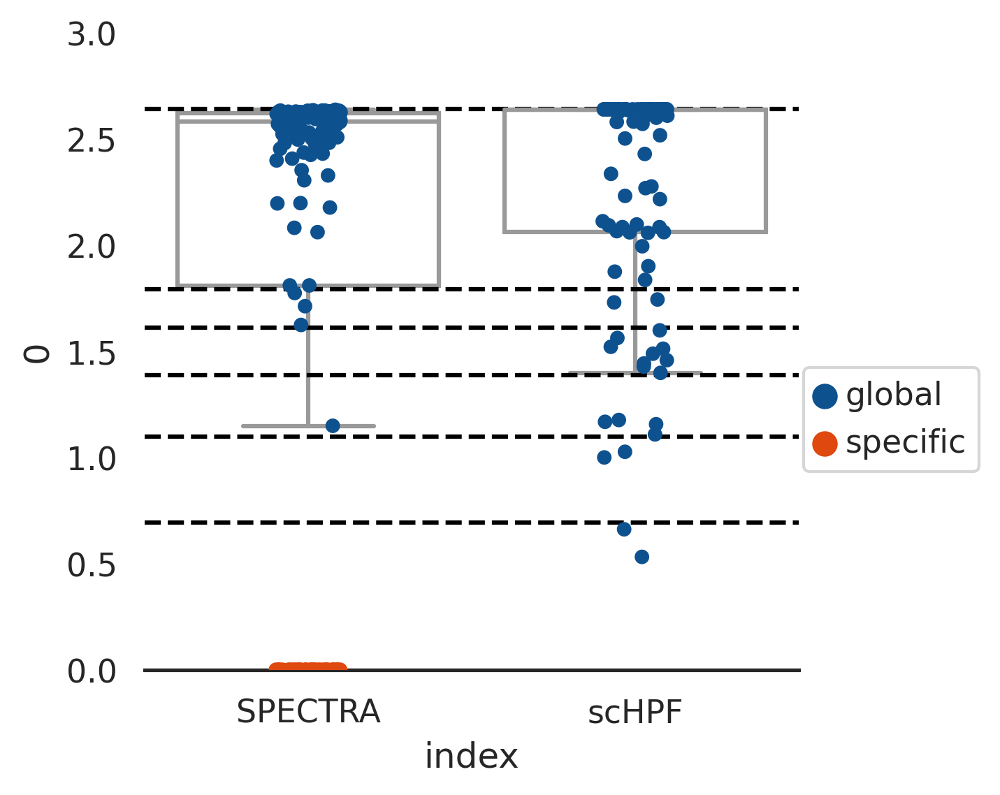

In [120]:
import seaborn as sns
save_name = 'scHPF_SPECTRA_entropy.svg'
fig, ax = plt.subplots()
ax.set(ylim = (0,3))
sns.set_theme(style="white")
# Draw a nested violinplot and split the violins for easier comparison
sns.boxplot(data = plotting_df, x='index', y=0,fliersize=0,color='#FFFFFF')
sns.stripplot(data = plotting_df, x='index', y=0, hue='type',palette = {'global':'#0E518F','specific':'#DF480F'})
sns.despine(left=True)
plt.axhline(max_entrop,linestyle='--',color='#000000')
plt.axhline(two_entrop,linestyle='--',color='#000000')
plt.axhline(three_entrop,linestyle='--',color='#000000')
plt.axhline(four_entrop,linestyle='--',color='#000000')
plt.axhline(five_entrop,linestyle='--',color='#000000')
plt.axhline(six_entrop,linestyle='--',color='#000000')
plt.legend(bbox_to_anchor=(0.8, 0., 0.5, 0.5))
plt.savefig(figure_save_path + save_name)


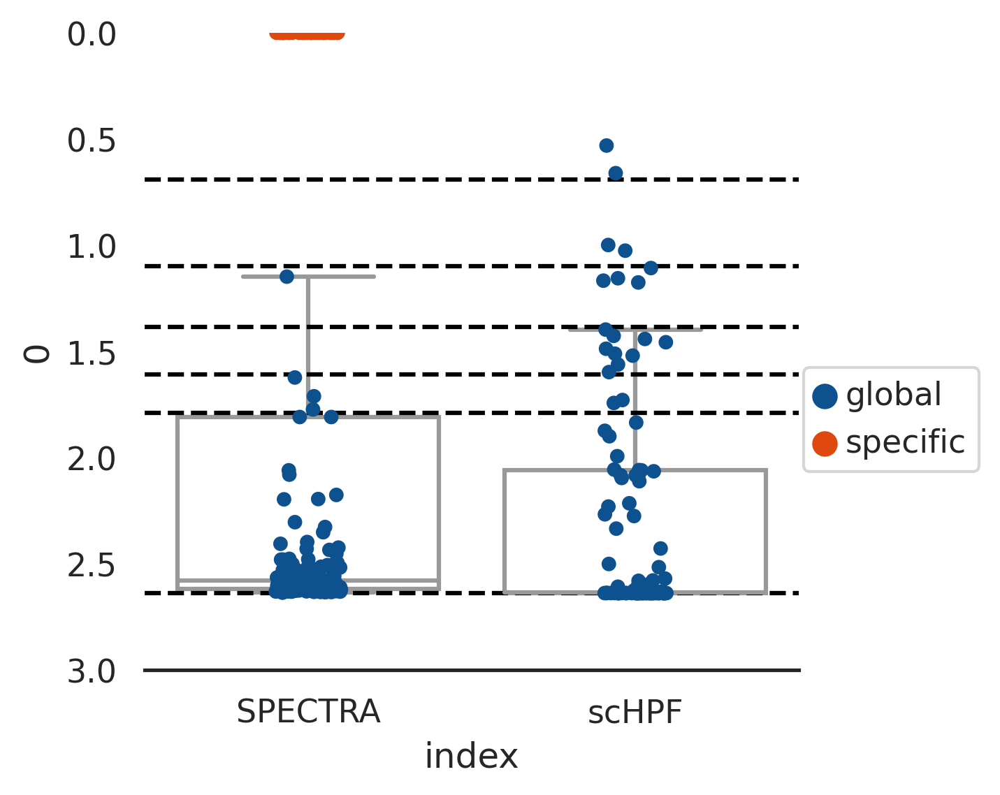

In [121]:
import seaborn as sns
save_name = 'scHPF_SPECTRA_entropy_inverse.svg'
fig, ax = plt.subplots()
ax.set(ylim = (3,0))
sns.set_theme(style="white")
# Draw a nested violinplot and split the violins for easier comparison
sns.boxplot(data = plotting_df, x='index', y=0,fliersize=0,color='#FFFFFF')
sns.stripplot(data = plotting_df, x='index', y=0, hue='type',palette = {'global':'#0E518F','specific':'#DF480F'})
sns.despine(left=True)
plt.axhline(max_entrop,linestyle='--',color='#000000')
plt.axhline(two_entrop,linestyle='--',color='#000000')
plt.axhline(three_entrop,linestyle='--',color='#000000')
plt.axhline(four_entrop,linestyle='--',color='#000000')
plt.axhline(five_entrop,linestyle='--',color='#000000')
plt.axhline(six_entrop,linestyle='--',color='#000000')
plt.legend(bbox_to_anchor=(0.8, 0., 0.5, 0.5))
plt.savefig(figure_save_path + save_name)


## calculate entropy for SLALOM factors

In [122]:
#get loadings of global SLALOM factors
global_SLALOM_fac_names = list(adata_SLALOM.obs.columns[adata_SLALOM.obs.columns.isin(list(adata_SLALOM.uns['SLALOM_markers_global'].keys()))]) + ['annotation_SPADE_1']
SLALOM_global_df = adata_SLALOM.obs[global_SLALOM_fac_names]

In [123]:
SLALOM_global_df_mean = SLALOM_global_df.groupby('annotation_SPADE_1').mean()
SLALOM_global_df_mean.shape

(14, 20)

In [124]:
SLALOM_global_df

,SLALOM_0,SLALOM_1,SLALOM_2,SLALOM_3,SLALOM_4,SLALOM_5,SLALOM_6,SLALOM_7,SLALOM_8,SLALOM_9,...,SLALOM_11,SLALOM_12,SLALOM_13,SLALOM_14,SLALOM_15,SLALOM_16,SLALOM_17,SLALOM_18,SLALOM_19,annotation_SPADE_1
JUQ024_AAACCTGCAACAACCT-1,1.221677,0.472112,-0.744503,0.342843,-1.207892,-0.903271,0.260562,0.249919,-0.009175,-0.537765,...,-0.630189,-0.109053,0.875152,-0.455687,-0.433718,-0.435848,-0.625058,-0.202862,8.986968,DC
JUQ024_AAACCTGCAAGAAGAG-1,-0.489974,0.387439,0.520282,0.294795,-0.401289,-0.636510,-0.492164,0.248616,-0.235721,-0.401976,...,-0.820664,0.590506,0.401387,-0.613969,-0.593053,-0.429568,2.003183,-0.066443,-0.151749,CD8_T
JUQ024_AAACCTGGTCTCCACT-1,-0.339742,0.465620,-4.469625,0.316396,-0.020751,-0.737305,-0.395889,0.249254,-0.129244,-0.269786,...,-1.025502,1.817339,0.749124,-0.458443,-0.380794,-0.738245,-0.345182,-0.066659,-0.174436,pDC
JUQ024_AAACCTGTCAACGAAA-1,1.536939,-0.056895,-0.085581,0.169294,1.519036,0.203103,1.133323,0.251679,-0.259493,-0.160651,...,0.862074,0.707576,0.900974,-0.414150,1.630620,-0.794838,-0.653583,-0.066583,-0.448913,DC
JUQ024_AAACGGGCACAGAGGT-1,2.631364,0.477650,-0.549128,-1.002316,0.038044,-0.463265,1.754380,0.283151,-0.229585,0.751133,...,-0.292932,-0.670651,0.802406,-0.465366,0.021466,-0.612702,-0.632139,-0.269499,2.062841,MDC
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
JUQ124_TTCTCCTGTACCGTAT-1,-0.500048,0.475779,-0.121254,0.071886,-1.102919,-0.879669,-0.475739,0.211287,-0.247290,-0.320840,...,-0.406879,-0.670648,0.519000,-0.112844,-0.468681,0.140016,-0.588024,-0.096432,-0.150179,CD8_T
JUQ124_TTCTTAGTCACCATAG-1,-0.426890,0.476698,0.094761,0.281856,-1.430336,-0.745363,-0.380892,0.248744,-0.254667,-0.372211,...,-0.350893,-0.670650,0.888866,0.646561,-0.403565,-0.425725,-0.356323,-0.111948,-0.161162,CD4_T
JUQ124_TTTACTGCACCAGATT-1,-0.529372,-0.259311,0.708856,0.262667,-0.673230,-0.747313,-0.505989,0.182944,-0.257006,-0.306584,...,-0.538289,-0.670645,-0.198684,-0.530674,-0.583430,-0.156220,1.024668,-0.083341,-0.145787,CD8_T
JUQ124_TTTACTGCACGGTGTC-1,2.801744,0.485235,-0.354477,0.270014,1.468953,-0.563486,1.734439,0.200174,-0.255299,-0.227408,...,0.168927,0.224553,0.841475,-0.325945,2.538430,0.009924,-0.718854,0.093678,7.950928,MDC


In [125]:
SLALOM_global_df_mean.applymap(lambda x: x+1)

,SLALOM_0,SLALOM_1,SLALOM_2,SLALOM_3,SLALOM_4,SLALOM_5,SLALOM_6,SLALOM_7,SLALOM_8,SLALOM_9,SLALOM_10,SLALOM_11,SLALOM_12,SLALOM_13,SLALOM_14,SLALOM_15,SLALOM_16,SLALOM_17,SLALOM_18,SLALOM_19
annotation_SPADE_1,,,,,,,,,,,,,,,,,,,,
B_GC,0.579722,1.249390,-1.494088,-1.456704,1.509997,0.670686,0.588924,0.169594,3.419593,0.790803,1.374581,0.755177,1.140853,1.721886,0.816479,0.659938,0.726321,0.521903,0.938324,0.882840
B_memory,0.714451,1.218305,0.629708,1.135447,0.509598,0.718620,0.610425,1.063089,0.822591,0.917409,3.762883,0.576109,0.851817,1.816571,0.546063,0.656197,0.315929,0.424231,0.936394,0.859403
B_naive,0.663170,1.224812,0.713655,1.139013,0.494639,0.821715,0.568685,1.073401,0.808443,0.940765,4.886440,0.505525,0.791114,1.839459,0.534435,0.598756,0.302276,0.396223,0.935046,0.866184
CD4_T,0.550762,1.111657,0.961023,0.969177,0.609065,0.774431,0.594640,1.011966,1.031391,0.757750,0.584873,0.748635,0.825276,1.426179,1.293228,0.560675,1.257514,0.634620,0.933186,0.870849
CD8_T,0.575018,1.094700,1.296595,0.995992,0.686284,0.954130,0.582920,1.003421,1.034436,0.773785,0.711319,0.679955,0.808703,-0.082921,1.136785,0.987832,1.161965,1.568088,0.937695,0.855648
DC,2.675343,0.802271,0.549228,0.892523,2.150489,1.261886,2.126085,0.894313,1.129944,0.834258,1.584034,1.825419,1.689858,1.735732,0.650313,1.895935,0.350191,0.396486,1.073056,2.888644
ILC3,0.684533,1.098379,0.698099,1.199420,0.637908,0.516589,0.711106,1.025336,0.820322,0.800368,0.747207,0.749662,0.947404,1.802314,0.693110,0.574870,0.684855,1.537896,1.023361,0.837885
MDC,3.324574,0.576142,0.758827,1.021123,2.576611,1.568006,3.434265,0.906344,0.982297,0.879003,0.882905,2.782351,1.945930,1.784483,0.651465,2.286478,0.322917,0.364985,1.416036,1.562878
NK,0.629916,1.029394,0.940276,1.157233,0.687255,0.758776,0.699809,1.055430,0.824614,0.785119,0.609453,0.675875,0.845467,0.229550,0.711661,1.403412,1.005651,3.705792,0.931950,0.844228


In [126]:
#exponentiate (we cannot calculate entropy on negatives)
SLALOM_global_df_mean = SLALOM_global_df_mean.applymap(lambda x: 10**x)
SLALOM_global_df_mean

,SLALOM_0,SLALOM_1,SLALOM_2,SLALOM_3,SLALOM_4,SLALOM_5,SLALOM_6,SLALOM_7,SLALOM_8,SLALOM_9,SLALOM_10,SLALOM_11,SLALOM_12,SLALOM_13,SLALOM_14,SLALOM_15,SLALOM_16,SLALOM_17,SLALOM_18,SLALOM_19
annotation_SPADE_1,,,,,,,,,,,,,,,,,,,,
B_GC,0.379946,1.775783,0.003206,0.003494,3.235911,0.468474,0.388082,0.147773,262.780238,0.617737,2.369085,0.569084,1.383097,5.270912,0.655359,0.457023,0.532502,0.332585,0.867610,0.763554
B_memory,0.518144,1.653123,0.426293,1.365990,0.323294,0.523143,0.407779,1.156350,0.664646,0.826815,579.272050,0.376799,0.710913,6.554980,0.351612,0.453103,0.206980,0.265602,0.863763,0.723441
B_naive,0.460437,1.678077,0.517196,1.377250,0.312348,0.663308,0.370412,1.184134,0.643343,0.872500,7699.092568,0.320276,0.618178,6.909695,0.342322,0.396969,0.200575,0.249014,0.861085,0.734826
CD4_T,0.355436,1.293174,0.914162,0.931488,0.406504,0.594882,0.393224,1.027936,1.074957,0.572466,0.384479,0.560577,0.668768,2.667960,1.964392,0.363643,1.809316,0.431141,0.857404,0.742761
CD8_T,0.375853,1.243654,1.979681,0.990813,0.485606,0.899766,0.382754,1.007908,1.082519,0.593998,0.514421,0.478581,0.643729,0.082619,1.370204,0.972370,1.451996,3.699031,0.866353,0.717212
DC,47.352536,0.634265,0.354183,0.780770,14.141285,1.827619,13.368582,0.783994,1.348790,0.682744,3.837371,6.689891,4.896187,5.441672,0.447005,7.869274,0.223971,0.249165,1.183194,77.382684
ILC3,0.483652,1.254235,0.498998,1.582778,0.434418,0.328540,0.514170,1.060074,0.661184,0.631492,0.558737,0.561903,0.885939,6.343287,0.493298,0.375725,0.484011,3.450608,1.055264,0.688470
MDC,211.141823,0.376827,0.573888,1.049841,37.723397,3.698333,271.809802,0.806016,0.960056,0.756838,0.763668,60.582992,8.829377,6.088114,0.448193,19.340947,0.210338,0.231731,2.606368,3.654923
NK,0.426497,1.070026,0.871516,1.436261,0.486692,0.573821,0.500966,1.136136,0.667750,0.609704,0.406868,0.474106,0.700595,0.169648,0.514826,2.531701,1.013097,507.916552,0.854968,0.698600


In [127]:
SLALOM_global_df_entropy = pd.DataFrame(scipy.stats.entropy(SLALOM_global_df_mean,  base=None, axis=0))
SLALOM_global_df_entropy.index = ['SLALOM']*SLALOM_global_df_entropy.shape[0]
SLALOM_global_df_entropy = SLALOM_global_df_entropy.reset_index()

In [128]:
SLALOM_global_df_entropy['type'] = len(SLALOM_global_df_entropy)*['global']

## calculate entropy for SPECTRA factors also used for SLALOM

In [129]:
SPECTRA_fac_names_norm = [x+'-X-norm' for x in SPECTRA_fac_names]
SPECTRA_fac_names_norm

['10-X-all_type-II-ifn-response-X-norm',
 '101-X-all_DNA_synthesis-X-norm',
 '102-X-all_G1S-transition-X-norm',
 '103-X-all_LYS_metabolism-X-norm',
 '127-X-all_MHC-II-presentation-X-norm',
 '129-X-all_hypoxia-response-X-norm',
 '140-X-all_pentose-phosphate-pathway-X-norm',
 '22-X-all_posttranslation-modification-X-norm',
 '25-X-all_MHC-I-presentation-X-norm',
 '27-X-all_G2M-transition-X-norm',
 '31-X-all_oxidative-phosphorylation-X-norm',
 '46-X-all_oxidative-phosphorylation-X-norm',
 '55-X-all_type-I-ifn-response-X-norm',
 '94-X-all_glycolysis-X-norm',
 '171-X-CD8-T_tumor-reactive-like_UP-X-norm',
 '172-X-CD8-T_terminal-exhaustion-X-norm',
 '173-X-T_tcr-activation-X-norm',
 '175-X-TNK_PD-1_signaling-X-norm',
 '176-X-TNK_cytotoxicity-effectors-X-norm',
 '182-X-M_angiogenic-effectors-X-norm',
 '184-X-Mac_IL4-IL13_response-X-norm']

In [130]:
#get loadings of global SPECTRA factors
SPECTRA_global_df = adata_SPECTRA.obs[SPECTRA_fac_names_norm+['annotation_SPADE_1']]

In [131]:
SPECTRA_global_df_mean = SPECTRA_global_df.groupby('annotation_SPADE_1').mean()
SPECTRA_global_df_mean.shape

(14, 21)

In [132]:
SPECTRA_global_df_entropy

,index,0,type
0,SPECTRA,2.481332,global
1,SPECTRA,2.616712,global
2,SPECTRA,2.518411,global
3,SPECTRA,2.501746,global
4,SPECTRA,2.608161,global
...,...,...,...
192,SPECTRA,0.000000,specific
193,SPECTRA,0.000000,specific
194,SPECTRA,0.000000,specific
195,SPECTRA,0.000000,specific


#normalize df
SPECTRA_global_df_mean = SPECTRA_global_df_mean/SPECTRA_global_df_mean.sum(axis = 0)
SPECTRA_global_df_mean

In [161]:
#calculate entropy per factor
SPECTRA_global_df_entropy = pd.DataFrame(scipy.stats.entropy(SPECTRA_global_df_mean, base=None, axis=0),index=SPECTRA_global_df_mean.columns)



In [162]:
#get loadings of global SPECTRA factors
global_fac_names = list(adata_SPECTRA.obs.columns[adata_SPECTRA.obs.columns.isin(list(adata_SPECTRA.uns['SPADE_markers_global'].keys()))]) 
global_fac_names

['0-X-all_multidrug-resistance',
 '1-X-all_porphyrine-heme_metabolism',
 '2-X-all_TNF-via-NFkB_signaling',
 '3-X-all_glyoxylate-dicarboxylate_metabolism',
 '4-X-all_IL6-JAK-STAT3_signaling',
 '5-X-5',
 '6-X-all_triacylglycerol_synthesis',
 '7-X-all_circadian-rhythm',
 '8-X-all_heparan-sulfate_degradation',
 '9-X-all_autophagy-of-mitochondria_regulation_positive',
 '10-X-all_type-II-ifn-response',
 '11-X-all_autophagy_regulation_positive',
 '12-X-all_DNA-demethylation',
 '13-X-all_TYR_metabolism',
 '14-X-all_autophagy-of-mitochondria',
 '15-X-all_autophagy-chaperone-mediated',
 '16-X-all_transmembrane-transport-golgi',
 '17-X-all_osmotic-stress-response',
 '18-X-all_o-glycan_synthesis',
 '19-X-all_transmembrane-transport-mitochondrial',
 '20-X-all_cytosolic-DNA-sensing_signaling',
 '21-X-all_mitophagy_regulation_positive',
 '22-X-all_posttranslation-modification',
 '23-X-leuko_transendothelial-migration',
 '24-X-all_autophagic-cell-death',
 '25-X-all_MHC-I-presentation',
 '26-X-all_hist

In [163]:
#retrieve specific SPECTRA factors and a flat dictionary (non hierarchical for spec factors)

spec_fac = []
flat_dict = {}

for i in list(adata_SPECTRA.uns['SPADE_markers_specific'].keys()):
    cell_type_spec_fac = list(adata_SPECTRA.uns['SPADE_markers_specific'][i].keys())
    spec_fac = spec_fac + cell_type_spec_fac
    for j in cell_type_spec_fac:
        flat_dict[j] = adata_SPECTRA.uns['SPADE_markers_specific'][i][j]
spec_fac

['152-X-152',
 '153-X-B_Breg_UP',
 '154-X-B_effector-2_UP',
 '155-X-B_effector-1_UP',
 '156-X-B_IgM-ligation_response',
 '157-X-157',
 '158-X-158',
 '159-X-CD4-T_IL12_response',
 '160-X-TNK_IL2_response',
 '161-X-CD4-T_TH22_UP',
 '162-X-CD4-T_TH17_UP',
 '163-X-TNK_IL2-STAT5-signaling',
 '164-X-T_IL21_response',
 '165-X-CD4-T_TH9_UP',
 '166-X-CD4-T_TFH_UP',
 '167-X-CD4-T_IL4_response',
 '168-X-CD4-T_TH2_UP',
 '169-X-CD4-T_TH1_UP',
 '170-X-170',
 '171-X-CD8-T_tumor-reactive-like_UP',
 '172-X-CD8-T_terminal-exhaustion',
 '173-X-T_tcr-activation',
 '174-X-CD8-T_IL12_response',
 '175-X-TNK_PD-1_signaling',
 '176-X-TNK_cytotoxicity-effectors',
 '177-X-177',
 '178-X-178',
 '179-X-DC_LPS_response',
 '180-X-180',
 '181-X-181',
 '182-X-M_angiogenic-effectors',
 '183-X-Mac_LPS_response',
 '184-X-Mac_IL4-IL13_response',
 '185-X-Mac_CSF1_response',
 '186-X-Mac_IFNG_response',
 '187-X-187',
 '188-X-188',
 '189-X-Treg_FoxP3-stabilization',
 '190-X-190',
 '191-X-191',
 '192-X-mast_granule-exocytosis',

In [164]:
#add category specific vs global to df for scatter

glob_spec_ls = []

SPECTRA_global_df_entropy_index_nonorm = [x[:-7] for x in SPECTRA_global_df_entropy.index]
for i in SPECTRA_global_df_entropy_index_nonorm:
    if i in spec_fac and i in global_fac_names:
        print('check factor lists',i,'found in both global and specific factors')
    elif i in global_fac_names:
        glob_spec_ls.append('global')
    elif i in spec_fac:
        glob_spec_ls.append('specific')
    else:
        print('check factor lists',i,'was not found in any list')
    

In [165]:
SPECTRA_global_df_entropy['type'] = glob_spec_ls
SPECTRA_global_df_entropy

,0,type
10-X-all_type-II-ifn-response-X-norm,2.304917,global
101-X-all_DNA_synthesis-X-norm,2.081109,global
102-X-all_G1S-transition-X-norm,1.774074,global
103-X-all_LYS_metabolism-X-norm,2.398339,global
127-X-all_MHC-II-presentation-X-norm,2.352340,global
129-X-all_hypoxia-response-X-norm,2.579719,global
140-X-all_pentose-phosphate-pathway-X-norm,2.558927,global
22-X-all_posttranslation-modification-X-norm,2.507437,global
25-X-all_MHC-I-presentation-X-norm,2.589195,global
27-X-all_G2M-transition-X-norm,2.560484,global


In [174]:
SPECTRA_global_df_entropy.index = ['SPECTRA']*SPECTRA_global_df_entropy.shape[0]
SPECTRA_global_df_entropy = SPECTRA_global_df_entropy.reset_index()
SPECTRA_global_df_entropy

,level_0,index,0,type
0,SPECTRA,SPECTRA,2.304917,global
1,SPECTRA,SPECTRA,2.081109,global
2,SPECTRA,SPECTRA,1.774074,global
3,SPECTRA,SPECTRA,2.398339,global
4,SPECTRA,SPECTRA,2.352340,global
5,SPECTRA,SPECTRA,2.579719,global
6,SPECTRA,SPECTRA,2.558927,global
7,SPECTRA,SPECTRA,2.507437,global
8,SPECTRA,SPECTRA,2.589195,global
9,SPECTRA,SPECTRA,2.560484,global


## plot entropy

In [175]:
plotting_df = pd.concat([SPECTRA_global_df_entropy,SLALOM_global_df_entropy])

In [176]:
plotting_df

,level_0,index,0,type
0,SPECTRA,SPECTRA,2.304917,global
1,SPECTRA,SPECTRA,2.081109,global
2,SPECTRA,SPECTRA,1.774074,global
3,SPECTRA,SPECTRA,2.398339,global
4,SPECTRA,SPECTRA,2.352340,global
5,SPECTRA,SPECTRA,2.579719,global
6,SPECTRA,SPECTRA,2.558927,global
7,SPECTRA,SPECTRA,2.507437,global
8,SPECTRA,SPECTRA,2.589195,global
9,SPECTRA,SPECTRA,2.560484,global


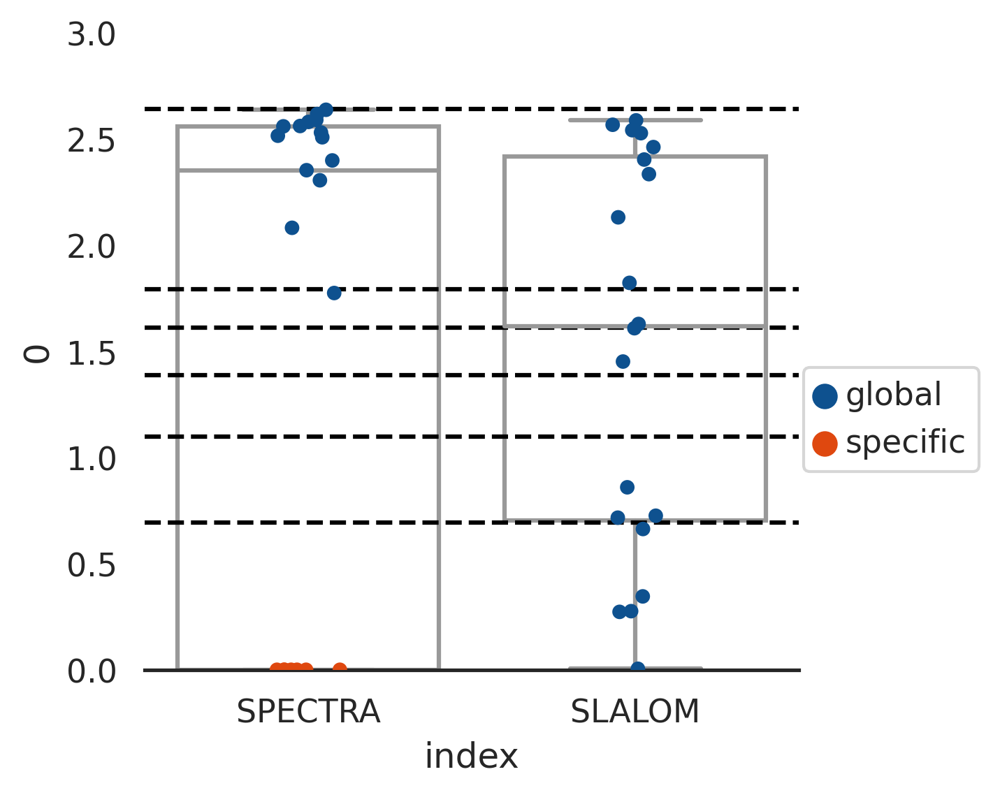

In [177]:
import seaborn as sns
save_name = 'scHPF_SPECTRA_entropy.svg'
fig, ax = plt.subplots()
ax.set(ylim = (0,3))
sns.set_theme(style="white")
# Draw a nested violinplot and split the violins for easier comparison
sns.boxplot(data = plotting_df, x='index', y=0,fliersize=0,color='#FFFFFF')
sns.stripplot(data = plotting_df, x='index', y=0, hue='type',palette = {'global':'#0E518F','specific':'#DF480F'})
sns.despine(left=True)
plt.axhline(max_entrop,linestyle='--',color='#000000')
plt.axhline(two_entrop,linestyle='--',color='#000000')
plt.axhline(three_entrop,linestyle='--',color='#000000')
plt.axhline(four_entrop,linestyle='--',color='#000000')
plt.axhline(five_entrop,linestyle='--',color='#000000')
plt.axhline(six_entrop,linestyle='--',color='#000000')
plt.legend(bbox_to_anchor=(0.8, 0., 0.5, 0.5))
plt.savefig(figure_save_path + save_name)


In [178]:
figure_save_path + 'SLALOM_SPECTRA_entropy.svg'

'/data/peer/wallet/Jupyter/SPADE_Peer_validation/figures/SLALOM_SPECTRA_entropy.svg'

## check highly cell type specific markers

### overlap scHPF

In [193]:
scHPF_global_df_entropy = pd.DataFrame(scipy.stats.entropy(scHPF_global_df_mean, qk=None, base=None, axis=0),index=scHPF_global_df_mean.columns)
cell_type_spec = scHPF_global_df_entropy.sort_values(0).iloc[0:10,:].index

In [194]:
 scHPF_global_df_entropy.sort_values(0).iloc[0:10,:][0]

scHPF_8     0.531589
scHPF_92    0.661550
scHPF_45    0.999880
scHPF_60    1.026452
scHPF_12    1.108369
scHPF_93    1.156362
scHPF_81    1.167652
scHPF_15    1.176163
scHPF_66    1.398111
scHPF_57    1.427630
Name: 0, dtype: float32

In [195]:
#combine max expression and LYS overlap for LYS example
max_expression = scHPF_global_df_mean.T.sort_values('plasma',ascending=False)['plasma']
plotting_df = pd.concat([overlap_df_scHPF['all_LYS_metabolism'],scHPF_global_df_entropy,max_expression],axis=1)
plotting_df = plotting_df.sort_values(0)

In [196]:
#max 
print('max overlap coefficient for LYS metabolism in scHPF is:',
      np.max(plotting_df.sort_values('all_LYS_metabolism')['all_LYS_metabolism']))

max overlap coefficient for LYS metabolism in scHPF is: 0.1111111111111111


In [197]:
plotting_df.sort_values('all_LYS_metabolism')['all_LYS_metabolism']

scHPF_8     0.000000
scHPF_24    0.000000
scHPF_70    0.000000
scHPF_26    0.000000
scHPF_56    0.000000
              ...   
scHPF_90    0.055556
scHPF_64    0.055556
scHPF_74    0.055556
scHPF_75    0.055556
scHPF_27    0.111111
Name: all_LYS_metabolism, Length: 100, dtype: float64

In [201]:
plotting_df

,all_LYS_metabolism,0,plasma
scHPF_8,0.0,0.531589,0.053563
scHPF_92,0.0,0.661550,0.059243
scHPF_45,0.0,0.999880,6.381325
scHPF_60,0.0,1.026452,0.028437
scHPF_12,0.0,1.108369,0.028711
...,...,...,...
scHPF_33,0.0,2.638871,0.278207
scHPF_3,0.0,2.638871,0.278207
scHPF_97,0.0,2.638871,0.278207
scHPF_76,0.0,2.638871,0.278207


scHPF_overlap_LYS.svg


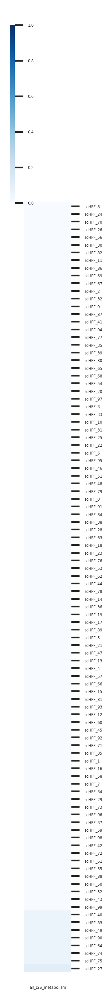

In [199]:
#plot max overlap
save_name = 'scHPF_overlap_LYS.svg'
sns.set(font_scale=0.25)
sns.clustermap(plotting_df.sort_values('all_LYS_metabolism')['all_LYS_metabolism'],pivot_kws=None, method='average', metric='euclidean', 
           standard_scale=None, figsize=(1, 10), cbar_kws=None, row_cluster=False, 
           col_cluster=False, row_linkage=None, col_linkage=None, row_colors=None, 
           col_colors=None, mask=None, dendrogram_ratio=0.2, colors_ratio=0.03, cmap='Blues',
           cbar_pos=(0.02, 0.8, 0.05, 0.18), tree_kws=None,vmin=0,center=0.5,vmax=1)
plt.savefig(figure_save_path + save_name)
print(save_name)

### overlap SLALOM

In [200]:
plotting_df

,all_LYS_metabolism,0,plasma
scHPF_8,0.0,0.531589,0.053563
scHPF_92,0.0,0.661550,0.059243
scHPF_45,0.0,0.999880,6.381325
scHPF_60,0.0,1.026452,0.028437
scHPF_12,0.0,1.108369,0.028711
...,...,...,...
scHPF_33,0.0,2.638871,0.278207
scHPF_3,0.0,2.638871,0.278207
scHPF_97,0.0,2.638871,0.278207
scHPF_76,0.0,2.638871,0.278207


SLALOM_overlap_LYS.svg


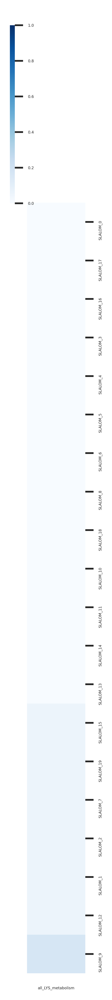

In [229]:
#plot max overlap
save_name = 'SLALOM_overlap_LYS.svg'
sns.set(font_scale=0.25)
sns.clustermap(overlap_df_SLALOM.sort_values('all_LYS_metabolism')['all_LYS_metabolism'],pivot_kws=None, method='average', metric='euclidean', 
           standard_scale=None, figsize=(1, 10), cbar_kws=None, row_cluster=False, 
           col_cluster=False, row_linkage=None, col_linkage=None, row_colors=None, 
           col_colors=None, mask=None, dendrogram_ratio=0.2, colors_ratio=0.03, cmap='Blues',
           cbar_pos=(0.02, 0.8, 0.05, 0.18), tree_kws=None,vmin=0,center=0.5,vmax=1)
plt.savefig(figure_save_path + save_name)
print(save_name)

### overlap SPECTRA

In [231]:
overlap_df_SPECTRA_spec

,all_ketone-body_metabolism,all_iron-uptake-and-storage,all_TYR_metabolism,all_selenoamino-acid_metabolism,CD4-T_IL4_response,TNK_IL2_response,all_transmembrane-transport-lysosome,all_carnitine-shuttle,CD4-T_TFH_UP,all_purine_synthesis,...,all_fatty-acid-beta-oxidation-peroxisomal,all_GPI-anchor_synthesis,all_riboflavin_metabolism,all_n-glycan_degradation,CD4-T_TH17_UP,all_type-I-ifn-response,all_n-glycan_synthesis,all_pyrimidine_synthesis,all_cytosolic-DNA-sensing_signaling,leuko_ROS_production
152-X-152,0.0000,0.000000,0.02,0.000000,0.000000,0.000000,0.000000,0.000,0.000,0.000000,...,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00,0.0
153-X-B_Breg_UP,0.0000,0.000000,0.00,0.000000,0.000000,0.052632,0.000000,0.000,0.000,0.000000,...,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00,0.0
154-X-B_effector-2_UP,0.0000,0.000000,0.00,0.000000,0.000000,0.000000,0.000000,0.000,0.125,0.000000,...,0.0,0.000000,0.000000,0.000000,0.058824,0.058824,0.000000,0.000000,0.02,0.0
155-X-B_effector-1_UP,0.0000,0.000000,0.00,0.000000,0.000000,0.000000,0.000000,0.000,0.000,0.071429,...,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00,0.0
156-X-B_IgM-ligation_response,0.0000,0.000000,0.00,0.000000,0.000000,0.052632,0.000000,0.125,0.000,0.000000,...,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00,0.0
157-X-157,0.0000,0.000000,0.00,0.000000,0.000000,0.000000,0.000000,0.000,0.000,0.035714,...,0.0,0.000000,0.000000,0.071429,0.000000,0.000000,0.026316,0.000000,0.00,0.0
158-X-158,0.0000,0.000000,0.02,0.000000,0.000000,0.000000,0.000000,0.000,0.000,0.000000,...,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00,0.0
159-X-CD4-T_IL12_response,0.0000,0.000000,0.00,0.000000,0.000000,0.000000,0.000000,0.000,0.000,0.000000,...,0.0,0.000000,0.000000,0.000000,0.000000,0.058824,0.000000,0.000000,0.02,0.0
160-X-TNK_IL2_response,0.0000,0.000000,0.00,0.000000,0.000000,0.947368,0.000000,0.000,0.000,0.000000,...,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00,0.0
161-X-CD4-T_TH22_UP,0.0000,0.000000,0.00,0.000000,0.000000,0.263158,0.000000,0.000,0.125,0.000000,...,0.0,0.000000,0.000000,0.000000,0.117647,0.058824,0.000000,0.000000,0.02,0.0


/home/wallet/miniconda3/envs/2022_Peer_SPADE_cellrank2/lib/python3.10/site-packages/seaborn/matrix.py:1203: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  self._figure.tight_layout(**tight_params)


SPECTRA_overlap_LYS.svg


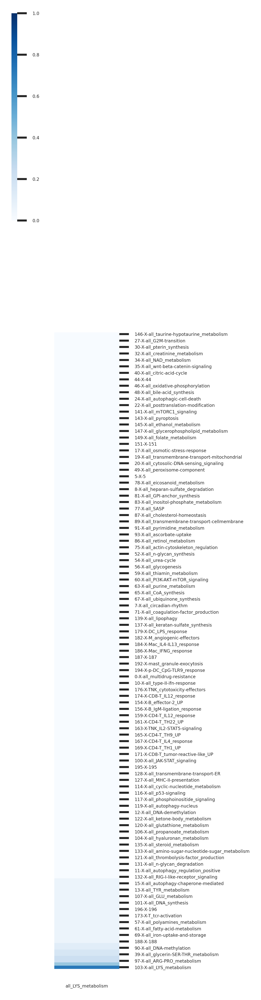

In [233]:
#plot max overlap
save_name = 'SPECTRA_overlap_LYS.svg'
sns.set(font_scale=0.25)
sns.clustermap(overlap_df_SPECTRA_merged.sort_values('all_LYS_metabolism')['all_LYS_metabolism'],pivot_kws=None, method='average', metric='euclidean', 
           standard_scale=None, figsize=(1, 10), cbar_kws=None, row_cluster=False, 
           col_cluster=False, row_linkage=None, col_linkage=None, row_colors=None, 
           col_colors=None, mask=None, dendrogram_ratio=0.2, colors_ratio=0.03, cmap='Blues',
           cbar_pos=(0.02, 0.8, 0.05, 0.18), tree_kws=None,vmin=0,center=0.5,vmax=1)
plt.savefig(figure_save_path + save_name)
print(save_name)

## overview Slalom, Spectra, scHPF LYS 

In [210]:
df_list = [overlap_df_scHPF['all_LYS_metabolism'],
           overlap_df_SLALOM['all_LYS_metabolism'],
           overlap_df_SPECTRA['all_LYS_metabolism']]

LYS_merged_df = pd.concat(df_list)
LYS_merged_df = pd.DataFrame(LYS_merged_df)


#add method variable to df

method_list = []

for x in LYS_merged_df.index:
    if x in overlap_df_scHPF.index:
        method_list.append('scHPF')
    elif x in overlap_df_SLALOM.index:
        method_list.append('Slalom')
    elif x in overlap_df_SPECTRA.index:
        method_list.append('Spectra')
    else:
        print('index not in Spectra, Slalom or scHPF')

LYS_merged_df['method'] = method_list
LYS_merged_df

,all_LYS_metabolism,method
scHPF_0,0.000000,scHPF
scHPF_1,0.000000,scHPF
scHPF_2,0.000000,scHPF
scHPF_3,0.000000,scHPF
scHPF_4,0.000000,scHPF
...,...,...
95-X-all_TRP_metabolism,0.222222,Spectra
96-X-all_fatty-acid-beta-oxidation-mitochondrial,0.055556,Spectra
97-X-all_ARG-PRO_metabolism,0.222222,Spectra
98-X-all_selenoamino-acid_metabolism,0.000000,Spectra


In [219]:
LYS_merged_df[LYS_merged_df['method']=='Spectra'].sort_values(by='all_LYS_metabolism',ascending=False)

,all_LYS_metabolism,method
103-X-all_LYS_metabolism,0.722222,Spectra
74-X-all_HIS_metabolism,0.388889,Spectra
97-X-all_ARG-PRO_metabolism,0.222222,Spectra
95-X-all_TRP_metabolism,0.222222,Spectra
28-X-28,0.166667,Spectra
...,...,...
146-X-all_taurine-hypotaurine_metabolism,0.000000,Spectra
147-X-all_glycerophospholipid_metabolism,0.000000,Spectra
148-X-all_complement_production,0.000000,Spectra
149-X-all_folate_metabolism,0.000000,Spectra


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


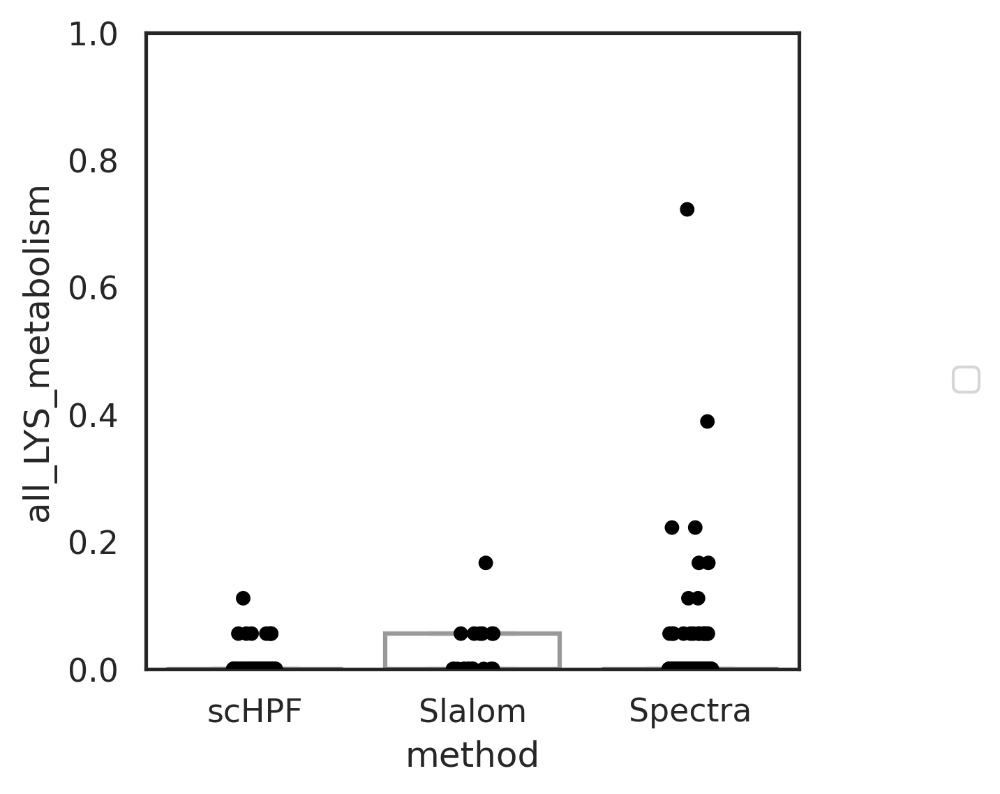

In [222]:
import seaborn as sns
save_name = 'Merged_methods_overlap_LYS.svg'
fig, ax = plt.subplots()
ax.set(ylim = (0,1))
sns.set_theme(style="white")
# Draw a nested violinplot and split the violins for easier comparison
sns.boxplot(data = LYS_merged_df, x='method', y='all_LYS_metabolism',fliersize=0,color='#FFFFFF')
sns.stripplot(data = LYS_merged_df, x='method', y='all_LYS_metabolism',color='#000000')
plt.legend(bbox_to_anchor=(0.8, 0., 0.5, 0.5))
plt.savefig(figure_save_path + save_name)


## dotplot expressi factors in cell types

#### SPECTRA

In [178]:
#get gene programs
factor_norm = [x + '-X-norm' for x in list(adata_SPECTRA.uns['SPADE_markers_global'].keys())]
metabolic_factors = list(adata_SPECTRA.obs.columns[adata_SPECTRA.obs.columns.isin(factor_norm)])


In [179]:
#The SPECTRA loadings are generally bimodal. The lower mode can be assumed to be non-expression while the 
#upper mode can be assumed to be expression of this factor. While the lower mode is generally close to zero it 
#is not exactly 0. here we will calculate the positive fraction of cells for different factors to find a good
#threshold above the lower mode but below the higher mode of the factor loadings
#calculate pos frac for diferent thresholds to find a rational threshold for defining the zero fraction

#set everything below threshold 0
thresholds_to_test =[0,0.01,0.02,0.03,0.04,0.05,0.06,0.07,0.08,0.09,0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9,1,2,3,4,5,6,7,8,9,10]

out_df = pd.DataFrame()

for thresh in thresholds_to_test:
    plotting_df = adata_SPECTRA.obs[metabolic_factors]
    plotting_df_thresh = plotting_df.applymap(lambda x: 0 if x < thresh else x)
    plotting_df_thresh_group = plotting_df_thresh

    df = plotting_df_thresh_group.copy()
    df_frac = pd.DataFrame()

    #calculate positive fraction per gene program and cell type
    for i in df.columns:
        df['sign'] = np.sign(df[i])
        allzero  = df['sign'] == 0
        nonezero  = df['sign'] != 0
        if allzero.all() ==False and nonezero.all()==False:
            pos_cells = df.sign.value_counts()
            pos_frac = pos_cells[1]/(pos_cells[0]+pos_cells[1])
            out_df.loc[thresh,i] = pos_frac
        elif nonezero.all()==True:
            #print('for',i,'no negative cells were detected, setting positive fraction to 1')
            out_df.loc[thresh,i] = 1
        elif allzero.all()==True:
            #print('for',i,'no positive cells were detected, setting positive fraction to 0')
            out_df.loc[thresh,i] = 0

out_df      

/home/wallet/miniconda3/envs/2022_Peer_SPADE_sample_data_exploration/lib/python3.7/site-packages/pandas/core/indexing.py:1684: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead.  To get a de-fragmented frame, use `newframe = frame.copy()`
  self.obj[key] = infer_fill_value(value)


,0-X-all_multidrug-resistance-X-norm,1-X-all_porphyrine-heme_metabolism-X-norm,2-X-all_TNF-via-NFkB_signaling-X-norm,3-X-all_glyoxylate-dicarboxylate_metabolism-X-norm,4-X-all_IL6-JAK-STAT3_signaling-X-norm,5-X-5-X-norm,6-X-all_triacylglycerol_synthesis-X-norm,7-X-all_circadian-rhythm-X-norm,8-X-all_heparan-sulfate_degradation-X-norm,9-X-all_autophagy-of-mitochondria_regulation_positive-X-norm,...,142-X-142-X-norm,143-X-all_pyroptosis-X-norm,144-X-all_purine_metabolism-X-norm,145-X-all_ethanol_metabolism-X-norm,146-X-all_taurine-hypotaurine_metabolism-X-norm,147-X-all_glycerophospholipid_metabolism-X-norm,148-X-all_complement_production-X-norm,149-X-all_folate_metabolism-X-norm,150-X-150-X-norm,151-X-151-X-norm
0.00,1.000000,1.0,1.000000,1.000000,1.000000,1.000000,1.0,1.0,1.0,1.000000,...,1.000000,1.000000,1.0,1.000000,1.000000,1.000000,1.000000,1.0,1.000000,1.000000
0.01,0.128465,0.0,0.626192,0.496500,0.000184,0.133564,0.0,0.0,0.0,0.687410,...,0.007756,0.323084,0.0,0.004077,0.028315,0.000061,0.255612,0.0,0.660055,0.321470
0.02,0.058357,0.0,0.446900,0.486404,0.000000,0.103798,0.0,0.0,0.0,0.344625,...,0.001042,0.246917,0.0,0.000020,0.008614,0.000000,0.172169,0.0,0.644340,0.173487
0.03,0.019946,0.0,0.298111,0.474531,0.000000,0.081972,0.0,0.0,0.0,0.105791,...,0.000215,0.186506,0.0,0.000000,0.002493,0.000000,0.132675,0.0,0.633784,0.104023
0.04,0.006335,0.0,0.188263,0.456986,0.000000,0.064764,0.0,0.0,0.0,0.021285,...,0.000041,0.137304,0.0,0.000000,0.000623,0.000000,0.112749,0.0,0.624577,0.062853
0.05,0.002136,0.0,0.112872,0.433249,0.000000,0.052032,0.0,0.0,0.0,0.003576,...,0.000010,0.101376,0.0,0.000000,0.000092,0.000000,0.100620,0.0,0.615279,0.038523
0.06,0.000807,0.0,0.064539,0.407938,0.000000,0.042028,0.0,0.0,0.0,0.000685,...,0.000010,0.074880,0.0,0.000000,0.000061,0.000000,0.093069,0.0,0.605152,0.024514
0.07,0.000255,0.0,0.035151,0.382657,0.000000,0.033833,0.0,0.0,0.0,0.000194,...,0.000000,0.056569,0.0,0.000000,0.000020,0.000000,0.086897,0.0,0.593227,0.015930
0.08,0.000082,0.0,0.019129,0.356018,0.000000,0.027232,0.0,0.0,0.0,0.000051,...,0.000000,0.043050,0.0,0.000000,0.000000,0.000000,0.081686,0.0,0.580444,0.010699
0.09,0.000061,0.0,0.009677,0.330339,0.000000,0.021990,0.0,0.0,0.0,0.000020,...,0.000000,0.033547,0.0,0.000000,0.000000,0.000000,0.077149,0.0,0.567058,0.007602


In [180]:
#plot pos fractions for different thresholds
sns.set(font_scale = 0.5) # if error matplotlib has no attribute DivergingNorm appears update Matplotlib
h = sns.clustermap(out_df,
               cmap='bwr', col_cluster=False, row_cluster=False, figsize=(25,10), vmax=1,center=0.5,vmin=0, z_score= None)


In [181]:
#calculate cell type means of pos_frac
thresh = 0.01 #everything below will be considere nonexpression
group_obs = 'annotation_SPADE_1' #obs varaiable for grouping


plotting_df = adata_SPECTRA.obs[metabolic_factors]
plotting_df_thresh = plotting_df.applymap(lambda x: np.nan if x < thresh else x)
plotting_df_thresh_group = plotting_df_thresh
plotting_df_thresh_group['groups'] = adata_SPECTRA.obs[group_obs]
df_means = plotting_df_thresh_group.groupby('groups').mean() #by default this ingnores nan --> only mean of pos. frac will be calculated


In [182]:
#normalize df to max

normalized_series = []

for i in df_means.columns:
    normalized_series.append(df_means[i]/ np.max(df_means[i]))

normalized_means  = pd.concat(normalized_series,axis=1)
normalized_means


,0-X-all_multidrug-resistance-X-norm,1-X-all_porphyrine-heme_metabolism-X-norm,2-X-all_TNF-via-NFkB_signaling-X-norm,3-X-all_glyoxylate-dicarboxylate_metabolism-X-norm,4-X-all_IL6-JAK-STAT3_signaling-X-norm,5-X-5-X-norm,6-X-all_triacylglycerol_synthesis-X-norm,7-X-all_circadian-rhythm-X-norm,8-X-all_heparan-sulfate_degradation-X-norm,9-X-all_autophagy-of-mitochondria_regulation_positive-X-norm,...,142-X-142-X-norm,143-X-all_pyroptosis-X-norm,144-X-all_purine_metabolism-X-norm,145-X-all_ethanol_metabolism-X-norm,146-X-all_taurine-hypotaurine_metabolism-X-norm,147-X-all_glycerophospholipid_metabolism-X-norm,148-X-all_complement_production-X-norm,149-X-all_folate_metabolism-X-norm,150-X-150-X-norm,151-X-151-X-norm
groups,,,,,,,,,,,,,,,,,,,,,
B_GC,0.700927,NaN,0.426265,1.000000,NaN,0.511029,NaN,NaN,NaN,1.000000,...,1.000000,0.318703,NaN,0.928674,0.952315,NaN,0.187326,NaN,0.789192,0.629686
B_memory,0.702365,NaN,0.624646,0.440478,NaN,0.399576,NaN,NaN,NaN,0.837303,...,0.971605,0.287920,NaN,0.950297,0.880146,NaN,0.173781,NaN,0.675785,0.626979
B_naive,0.671540,NaN,0.556047,0.441030,0.888156,0.381552,NaN,NaN,NaN,0.808533,...,0.675865,0.130599,NaN,0.800694,0.654213,0.938497,0.146346,NaN,0.479681,0.404215
CD4_T,0.682556,NaN,0.581989,0.518451,0.894945,0.671467,NaN,NaN,NaN,0.851377,...,0.822600,0.291863,NaN,0.864975,0.707474,0.961191,0.161857,NaN,0.891299,0.605023
CD8_T,0.651562,NaN,0.580620,0.452003,0.878967,0.632814,NaN,NaN,NaN,0.877034,...,0.816385,0.376621,NaN,0.881316,0.883414,1.000000,0.158085,NaN,0.874793,0.579214
DC,0.621583,NaN,1.000000,0.864073,1.000000,0.521837,NaN,NaN,NaN,0.729924,...,0.753074,0.277584,NaN,1.000000,0.723023,NaN,0.671354,NaN,0.797583,0.721966
ILC3,0.818616,NaN,0.898875,0.437760,NaN,0.618327,NaN,NaN,NaN,0.828891,...,0.807184,0.337938,NaN,0.797052,0.915795,NaN,0.179782,NaN,0.709802,0.512110
MDC,0.583604,NaN,0.824234,0.644516,NaN,0.401974,NaN,NaN,NaN,0.739554,...,0.750861,0.221440,NaN,0.877315,0.639568,NaN,1.000000,NaN,0.693240,0.596763
NK,0.649775,NaN,0.765004,0.426253,NaN,0.563356,NaN,NaN,NaN,0.874593,...,0.849279,1.000000,NaN,0.887051,0.855601,NaN,0.155858,NaN,0.824942,0.618351


In [183]:
#replace nans with 0s (bc nans are the negative fraction)
df_means_nonan = normalized_means.fillna(0)

In [ ]:
#plot
sns.set(font_scale = 0.5) # if error matplotlib has no attribute DivergingNorm appears update Matplotlib
h = sns.clustermap(df_means_nonan,
               cmap='bwr', col_cluster=True, figsize=(25,10), vmax=1,center=0.5,vmin=0, z_score= None)


In [185]:
#extract reordered columns

reordered_rows = []
for i in h.dendrogram_col.reordered_ind:
    reordered_rows.append(df_means_nonan.columns[i])
 

In [186]:
#calculate pos frac

#set everything below threshold 0
plotting_df = adata_SPECTRA.obs[metabolic_factors]
plotting_df_thresh = plotting_df.applymap(lambda x: 0 if x < thresh else x)
plotting_df_thresh_group = plotting_df_thresh
plotting_df_thresh_group['groups'] = adata_SPECTRA.obs[group_obs]

df = plotting_df_thresh_group.copy()
df_frac = pd.DataFrame()

#calculate positive fraction per gene program and cell type
for i in df.drop(columns='groups').columns:
    df['sign'] = np.sign(df[i])
    allzero  = df['sign'] == 0
    nonezero  = df['sign'] != 0
    if allzero.all() ==False and nonezero.all()==False:
        pos_cells = df.groupby('groups').sign.value_counts()
        pos_frac = pos_cells.unstack()[1]/(pos_cells.unstack()[0]+pos_cells.unstack()[1])
        df_frac[i] = pos_frac
    elif nonezero.all()==True:
        print('for',i,'no negative cells were detected, setting positive fraction to 1')
        df_frac[i] = [1]*(len(df.groupby('groups')))
    elif allzero.all()==True:
        print('for',i,'no positive cells were detected, setting positive fraction to 0')
        df_frac[i] = [0]* (len(df.groupby('groups')))

df_frac

for 1-X-all_porphyrine-heme_metabolism-X-norm no positive cells were detected, setting positive fraction to 0
for 6-X-all_triacylglycerol_synthesis-X-norm no positive cells were detected, setting positive fraction to 0
for 7-X-all_circadian-rhythm-X-norm no positive cells were detected, setting positive fraction to 0
for 8-X-all_heparan-sulfate_degradation-X-norm no positive cells were detected, setting positive fraction to 0
for 11-X-all_autophagy_regulation_positive-X-norm no positive cells were detected, setting positive fraction to 0
for 14-X-all_autophagy-of-mitochondria-X-norm no positive cells were detected, setting positive fraction to 0
for 19-X-all_transmembrane-transport-mitochondrial-X-norm no positive cells were detected, setting positive fraction to 0
for 21-X-all_mitophagy_regulation_positive-X-norm no positive cells were detected, setting positive fraction to 0
for 22-X-all_posttranslation-modification-X-norm no positive cells were detected, setting positive fraction to

/home/wallet/miniconda3/envs/2022_Peer_SPADE_sample_data_exploration/lib/python3.7/site-packages/ipykernel_launcher.py:20: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead.  To get a de-fragmented frame, use `newframe = frame.copy()`
/home/wallet/miniconda3/envs/2022_Peer_SPADE_sample_data_exploration/lib/python3.7/site-packages/ipykernel_launcher.py:26: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead.  To get a de-fragmented frame, use `newframe = frame.copy()`


for 119-X-all_autophagy-nucleus-X-norm no positive cells were detected, setting positive fraction to 0
for 120-X-all_glutathione_metabolism-X-norm no positive cells were detected, setting positive fraction to 0
for 122-X-all_ketone-body_metabolism-X-norm no positive cells were detected, setting positive fraction to 0
for 126-X-all_autophagy-chaperone-mediated-X-norm no positive cells were detected, setting positive fraction to 0
for 130-X-all_TGFb_response-X-norm no positive cells were detected, setting positive fraction to 0
for 137-X-all_keratan-sulfate_synthesis-X-norm no positive cells were detected, setting positive fraction to 0
for 141-X-all_mTORC1_signaling-X-norm no positive cells were detected, setting positive fraction to 0
for 144-X-all_purine_metabolism-X-norm no positive cells were detected, setting positive fraction to 0
for 149-X-all_folate_metabolism-X-norm no positive cells were detected, setting positive fraction to 0


,0-X-all_multidrug-resistance-X-norm,1-X-all_porphyrine-heme_metabolism-X-norm,2-X-all_TNF-via-NFkB_signaling-X-norm,3-X-all_glyoxylate-dicarboxylate_metabolism-X-norm,4-X-all_IL6-JAK-STAT3_signaling-X-norm,5-X-5-X-norm,6-X-all_triacylglycerol_synthesis-X-norm,7-X-all_circadian-rhythm-X-norm,8-X-all_heparan-sulfate_degradation-X-norm,9-X-all_autophagy-of-mitochondria_regulation_positive-X-norm,...,142-X-142-X-norm,143-X-all_pyroptosis-X-norm,144-X-all_purine_metabolism-X-norm,145-X-all_ethanol_metabolism-X-norm,146-X-all_taurine-hypotaurine_metabolism-X-norm,147-X-all_glycerophospholipid_metabolism-X-norm,148-X-all_complement_production-X-norm,149-X-all_folate_metabolism-X-norm,150-X-150-X-norm,151-X-151-X-norm
groups,,,,,,,,,,,,,,,,,,,,,
B_GC,0.054299,0,0.149321,0.676471,NaN,0.122172,0,0,0,0.640271,...,0.031674,0.305430,0,0.018100,0.022624,NaN,0.142534,0,0.441176,0.375566
B_memory,0.115423,0,0.627994,0.457335,NaN,0.084538,0,0,0,0.612750,...,0.015442,0.042170,0,0.008711,0.030885,NaN,0.159176,0,0.512176,0.240942
B_naive,0.070429,0,0.496394,0.393297,0.000424,0.075944,0,0,0,0.644039,...,0.005515,0.013577,0,0.001273,0.015698,0.000424,0.127705,0,0.349173,0.117947
CD4_T,0.132770,0,0.577753,0.451296,0.000426,0.143654,0,0,0,0.671095,...,0.006158,0.355823,0,0.003525,0.032921,0.000116,0.160115,0,0.726558,0.357953
CD8_T,0.120501,0,0.627345,0.465654,0.000157,0.138982,0,0,0,0.710227,...,0.003759,0.471042,0,0.003070,0.031511,0.000063,0.176100,0,0.758622,0.387940
DC,0.196302,0,0.868214,0.748230,0.000393,0.120771,0,0,0,0.660110,...,0.018096,0.097561,0,0.002360,0.012982,NaN,0.657356,0,0.508261,0.238002
ILC3,0.121951,0,0.843902,0.370732,NaN,0.097561,0,0,0,0.639024,...,0.019512,0.497561,0,0.009756,0.039024,NaN,0.117073,0,0.375610,0.195122
MDC,0.135345,0,0.759149,0.687521,NaN,0.111111,0,0,0,0.679608,...,0.006594,0.053907,0,0.003379,0.010386,NaN,0.751731,0,0.500907,0.174085
NK,0.096050,0,0.735089,0.401627,NaN,0.118900,0,0,0,0.689388,...,0.003873,0.988768,0,0.003098,0.038342,NaN,0.147173,0,0.621224,0.383036


In [187]:
#reorder dataframe
df_frac = df_frac[reordered_rows]
df_means_nonan = df_means_nonan[reordered_rows]

In [188]:
#melt dataframe containing means of pos fraction for plotting
df_means_flat  = df_means_nonan.melt(ignore_index=False,value_name='mean')
df_means_flat['groups'] = df_means_flat.index
df_means_flat.index = df_means_flat.index.str.cat(df_means_flat['variable'],sep = '-X-')
df_means_flat

,variable,mean,groups
groups,,,
B_GC-X-117-X-all_phosphoinositide_signaling-X-norm,117-X-all_phosphoinositide_signaling-X-norm,0.000000,B_GC
B_memory-X-117-X-all_phosphoinositide_signaling-X-norm,117-X-all_phosphoinositide_signaling-X-norm,0.000000,B_memory
B_naive-X-117-X-all_phosphoinositide_signaling-X-norm,117-X-all_phosphoinositide_signaling-X-norm,0.000000,B_naive
CD4_T-X-117-X-all_phosphoinositide_signaling-X-norm,117-X-all_phosphoinositide_signaling-X-norm,1.000000,CD4_T
CD8_T-X-117-X-all_phosphoinositide_signaling-X-norm,117-X-all_phosphoinositide_signaling-X-norm,0.000000,CD8_T
...,...,...,...
Treg-X-97-X-all_ARG-PRO_metabolism-X-norm,97-X-all_ARG-PRO_metabolism-X-norm,0.957029,Treg
gdT-X-97-X-all_ARG-PRO_metabolism-X-norm,97-X-all_ARG-PRO_metabolism-X-norm,0.000000,gdT
mast-X-97-X-all_ARG-PRO_metabolism-X-norm,97-X-all_ARG-PRO_metabolism-X-norm,0.000000,mast


In [189]:
#melt dataframe containing pos fraction for plotting
df_frac_flat  = df_frac.melt(ignore_index=False,value_name='pos_frac')
df_frac_flat['groups'] = df_frac_flat.index
df_frac_flat.index = df_frac_flat.index.str.cat(df_frac_flat['variable'],sep = '-X-')
df_frac_flat

,variable,pos_frac,groups
groups,,,
B_GC-X-117-X-all_phosphoinositide_signaling-X-norm,117-X-all_phosphoinositide_signaling-X-norm,NaN,B_GC
B_memory-X-117-X-all_phosphoinositide_signaling-X-norm,117-X-all_phosphoinositide_signaling-X-norm,NaN,B_memory
B_naive-X-117-X-all_phosphoinositide_signaling-X-norm,117-X-all_phosphoinositide_signaling-X-norm,NaN,B_naive
CD4_T-X-117-X-all_phosphoinositide_signaling-X-norm,117-X-all_phosphoinositide_signaling-X-norm,0.000116,CD4_T
CD8_T-X-117-X-all_phosphoinositide_signaling-X-norm,117-X-all_phosphoinositide_signaling-X-norm,NaN,CD8_T
...,...,...,...
Treg-X-97-X-all_ARG-PRO_metabolism-X-norm,97-X-all_ARG-PRO_metabolism-X-norm,0.000548,Treg
gdT-X-97-X-all_ARG-PRO_metabolism-X-norm,97-X-all_ARG-PRO_metabolism-X-norm,NaN,gdT
mast-X-97-X-all_ARG-PRO_metabolism-X-norm,97-X-all_ARG-PRO_metabolism-X-norm,NaN,mast


In [190]:
#add means of pos fraction to df containing pos fractions
df_frac_flat['mean'] = df_means_flat['mean']
df_frac_flat

,variable,pos_frac,groups,mean
groups,,,,
B_GC-X-117-X-all_phosphoinositide_signaling-X-norm,117-X-all_phosphoinositide_signaling-X-norm,NaN,B_GC,0.000000
B_memory-X-117-X-all_phosphoinositide_signaling-X-norm,117-X-all_phosphoinositide_signaling-X-norm,NaN,B_memory,0.000000
B_naive-X-117-X-all_phosphoinositide_signaling-X-norm,117-X-all_phosphoinositide_signaling-X-norm,NaN,B_naive,0.000000
CD4_T-X-117-X-all_phosphoinositide_signaling-X-norm,117-X-all_phosphoinositide_signaling-X-norm,0.000116,CD4_T,1.000000
CD8_T-X-117-X-all_phosphoinositide_signaling-X-norm,117-X-all_phosphoinositide_signaling-X-norm,NaN,CD8_T,0.000000
...,...,...,...,...
Treg-X-97-X-all_ARG-PRO_metabolism-X-norm,97-X-all_ARG-PRO_metabolism-X-norm,0.000548,Treg,0.957029
gdT-X-97-X-all_ARG-PRO_metabolism-X-norm,97-X-all_ARG-PRO_metabolism-X-norm,NaN,gdT,0.000000
mast-X-97-X-all_ARG-PRO_metabolism-X-norm,97-X-all_ARG-PRO_metabolism-X-norm,NaN,mast,0.000000


saved to: /data/peer/wallet/Jupyter/SPADE_Peer_validation/figures/Bassez_SPECTRA_dotplot_cell_types_global.svg


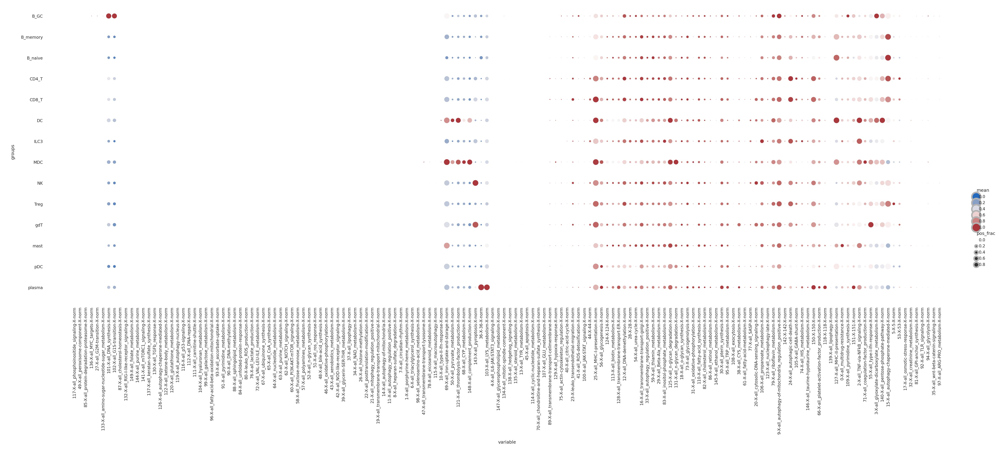

In [191]:
# Create a dotplot with mean of pos frac as dot hue and pos frac as dot size
sns.set(font_scale=0.25)
sns.set_style('white')
g = sns.relplot(
    data=df_frac_flat,
    x="variable", y="groups", hue="mean", size="pos_frac",
    palette="vlag", edgecolor=".7",
    height=3, aspect=3,sizes=(0, 15),
)
g.despine(left=True, bottom=True)
g.ax.margins(.02)
for label in g.ax.get_xticklabels():
    label.set_rotation(90)
for artist in g.legend.legendHandles:
    artist.set_edgecolor(".7")
figure_save_path_spec = figure_save_path+'Bassez_SPECTRA'+'_'+'dotplot_cell_types_global.svg'
plt.savefig(figure_save_path_spec,dpi=300)
print('saved to:',figure_save_path_spec)

In [192]:
metabolic_factors = ['3-X-all_glyoxylate-dicarboxylate_metabolism-X-norm',
 '6-X-all_triacylglycerol_synthesis-X-norm',
 '8-X-all_heparan-sulfate_degradation-X-norm',
 '11-X-all_autophagy_regulation_positive-X-norm',
 '13-X-all_TYR_metabolism-X-norm',
 '14-X-all_autophagy-of-mitochondria-X-norm',
 '15-X-all_autophagy-chaperone-mediated-X-norm',
 '16-X-all_transmembrane-transport-golgi-X-norm',
 '17-X-all_osmotic-stress-response-X-norm',
 '18-X-all_o-glycan_synthesis-X-norm',
 '19-X-all_transmembrane-transport-mitochondrial-X-norm',
 '21-X-all_mitophagy_regulation_positive-X-norm',
 '22-X-all_posttranslation-modification-X-norm',
 '24-X-all_autophagic-cell-death-X-norm',
 '29-X-all_Beta-Ala_metabolism-X-norm',
 '30-X-all_pterin_synthesis-X-norm',
 '31-X-all_oxidative-phosphorylation-X-norm',
 '32-X-all_creatinine_metabolism-X-norm',
 '33-X-all_autophagy_regulation_positive-X-norm',
 '34-X-all_NAD_metabolism-X-norm',
 '37-X-all_lipophagy-X-norm',
 '38-X-all_CYS_metabolism-X-norm',
 '39-X-all_glycerin-SER-THR_metabolism-X-norm',
 '40-X-all_citric-acid-cycle-X-norm',
 '41-X-all_ROS-detoxification-X-norm',
 '42-X-all_NOD-like-receptor_signaling-X-norm',
 '43-X-all_xenobiotics_metabolism-X-norm',
 '46-X-all_oxidative-phosphorylation-X-norm',
 '47-X-all_transmembrane-transport-lysosome-X-norm',
 '48-X-all_bile-acid_synthesis-X-norm',
 '49-X-all_peroxisome-component-X-norm',
 '50-X-all_pyruvate_metabolism-X-norm',
 '51-X-all_ros_response-X-norm',
 '52-X-all_n-glycan_synthesis-X-norm',
 '54-X-all_urea-cycle-X-norm',
 '56-X-all_glycogenesis-X-norm',
 '57-X-all_polyamines_metabolism-X-norm',
 '58-X-all_fructose-mannose_metabolism-X-norm',
 '59-X-all_thiamin_metabolism-X-norm',
 '60-X-all_PI3K-AKT-mTOR_signaling-X-norm',
 '61-X-all_fatty-acid-metabolism-X-norm',
 '62-X-all_NOTCH_signaling-X-norm',
 '63-X-all_purine_metabolism-X-norm',
 '64-X-all_nucleotide_metabolism-X-norm',
 '65-X-all_CoA_synthesis-X-norm',
 '66-X-all_platelet-activation-factor_production-X-norm',
 '67-X-all_ubiquinone_synthesis-X-norm',
 '68-X-all_CYP_metabolism-X-norm',
 '69-X-all_iron-uptake-and-storage-X-norm',
 '70-X-all_chondroitine-and-heparan-sulfate_synthesis-X-norm',
 '71-X-all_coagulation-factor_production-X-norm',
 '72-X-all_VAL-LEU-ILE_metabolism-X-norm',
 '73-X-all_glycogenolysis-X-norm',
 '74-X-all_HIS_metabolism-X-norm',
 '76-X-all_lactate_production-X-norm',
 '78-X-all_eicosanoid_metabolism-X-norm',
 '79-X-all_riboflavin_metabolism-X-norm',
 '80-X-leuko_ROS_production-X-norm',
 '81-X-all_GPI-anchor_synthesis-X-norm',
 '82-X-all_cholesterol_metabolism-X-norm',
 '83-X-all_inositol-phosphate_metabolism-X-norm',
 '84-X-all_unfolded-protein-response-X-norm',
 '85-X-all_protein-degradation-proteasome-X-norm',
 '86-X-all_retinol_metabolism-X-norm',
 '87-X-all_cholesterol-homeostasis-X-norm',
 '88-X-all_sphingolipid_metabolism-X-norm',
 '89-X-all_transmembrane-transport-cellmembrane-X-norm',
 '91-X-all_pyrimidine_metabolism-X-norm',
 '93-X-all_ascorbate-uptake-X-norm',
 '94-X-all_glycolysis-X-norm',
 '95-X-all_TRP_metabolism-X-norm',
 '96-X-all_fatty-acid-beta-oxidation-mitochondrial-X-norm',
 '97-X-all_ARG-PRO_metabolism-X-norm',
 '98-X-all_selenoamino-acid_metabolism-X-norm',
 '99-X-all_galactose_metabolism-X-norm',
 '101-X-all_DNA_synthesis-X-norm',
 '103-X-all_LYS_metabolism-X-norm',
 '104-X-all_hyaluronan_metabolism-X-norm',
 '105-X-all_GABA-shunt-X-norm',
 '106-X-all_propanoate_metabolism-X-norm',
 '107-X-all_GLU_metabolism-X-norm',
 '108-X-all_exocytosis-X-norm',
 '109-X-all_pyrimidine_synthesis-X-norm',
 '110-X-all_fatty-acid_synthesis-X-norm',
 '111-X-all_carnitine-shuttle-X-norm',
 '113-X-all_biotin_metabolism-X-norm',
 '114-X-all_cyclic-nucleotide_metabolism-X-norm',
 '115-X-all_macroautophagy-X-norm',
 '119-X-all_autophagy-nucleus-X-norm',
 '120-X-all_glutathione_metabolism-X-norm',
 '121-X-all_thrombolysis-factor_production-X-norm',
 '122-X-all_ketone-body_metabolism-X-norm',
 '123-X-all_nucleophagy-late-X-norm',
 '125-X-all_n-glycan_degradation-X-norm',
 '126-X-all_autophagy-chaperone-mediated-X-norm',
 '128-X-all_transmembrane-transport-ER-X-norm',
 '129-X-all_hypoxia-response-X-norm',
 '131-X-all_n-glycan_degradation-X-norm',
 '135-X-all_steroid_metabolism-X-norm',
 '137-X-all_keratan-sulfate_synthesis-X-norm',
 '139-X-all_lipophagy-X-norm',
 '140-X-all_pentose-phosphate-pathway-X-norm',
 '141-X-all_mTORC1_signaling-X-norm',
 '144-X-all_purine_metabolism-X-norm',
 '145-X-all_ethanol_metabolism-X-norm',
 '146-X-all_taurine-hypotaurine_metabolism-X-norm',
 '147-X-all_glycerophospholipid_metabolism-X-norm',
 '148-X-all_complement_production-X-norm',
 '149-X-all_folate_metabolism-X-norm']

In [193]:
df_frac_flat_metabolic = df_frac_flat[df_frac_flat['variable'].isin(metabolic_factors)]

In [194]:
#remove zeros
df_list = []

for i in set(df_frac_flat_metabolic['variable']):
    df_subset = df_frac_flat_metabolic[df_frac_flat_metabolic['variable']==i]
    if (df_subset['pos_frac']<0.01).all() ==False:
        df_list.append(df_subset)
df_frac_flat_metabolic = pd.concat(df_list)

saved to: /data/peer/wallet/Jupyter/SPADE_Peer_validation/figures/Bassez_SPECTRA_dotplot_cell_types_global_metabolic.svg


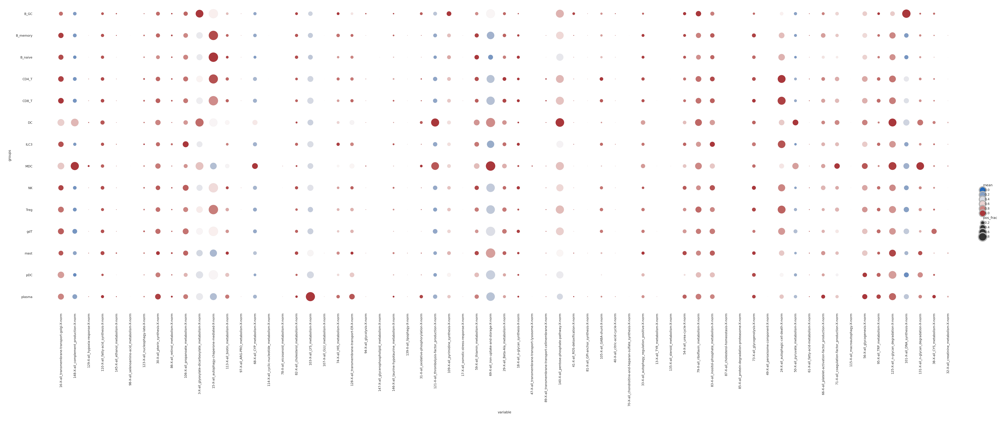

In [196]:
# Create a dotplot with mean of pos frac as dot hue and pos frac as dot size
sns.set(font_scale=0.25)
sns.set_style('white')
g = sns.relplot(
    data=df_frac_flat_metabolic,
    x="variable", y="groups", hue="mean", size="pos_frac",
    palette="vlag", edgecolor=".7",
    height=4, aspect=3,sizes=(0, 70),
)
g.despine(left=True, bottom=True)
g.ax.margins(.02)
for label in g.ax.get_xticklabels():
    label.set_rotation(90)
for artist in g.legend.legendHandles:
    artist.set_edgecolor(".7")
figure_save_path_spec = figure_save_path+'Bassez_SPECTRA'+'_'+'dotplot_cell_types_global_metabolic.svg'
plt.savefig(figure_save_path_spec,dpi=300)
print('saved to:',figure_save_path_spec)

#### scHPF

In [133]:
#get gene programs
metabolic_factors = list(adata_scHPF.obs.columns[adata_scHPF.obs.columns.isin(list(adata_scHPF.uns['scHPF_markers_global'].keys()))])


In [134]:
#The SPECTRA loadings are generally bimodal. The lower mode can be assumed to be non-expression while the 
#upper mode can be assumed to be expression of this factor. While the lower mode is generally close to zero it 
#is not exactly 0. here we will calculate the positive fraction of cells for different factors to find a good
#threshold above the lower mode but below the higher mode of the factor loadings
#calculate pos frac for diferent thresholds to find a rational threshold for defining the zero fraction

#set everything below threshold 0
thresholds_to_test =[0,0.01,0.02,0.03,0.04,0.05,0.06,0.07,0.08,0.09,0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9,1,2,3,4,5,6,7,8,9,10]

out_df = pd.DataFrame()

for thresh in thresholds_to_test:
    plotting_df = adata_scHPF.obs[metabolic_factors]
    plotting_df_thresh = plotting_df.applymap(lambda x: 0 if x < thresh else x)
    plotting_df_thresh_group = plotting_df_thresh

    df = plotting_df_thresh_group.copy()
    df_frac = pd.DataFrame()

    #calculate positive fraction per gene program and cell type
    for i in df.columns:
        df['sign'] = np.sign(df[i])
        allzero  = df['sign'] == 0
        nonezero  = df['sign'] != 0
        if allzero.all() ==False and nonezero.all()==False:
            pos_cells = df.sign.value_counts()
            pos_frac = pos_cells[1]/(pos_cells[0]+pos_cells[1])
            out_df.loc[thresh,i] = pos_frac
        elif nonezero.all()==True:
            #print('for',i,'no negative cells were detected, setting positive fraction to 1')
            out_df.loc[thresh,i] = 1
        elif allzero.all()==True:
            #print('for',i,'no positive cells were detected, setting positive fraction to 0')
            out_df.loc[thresh,i] = 0

out_df      

,scHPF_0,scHPF_1,scHPF_2,scHPF_3,scHPF_4,scHPF_5,scHPF_6,scHPF_7,scHPF_8,scHPF_9,...,scHPF_90,scHPF_91,scHPF_92,scHPF_93,scHPF_94,scHPF_95,scHPF_96,scHPF_97,scHPF_98,scHPF_99
0.00,1.000000,1.000000,1.000000,1.00000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.00000,1.000000,1.000000
0.01,1.000000,1.000000,1.000000,1.00000,0.251617,0.411565,1.000000,0.999990,0.661854,1.000000,...,0.659953,1.000000,0.715940,0.388891,1.000000,1.000000,0.919960,1.00000,0.537680,0.999990
0.02,1.000000,1.000000,1.000000,1.00000,0.239672,0.366359,1.000000,0.999990,0.165967,1.000000,...,0.361025,1.000000,0.157199,0.381564,1.000000,1.000000,0.364377,1.00000,0.343480,0.996914
0.03,1.000000,1.000000,1.000000,1.00000,0.234879,0.358317,1.000000,0.999990,0.159304,1.000000,...,0.355344,1.000000,0.148217,0.372245,1.000000,1.000000,0.323677,1.00000,0.339086,0.963296
0.04,1.000000,1.000000,0.999990,1.00000,0.230281,0.351011,1.000000,0.999980,0.156249,0.999990,...,0.352094,1.000000,0.145561,0.360913,0.999990,1.000000,0.320755,1.00000,0.334938,0.831193
0.05,0.999990,0.999990,0.999990,0.99999,0.225959,0.344359,0.999990,0.999847,0.153255,0.999990,...,0.349816,0.999990,0.142914,0.346781,0.999990,0.999990,0.318639,0.99999,0.330666,0.589273
0.06,0.999990,0.999990,0.999990,0.99999,0.221800,0.338504,0.999990,0.999142,0.150312,0.999990,...,0.347312,0.999990,0.140359,0.331637,0.999990,0.999990,0.317096,0.99999,0.326742,0.352125
0.07,0.999990,0.999990,0.999990,0.99999,0.217733,0.332976,0.999990,0.997578,0.147308,0.999990,...,0.344768,0.999990,0.137723,0.316800,0.999990,0.999990,0.315267,0.99999,0.322492,0.257370
0.08,0.999990,0.999990,0.999990,0.99999,0.213339,0.327846,0.999990,0.994441,0.144406,0.999990,...,0.341978,0.999990,0.135097,0.301636,0.999990,0.999990,0.312886,0.99999,0.318496,0.229934
0.09,0.999990,0.999990,0.999990,0.99999,0.208915,0.322665,0.999990,0.980493,0.140891,0.999990,...,0.339332,0.999990,0.132348,0.287024,0.999990,0.999990,0.310209,0.99999,0.314245,0.220829


In [ ]:
#plot pos fractions for different thresholds
sns.set(font_scale = 0.5) # if error matplotlib has no attribute DivergingNorm appears update Matplotlib
h = sns.clustermap(out_df,
               cmap='bwr', col_cluster=False, row_cluster=False, figsize=(25,10), vmax=1,center=0.5,vmin=0, z_score= None)


In [136]:
#calculate cell type means of pos_frac
thresh = 0.1 #everything below will be considere nonexpression
group_obs = 'annotation_SPADE_1' #obs varaiable for grouping


plotting_df = adata_scHPF.obs[metabolic_factors]
plotting_df_thresh = plotting_df.applymap(lambda x: np.nan if x < thresh else x)
plotting_df_thresh_group = plotting_df_thresh
plotting_df_thresh_group['groups'] = adata_scHPF.obs[group_obs]
df_means = plotting_df_thresh_group.groupby('groups').mean() #by default this ingnores nan --> only mean of pos. frac will be calculated


In [137]:
#normalize df to max

normalized_series = []

for i in df_means.columns:
    normalized_series.append(df_means[i]/ np.max(df_means[i]))

normalized_means  = pd.concat(normalized_series,axis=1)
normalized_means


,scHPF_0,scHPF_1,scHPF_2,scHPF_3,scHPF_4,scHPF_5,scHPF_6,scHPF_7,scHPF_8,scHPF_9,...,scHPF_90,scHPF_91,scHPF_92,scHPF_93,scHPF_94,scHPF_95,scHPF_96,scHPF_97,scHPF_98,scHPF_99
groups,,,,,,,,,,,,,,,,,,,,,
B_GC,0.977255,0.982178,0.937834,0.982226,0.157851,1.000000,0.982128,0.678140,0.037260,0.944863,...,0.344981,0.979996,0.045811,0.056607,0.936751,0.980222,0.403966,0.982226,1.000000,0.738543
B_memory,0.991671,0.996542,0.970645,0.996551,0.151384,0.355527,0.996655,0.871110,0.030681,0.981162,...,1.000000,0.994472,0.047735,0.066502,0.965384,0.995182,0.615352,0.996551,0.732716,0.841321
B_naive,1.000000,1.000000,0.973021,1.000000,0.102456,0.248089,1.000000,0.617896,0.024965,0.972992,...,0.949291,1.000000,0.038151,0.062987,0.978854,1.000000,0.708001,1.000000,0.351688,0.645803
CD4_T,0.985888,0.989679,0.958525,0.989481,0.090040,0.415417,0.990943,0.586487,0.027672,0.977941,...,0.680190,0.989368,0.027599,0.062841,0.953325,0.988769,0.538666,0.989481,0.351180,0.897205
CD8_T,0.991036,0.994935,0.960698,0.994684,0.089332,0.338114,0.995401,0.577121,0.024421,0.976500,...,0.733658,0.995390,0.028254,0.062448,0.951470,0.993840,0.675468,0.994684,0.621867,0.758367
DC,0.941812,0.949406,0.905579,0.946750,1.000000,0.161939,0.946774,0.515807,0.025591,0.910893,...,0.568551,0.944674,0.069767,0.297422,0.896024,0.945402,0.534594,0.946750,0.209674,1.000000
ILC3,0.983084,0.987987,1.000000,0.988021,0.196319,0.267130,0.987953,0.568625,0.086975,1.000000,...,0.888037,0.985845,0.105382,0.066531,1.000000,0.986043,0.409443,0.988021,0.395866,0.689284
MDC,0.970594,0.975688,0.936631,0.974955,0.675300,0.217383,0.974922,0.439414,0.027732,0.944513,...,0.547903,0.973075,0.030011,1.000000,0.922520,0.973531,0.810566,0.974955,0.317959,0.499900
NK,0.993142,0.997604,0.962099,0.996489,0.127213,0.324015,0.998443,0.599468,0.036086,0.987106,...,0.932536,0.994403,0.044987,0.061927,0.952048,0.994553,0.679923,0.996489,0.680223,0.757160


In [138]:
#replace nans with 0s (bc nans are the negative fraction)
df_means_nonan = normalized_means.fillna(0)

In [ ]:
#plot
sns.set(font_scale = 0.5) # if error matplotlib has no attribute DivergingNorm appears update Matplotlib
h = sns.clustermap(df_means_nonan,
               cmap='bwr', col_cluster=True, figsize=(25,10), vmax=1,center=0.5,vmin=0, z_score= None)


In [140]:
#extract reordered columns

reordered_rows = []
for i in h.dendrogram_col.reordered_ind:
    reordered_rows.append(df_means_nonan.columns[i])
 

In [141]:
#calculate pos frac

#set everything below threshold 0
plotting_df = adata_scHPF.obs[metabolic_factors]
plotting_df_thresh = plotting_df.applymap(lambda x: 0 if x < thresh else x)
plotting_df_thresh_group = plotting_df_thresh
plotting_df_thresh_group['groups'] = adata_scHPF.obs[group_obs]

df = plotting_df_thresh_group.copy()
df_frac = pd.DataFrame()

#calculate positive fraction per gene program and cell type
for i in df.drop(columns='groups').columns:
    df['sign'] = np.sign(df[i])
    allzero  = df['sign'] == 0
    nonezero  = df['sign'] != 0
    if allzero.all() ==False and nonezero.all()==False:
        pos_cells = df.groupby('groups').sign.value_counts()
        pos_frac = pos_cells.unstack()[1]/(pos_cells.unstack()[0]+pos_cells.unstack()[1])
        df_frac[i] = pos_frac
    elif nonezero.all()==True:
        print('for',i,'no negative cells were detected, setting positive fraction to 1')
        df_frac[i] = [1]*(len(df.groupby('groups')))
    elif allzero.all()==True:
        print('for',i,'no positive cells were detected, setting positive fraction to 0')
        df_frac[i] = [0]* (len(df.groupby('groups')))

df_frac

for scHPF_77 no negative cells were detected, setting positive fraction to 1


,scHPF_0,scHPF_1,scHPF_2,scHPF_3,scHPF_4,scHPF_5,scHPF_6,scHPF_7,scHPF_8,scHPF_9,...,scHPF_90,scHPF_91,scHPF_92,scHPF_93,scHPF_94,scHPF_95,scHPF_96,scHPF_97,scHPF_98,scHPF_99
groups,,,,,,,,,,,,,,,,,,,,,
B_GC,NaN,NaN,NaN,NaN,0.221719,0.579186,NaN,0.975113,0.108597,NaN,...,0.074661,NaN,0.128959,0.140271,NaN,NaN,0.307692,NaN,0.834842,0.110860
B_memory,0.999802,0.999802,0.999802,0.999802,0.209463,0.073649,0.999802,0.996634,0.110671,0.999802,...,0.438725,0.999802,0.197783,0.208474,0.999802,0.999802,0.313799,0.999802,0.281528,0.234409
B_naive,NaN,NaN,NaN,NaN,0.087824,0.024608,NaN,0.999576,0.069580,NaN,...,0.159525,NaN,0.149767,0.138311,NaN,NaN,0.402206,NaN,0.234196,0.184132
CD4_T,NaN,NaN,NaN,NaN,0.083311,0.471746,NaN,0.978001,0.144429,NaN,...,0.444982,NaN,0.065339,0.160192,NaN,NaN,0.247453,NaN,0.333901,0.257833
CD8_T,NaN,NaN,NaN,NaN,0.077870,0.309757,NaN,0.996868,0.122506,NaN,...,0.386594,NaN,0.062365,0.164103,NaN,NaN,0.280000,NaN,0.319280,0.233297
DC,NaN,NaN,NaN,NaN,0.890244,0.021243,NaN,0.566090,0.152636,NaN,...,0.083006,NaN,0.660897,0.792683,NaN,NaN,0.460661,NaN,0.208497,0.145555
ILC3,NaN,NaN,NaN,NaN,0.658537,0.058537,NaN,0.985366,0.834146,NaN,...,0.614634,NaN,0.409756,0.229268,NaN,NaN,0.175610,NaN,0.292683,0.243902
MDC,NaN,NaN,NaN,NaN,0.747280,0.008985,NaN,0.927382,0.107567,NaN,...,0.020359,NaN,0.240603,0.869189,NaN,NaN,0.445928,NaN,0.213567,0.131141
NK,NaN,NaN,NaN,NaN,0.322618,0.096437,NaN,0.999225,0.225407,NaN,...,0.428737,NaN,0.237413,0.173509,NaN,NaN,0.233153,NaN,0.351278,0.230442


In [142]:
#reorder dataframe
df_frac = df_frac[reordered_rows]
df_means_nonan = df_means_nonan[reordered_rows]

In [143]:
#melt dataframe containing means of pos fraction for plotting
df_means_flat  = df_means_nonan.melt(ignore_index=False,value_name='mean')
df_means_flat['groups'] = df_means_flat.index
df_means_flat.index = df_means_flat.index.str.cat(df_means_flat['variable'],sep = '-X-')
df_means_flat

,variable,mean,groups
groups,,,
B_GC-X-scHPF_35,scHPF_35,0.954406,B_GC
B_memory-X-scHPF_35,scHPF_35,0.930647,B_memory
B_naive-X-scHPF_35,scHPF_35,0.931564,B_naive
CD4_T-X-scHPF_35,scHPF_35,0.927601,CD4_T
CD8_T-X-scHPF_35,scHPF_35,0.927909,CD8_T
...,...,...,...
Treg-X-scHPF_45,scHPF_45,0.037039,Treg
gdT-X-scHPF_45,scHPF_45,0.040971,gdT
mast-X-scHPF_45,scHPF_45,0.035319,mast


In [144]:
#melt dataframe containing pos fraction for plotting
df_frac_flat  = df_frac.melt(ignore_index=False,value_name='pos_frac')
df_frac_flat['groups'] = df_frac_flat.index
df_frac_flat.index = df_frac_flat.index.str.cat(df_frac_flat['variable'],sep = '-X-')
df_frac_flat

,variable,pos_frac,groups
groups,,,
B_GC-X-scHPF_35,scHPF_35,NaN,B_GC
B_memory-X-scHPF_35,scHPF_35,0.999802,B_memory
B_naive-X-scHPF_35,scHPF_35,NaN,B_naive
CD4_T-X-scHPF_35,scHPF_35,NaN,CD4_T
CD8_T-X-scHPF_35,scHPF_35,NaN,CD8_T
...,...,...,...
Treg-X-scHPF_45,scHPF_45,0.186199,Treg
gdT-X-scHPF_45,scHPF_45,0.357187,gdT
mast-X-scHPF_45,scHPF_45,0.074830,mast


In [145]:
#add means of pos fraction to df containing pos fractions
df_frac_flat['mean'] = df_means_flat['mean']
df_frac_flat

,variable,pos_frac,groups,mean
groups,,,,
B_GC-X-scHPF_35,scHPF_35,NaN,B_GC,0.954406
B_memory-X-scHPF_35,scHPF_35,0.999802,B_memory,0.930647
B_naive-X-scHPF_35,scHPF_35,NaN,B_naive,0.931564
CD4_T-X-scHPF_35,scHPF_35,NaN,CD4_T,0.927601
CD8_T-X-scHPF_35,scHPF_35,NaN,CD8_T,0.927909
...,...,...,...,...
Treg-X-scHPF_45,scHPF_45,0.186199,Treg,0.037039
gdT-X-scHPF_45,scHPF_45,0.357187,gdT,0.040971
mast-X-scHPF_45,scHPF_45,0.074830,mast,0.035319


In [146]:
reordered_rows

['scHPF_35',
 'scHPF_77',
 'scHPF_86',
 'scHPF_32',
 'scHPF_87',
 'scHPF_70',
 'scHPF_11',
 'scHPF_82',
 'scHPF_24',
 'scHPF_83',
 'scHPF_20',
 'scHPF_54',
 'scHPF_63',
 'scHPF_67',
 'scHPF_0',
 'scHPF_84',
 'scHPF_48',
 'scHPF_28',
 'scHPF_46',
 'scHPF_25',
 'scHPF_1',
 'scHPF_22',
 'scHPF_79',
 'scHPF_51',
 'scHPF_6',
 'scHPF_74',
 'scHPF_31',
 'scHPF_97',
 'scHPF_76',
 'scHPF_33',
 'scHPF_3',
 'scHPF_10',
 'scHPF_91',
 'scHPF_95',
 'scHPF_23',
 'scHPF_18',
 'scHPF_38',
 'scHPF_26',
 'scHPF_56',
 'scHPF_65',
 'scHPF_39',
 'scHPF_80',
 'scHPF_49',
 'scHPF_41',
 'scHPF_94',
 'scHPF_9',
 'scHPF_69',
 'scHPF_2',
 'scHPF_30',
 'scHPF_53',
 'scHPF_42',
 'scHPF_68',
 'scHPF_71',
 'scHPF_75',
 'scHPF_52',
 'scHPF_96',
 'scHPF_44',
 'scHPF_98',
 'scHPF_50',
 'scHPF_64',
 'scHPF_90',
 'scHPF_40',
 'scHPF_7',
 'scHPF_58',
 'scHPF_99',
 'scHPF_29',
 'scHPF_66',
 'scHPF_88',
 'scHPF_17',
 'scHPF_47',
 'scHPF_78',
 'scHPF_57',
 'scHPF_89',
 'scHPF_12',
 'scHPF_5',
 'scHPF_21',
 'scHPF_85',
 'scHPF

saved to: /data/peer/wallet/Jupyter/SPADE_Peer_validation/figures/Bassez_scHPF_dotplot_cell_types_global.svg


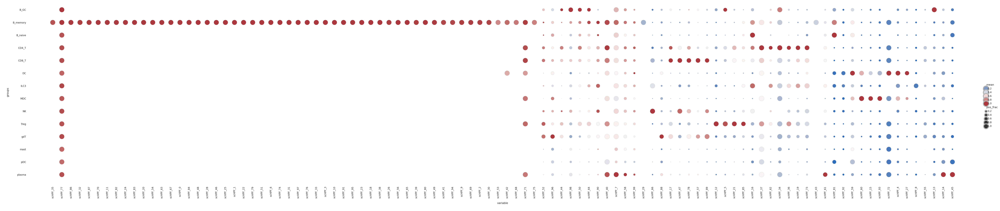

In [147]:
# Create a dotplot with mean of pos frac as dot hue and pos frac as dot size
sns.set(font_scale=0.25)
sns.set_style('white')
g = sns.relplot(
    data=df_frac_flat,
    x="variable", y="groups", hue="mean", size="pos_frac",
    palette="vlag", edgecolor=".7",
    height=3, aspect=5,sizes=(0, 30),
)
g.despine(left=True, bottom=True)
g.ax.margins(.02)
for label in g.ax.get_xticklabels():
    label.set_rotation(90)
for artist in g.legend.legendHandles:
    artist.set_edgecolor(".7")
figure_save_path_spec = figure_save_path+'Bassez_scHPF'+'_'+'dotplot_cell_types_global.svg'
plt.savefig(figure_save_path_spec,dpi=300)
print('saved to:',figure_save_path_spec)

In [ ]:
adata_scHPF

In [ ]:
#all scHPF factors same overlap

sc.pl.tsne(adata_SPECTRA, color = ['annotation_SPADE_1'],palette=subtype_color_dict, 
           s = 3, cmap='Spectral_r', legend_fontsize = 10, vmin=0,
          save='Bassez_tsne_SPADE_annotation_1.svg')

In [ ]:
adata_SPECTRA

In [ ]:
#all scHPF factors same overlap

sc.pl.tsne(adata_SPECTRA, color = ['103-X-all_LYS_metabolism-X-norm'],palette=subtype_color_dict, 
           s = 3, cmap='Spectral_r', legend_fontsize = 10, vmin=0,
          save='Bassez_tsne_SPECTRA_LYS-met.svg')

In [ ]:
#all scHPF factors same overlap

sc.pl.tsne(adata_scHPF, color = ['annotation_SPADE_1','scHPF_27', 'scHPF_75', 'scHPF_90','scHPF_83','scHPF_64',
                                 'scHPF_40','scHPF_74','scHPF_49'], s = 3, cmap='Spectral_r', legend_fontsize = 10, vmin=0)

### compare this with SPECTRA, we found a highly plasma specific LYS factor there

In [21]:
SPECTRA_LYS = list(adata_SPECTRA.uns['SPADE_markers_global']['103-X-all_LYS_metabolism'])
SPECTRA_LYS

['BBOX1',
 'AASS',
 'SPCS2',
 'ALDH7A1',
 'TMLHE',
 'SLC7A1',
 'SPCS3',
 'SLC6A8',
 'SLC25A15',
 'PLPBP',
 'AADAT',
 'SPCS1',
 'PIPOX',
 'PYCR3',
 'SLC6A7',
 'PYCR2',
 'SLC7A2',
 'SLC3A1',
 'XBP1',
 'SEC11C',
 'SDF2L1',
 'HSP90B1',
 'HSPA5',
 'TPT1',
 'MYDGF',
 'PDIA6',
 'TMEM59',
 'SELENOS',
 'OSTC',
 'SSR3',
 'SEC61B',
 'SSR4',
 'SEC61G',
 'CANX',
 'PLPP5',
 'FKBP11',
 'DNAJB9',
 'HERPUD1',
 'TMED2',
 'NUCB2',
 'TRAM1',
 'SSR1',
 'ERLEC1',
 'SEC61A1',
 'FKBP2',
 'SERP1',
 'IGKC',
 'ITM2C',
 'ALDH2',
 'MTDH']

In [59]:
color_dict = {'ER-stress':'#FFFF00',
 'ER_protein_synthesis':'#1CE6FF',
 'ER_stress':'#FF34FF',
 'LYS_metabolism':'#FF4A46',
 'NFkB_signaling': '#008941',
 'Notch_signaling':'#006FA6',
 'Ras_signaling': '#A30059',
 'VitB6_metabolism': '#7A4900',
 'aberrant':'#0000A6',
 'adhesion':'#63FFAC',
 'autophagy': '#B79762',
 'calcium_signaling': '#004D43',
 'cell_cycle': '#8FB0FF',
 'chemotaxis':'#997D87',
 'cholesterol_metabolism':'#5A0007',
 'creatinine_metabolism': '#809693',
 'cytoskeleton': '#1B4400',
 'development': '#4FC601',
 'differentiation': '#3B5DFF',
 'disulfide_bond':'#4A3B53',
 'glutathione_metabolism':'#FF2F80',
 'glycolipid_metabolism':'#61615A',
 'hypoxia':'#BA0900',
 'ion_channel': '#6B7900',
 'lipid_metabolims':'#00C2A0',
 'marker':'#FFAA92',
 'non-coding': '#FF90C9',
 'phospholipid_metabolism': '#B903AA',
 'proliferation': '#D16100',
 'proline_metabolism': '#DDEFFF',
 'protein_glycosylation': '#000035',
 'protein_synthesis':'#7B4F4B',
 'signaling': '#A1C299',
 'survival': '#300018',
 'transcription': '#0AA6D8',
 'transcription_factor': '#013349',
 'unknown': '#00846F',
 'urea_cycle': '#372101'}


In [60]:
#which marker class of top plasma cell specific

marker_dict ={
    'BBOX1':'LYS_metabolism', 'AASS':'LYS_metabolism', 'SPCS2':'LYS_metabolism', 'ALDH7A1':'LYS_metabolism', 'TMLHE':'LYS_metabolism', 
              'SLC7A1':'LYS_metabolism', 
              'SPCS3':'LYS_metabolism',
       'SLC6A8':'creatinine_metabolism', 'SLC25A15':'urea_cycle', 'PLPBP':'VitB6_metabolism', 
              'AADAT':'LYS_metabolism', 'SPCS1':'LYS_metabolism', 'PIPOX':'LYS_metabolism', 'PYCR3':'proline_metabolism',
       'SLC6A7':'proline_metabolism', 'PYCR2':'proline_metabolism', 'SLC7A2':'LYS_metabolism', 'SLC3A1':'LYS_metabolism', 'XBP1':'ER_stress',
              'SEC11C':'ER_stress', 'SDF2L1':'ER_stress',
       'HSP90B1':'ER_stress', 'HSPA5':'ER_stress', 'TPT1':'proliferation', 'MYDGF':'proliferation', 
              'PDIA6':'ER_stress', 'TMEM59':'autophagy', 'SELENOS':'ER_stress',
       'OSTC':'protein_glycosylation', 'SSR3':'ER_stress', 'SEC61B':'ER_protein_synthesis', 'SSR4':'protein_glycosylation',
              'SEC61G':'ER_protein_synthesis', 'CANX':'protein_glycosylation', 'PLPP5':'phospholipid_metabolism',
       'FKBP11':'protein_synthesis', 'DNAJB9':'ER_stress', 'HERPUD1':'ER_stress', 'TMED2':'ER_protein_synthesis',
              'NUCB2':'transcription_factor', 'TRAM1':'protein_glycosylation', 'SSR1':'ER_protein_synthesis',
       'ERLEC1':'protein_glycosylation', 'SEC61A1':'protein_synthesis', 
              'FKBP2':'protein_synthesis', 'SERP1':'ER_stress', 'IGKC':'marker', 'ITM2C':'differentiation', 'ALDH2':'LYS_metabolism',
       'MTDH':'NFkB_signaling'}

In [61]:
len(set(marker_dict.keys()).intersection(set(adata_SPECTRA.uns['SPADE_markers_global']['103-X-all_LYS_metabolism'])))

50

In [62]:
#count categories
counts = []
labels=[]
marker_class = [marker_dict[x] for x in SPECTRA_LYS]

for i in set(marker_class):
    counts.append(marker_class.count(i))
    labels.append(i)

SPECTRA_pie_interpret.svg


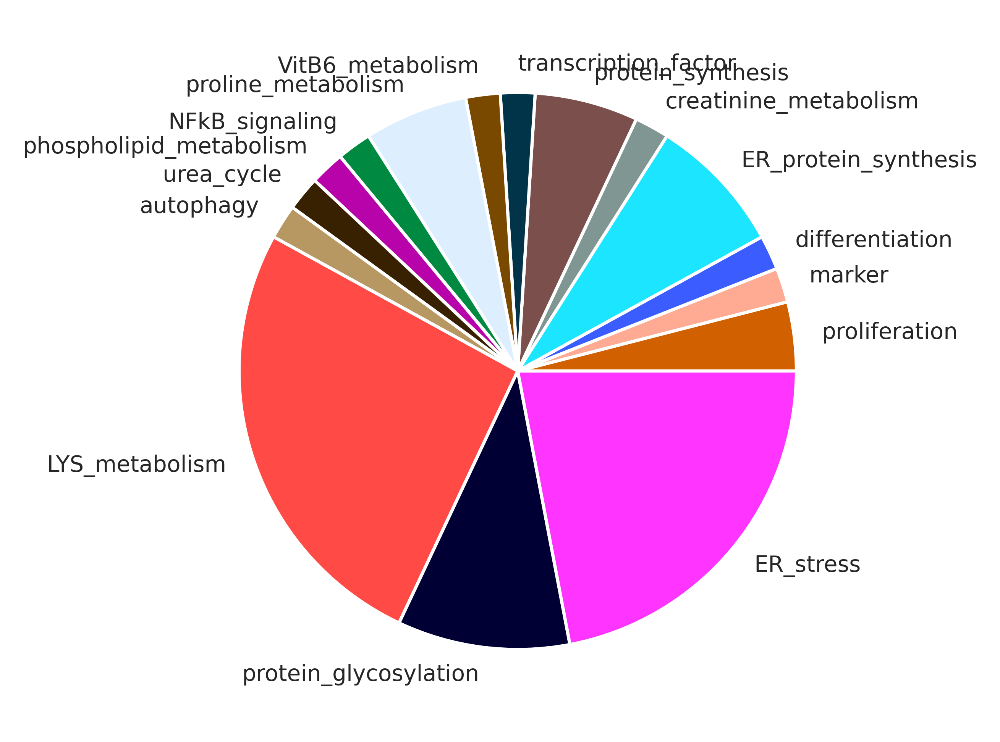

In [63]:
#plot
save_name= 'SPECTRA_pie_interpret.svg'
fig, ax = plt.subplots()
plt.pie(counts, labels = labels,colors=[color_dict[x] for x in labels])
plt.savefig(figure_save_path+save_name)
print(save_name)

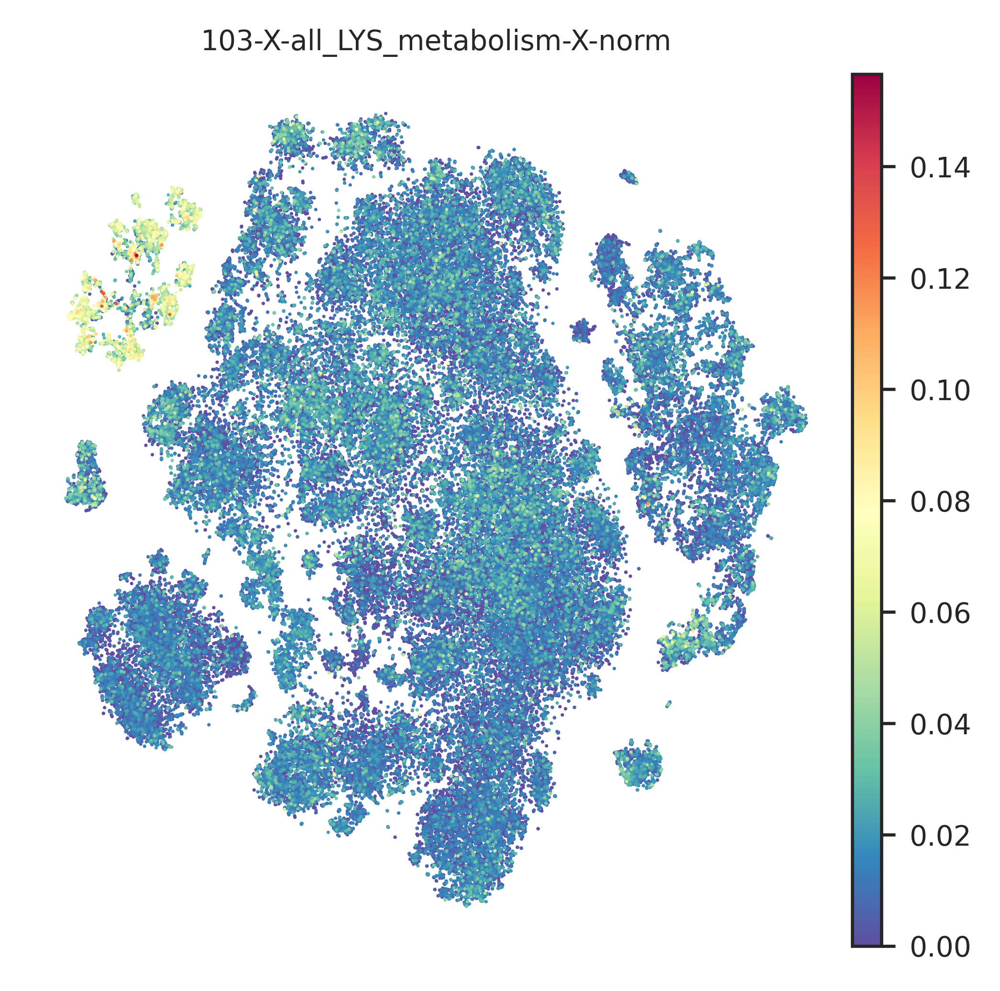

In [39]:
sc.pl.tsne(adata_SPECTRA, color = '103-X-all_LYS_metabolism-X-norm', s = 3, cmap='Spectral_r', legend_fontsize = 10,save='Bassez_103-X-all_LYS_metabolism-X-norm.svg', vmin=0)

## compare with scHPF

In [41]:
scHPF_LYS = list(adata_scHPF.uns['scHPF_markers_global']['scHPF_27'])
scHPF_LYS

['CCL17',
 'UBD',
 'CCL19',
 'ACHE',
 'IDO1',
 'AOC1',
 'CXCL9',
 'TIFAB',
 'NCCRP1',
 'LAD1',
 'FSCN1',
 'ANKRD22',
 'EBI3',
 'CSF2RA',
 'TFPI2',
 'PDCD1LG2',
 'CD1E',
 'SLC6A12',
 'SLC1A2',
 'RTN1',
 'RASSF4',
 'CLEC9A',
 'AL353608.3',
 'ALDH2',
 'GSN',
 'TUBB2B',
 'LAMP3',
 'CD80',
 'SERPINF2',
 'SERPINF1',
 'GUCY1B1',
 'PIPOX',
 'UPB1',
 'ENPP2',
 'CALHM6',
 'PLA2G4A',
 'ERC2',
 'SLC18A1',
 'CCND1',
 'CD40',
 'TMEM176A',
 'FBXO27',
 'CD274',
 'CFB',
 'TMEM176B',
 'TNFRSF11B',
 'GPT',
 'IL4I1',
 'LIPG',
 'ELOVL7']

In [51]:
adata_scHPF

AnnData object with n_obs × n_vars = 97863 × 19984
    obs: 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'batch', 'cohort', 'total_molecules', 'ID', 'age_rounded_up', 'postmenopause', 'TNM_version', 'T_prefix', 'T', 'T_suffix', 'N_prefix', 'N', 'N_suffix', 'M_prefix', 'M', 'M_suffix', 'HER2', 'ER', 'PR', 'CTX', 'KI67_precent_range_prePD1', 'KI67_precent_range_postPD1', 'TCR_clonotype_expansion', 'Bassez_nCount_RNA', 'Bassez_nFeature_RNA', 'Bassez_patient_id', 'Bassez_timepoint', 'Bassez_expansion', 'Bassez_BC_type', 'Bassez_cellType', 'Bassez_cellSubType', 'n_genes', 'percent_mito', 'n_counts', 'doublets', 'major_subsets', 'pheno_k10', 'pheno_k20', 'pheno_k30', 'pheno_k40', 'pheno_k50', 'pheno_k60', 'pheno_k70', 'pheno_k80', 'pheno_k90', 'pheno_k100', 'pheno_var_k10', 'pheno_var_k2

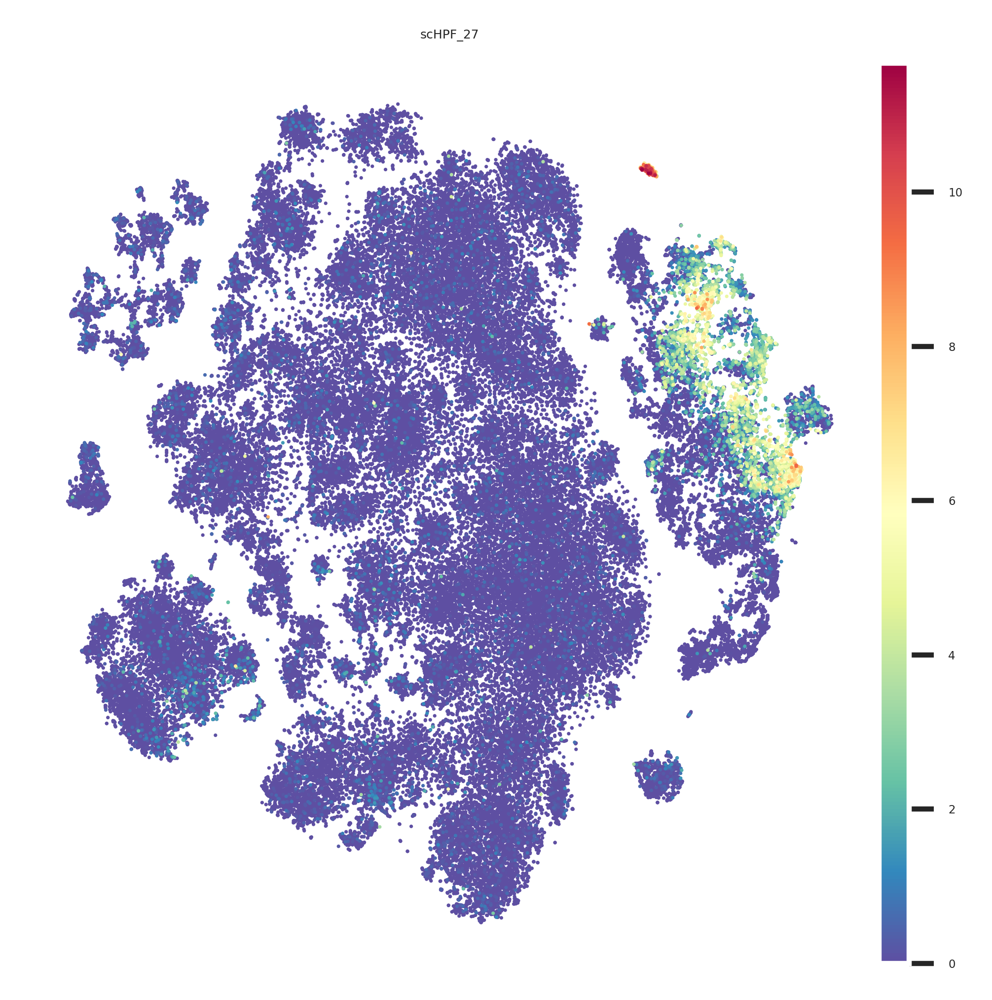

In [234]:
sc.pl.tsne(adata_scHPF, color = ['scHPF_27'], s = 3, cmap='Spectral_r', legend_fontsize = 10,save='Bassez_scHPF_27_LYS.svg', vmin=0)

In [52]:
scHPF_factors = ['scHPF_0', 'scHPF_1', 'scHPF_2', 'scHPF_3', 'scHPF_4', 'scHPF_5', 'scHPF_6', 'scHPF_7', 'scHPF_8', 'scHPF_9', 'scHPF_10', 'scHPF_11', 'scHPF_12', 'scHPF_13', 'scHPF_14', 'scHPF_15', 'scHPF_16', 'scHPF_17', 'scHPF_18', 'scHPF_19', 'scHPF_20', 'scHPF_21', 'scHPF_22', 'scHPF_23', 'scHPF_24', 'scHPF_25', 'scHPF_26', 'scHPF_27', 'scHPF_28', 'scHPF_29', 'scHPF_30', 'scHPF_31', 'scHPF_32', 'scHPF_33', 'scHPF_34', 'scHPF_35', 'scHPF_36', 'scHPF_37', 'scHPF_38', 'scHPF_39', 'scHPF_40', 'scHPF_41', 'scHPF_42', 'scHPF_43', 'scHPF_44', 'scHPF_45', 'scHPF_46', 'scHPF_47', 'scHPF_48', 'scHPF_49', 'scHPF_50', 'scHPF_51', 'scHPF_52', 'scHPF_53', 'scHPF_54', 'scHPF_55', 'scHPF_56', 'scHPF_57', 'scHPF_58', 'scHPF_59', 'scHPF_60', 'scHPF_61', 'scHPF_62', 'scHPF_63', 'scHPF_64', 'scHPF_65', 'scHPF_66', 'scHPF_67', 'scHPF_68', 'scHPF_69', 'scHPF_70', 'scHPF_71', 'scHPF_72', 'scHPF_73', 'scHPF_74', 'scHPF_75', 'scHPF_76', 'scHPF_77', 'scHPF_78', 'scHPF_79', 'scHPF_80', 'scHPF_81', 'scHPF_82', 'scHPF_83', 'scHPF_84', 'scHPF_85', 'scHPF_86', 'scHPF_87', 'scHPF_88', 'scHPF_89', 'scHPF_90', 'scHPF_91', 'scHPF_92', 'scHPF_93', 'scHPF_94', 'scHPF_95', 'scHPF_96', 'scHPF_97', 'scHPF_98', 'scHPF_99']

In [42]:
marker_dict = {'CCL17':'chemotaxis',
 'UBD':'other',
 'CCL19':'chemotaxis',
 'ACHE':'other',
 'IDO1':'immune-checkpoint',
 'AOC1':'metabolism',
 'CXCL9':'chemotaxis',
 'TIFAB':'other',
 'NCCRP1':'unknown',
 'LAD1':'extracellular_matrix',
 'FSCN1':'cytoskeleton',
 'ANKRD22':'unknown',
 'EBI3':'cytokine',
 'CSF2RA':'cytokine_receptor',
 'TFPI2':'coagulation',
 'PDCD1LG2':'immune-checkpoint',
 'CD1E':'antigen-presentation',
 'SLC6A12':'metabolism',
 'SLC1A2':'metabolism',
 'RTN1':'aberrant',
 'RASSF4':'other',
 'CLEC9A':'PAMPR',
 'AL353608.3':'non-coding',
 'ALDH2':'LYS_metabolism',
 'GSN':'cytoskeleton',
 'TUBB2B':'cytoskeleton',
 'LAMP3':'cytoskeleton',
 'CD80':'immune-checkpoint',
 'SERPINF2':'coagulation',
 'SERPINF1':'other',
 'GUCY1B1':'signaling',
 'PIPOX':'LYS_metabolism',
 'UPB1':'metabolism',
 'ENPP2':'extracellular_matrix',
 'CALHM6':'ion_channel',
 'PLA2G4A':'other',
 'ERC2':'other',
 'SLC18A1':'signaling',
 'CCND1':'cell_cycle',
 'CD40':'immune-checkpoint',
 'TMEM176A':'differentiation',
 'FBXO27':'other',
 'CD274':'immune-checkpoint',
 'CFB':'complement',
 'TMEM176B':'ubiquitin',
 'TNFRSF11B':'immune-checkpoint',
 'GPT':'metabolism',
 'IL4I1':'other',
 'LIPG':'lipid_metabolims',
 'ELOVL7':'lipid_metabolims'}

In [47]:
color_dict = { 'ER_protein_synthesis':'#1CE6FF',
 'ER_stress':'#FF34FF',
 'LYS_metabolism':'#FF4A46',
 'NFkB_signaling': '#008941',
 'Notch_signaling':'#006FA6',
 'Ras_signaling': '#A30059',
 'VitB6_metabolism': '#7A4900',
 'aberrant':'#0000A6',
 'adhesion':'#63FFAC',
 'autophagy': '#B79762',
 'calcium_signaling': '#004D43',
 'cell_cycle': '#8FB0FF',
 'chemotaxis':'#997D87',
 'cholesterol_metabolism':'#5A0007',
 'creatinine_metabolism': '#809693',
 'cytoskeleton': '#1B4400',
 'development': '#4FC601',
 'differentiation': '#3B5DFF',
 'disulfide_bond':'#4A3B53',
 'glutathione_metabolism':'#FF2F80',
 'glycolipid_metabolism':'#61615A',
 'hypoxia':'#BA0900',
 'ion_channel': '#6B7900',
 'lipid_metabolims':'#00C2A0',
 'marker':'#FFAA92',
 'non-coding': '#FF90C9',
              'PAMPR':'#f8a487',
 'phospholipid_metabolism': '#B903AA',
 'proliferation': '#D16100',
 'proline_metabolism': '#DDEFFF',
 'protein_glycosylation': '#000035',
 'protein_synthesis':'#7B4F4B',
 'signaling': '#A1C299',
 'survival': '#300018',
 'transcription': '#0AA6D8',
 'transcription_factor': '#013349',
 'unknown': '#00846F',
 'urea_cycle': '#372101',
             'cytokine':'#235f5f',
             'immune-checkpoint':'#f8b5be',
             'cytokine_receptor':'#eecbe1',
             'metabolism':'#757e36',
             'extracellular_matrix':'#1d2356',
             'coagulation':'#f8aca2',
             'antigen-presentation':'#1d2b59',
             'complement':'#396a58',
             'ubiquitin':'#8d8532',
             'other':'#134460'}


In [46]:
batlow_20[15]

'#134460'

In [49]:
#count categories
counts = []
labels=[]
marker_class = [marker_dict[x] for x in scHPF_LYS]

for i in set(marker_class):
    counts.append(marker_class.count(i))
    labels.append(i)

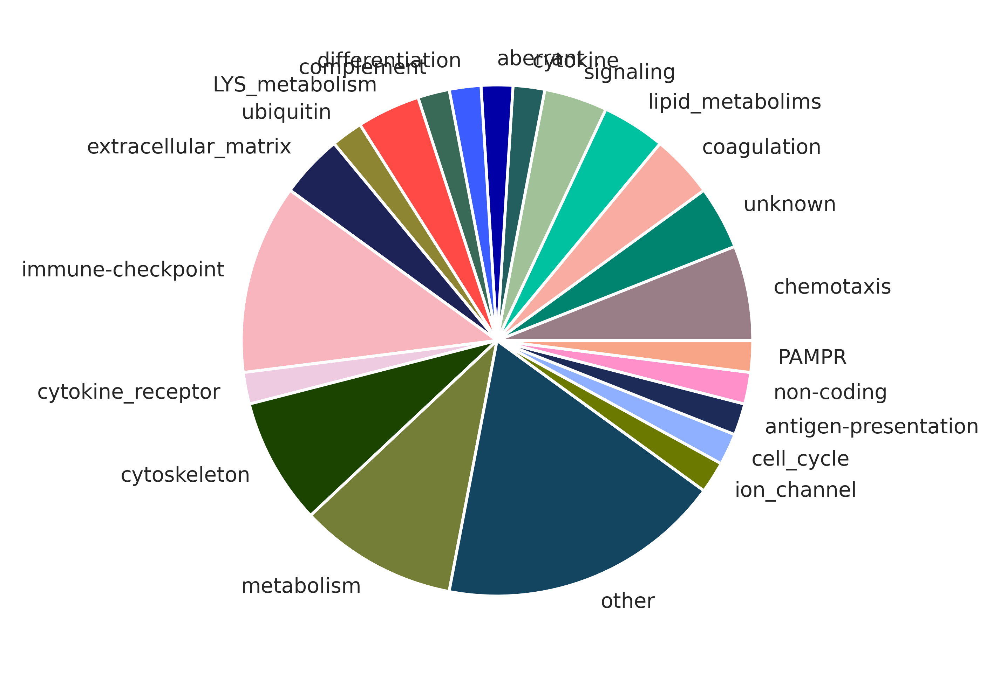

In [50]:
#plot
save_name = 'scHPF27_pie_interpret.svg'
fig, ax = plt.subplots()
plt.pie(counts, labels = labels,colors=[color_dict[x] for x in labels])
plt.savefig(figure_save_path+save_name)

In [69]:
scHPF_LYS = list(adata_scHPF.uns['scHPF_markers_global']['scHPF_45'])
scHPF_LYS

['IGLL5',
 'LINC02362',
 'AC012236.1',
 'AC233755.2',
 'TNFRSF17',
 'JSRP1',
 'FAM92B',
 'RASSF6',
 'BRSK1',
 'TXNDC5',
 'ITGA8',
 'DPEP1',
 'SDC1',
 'CHAC1',
 'SCNN1B',
 'DERL3',
 'AC233755.1',
 'MZB1',
 'IGHJ4',
 'AC007569.1',
 'AMPD1',
 'CLDN14',
 'IGHJ6',
 'AC141272.1',
 'IGKJ1',
 'JCHAIN',
 'AC106882.1',
 'AC093797.1',
 'FCRL5',
 'IGLJ3',
 'LINC02576',
 'SMPDL3B',
 'AC135068.2',
 'C4B',
 'IGLJ2',
 'LINC01485',
 'AC104699.1',
 'SPAG4',
 'E2F5',
 'IGKJ3',
 'LINC01055',
 'CCL25',
 'IGHJ5',
 'AC136616.2',
 'MYL2',
 'AC134981.1',
 'CPNE5',
 'DNAAF1',
 'IGKC',
 'B9D1']

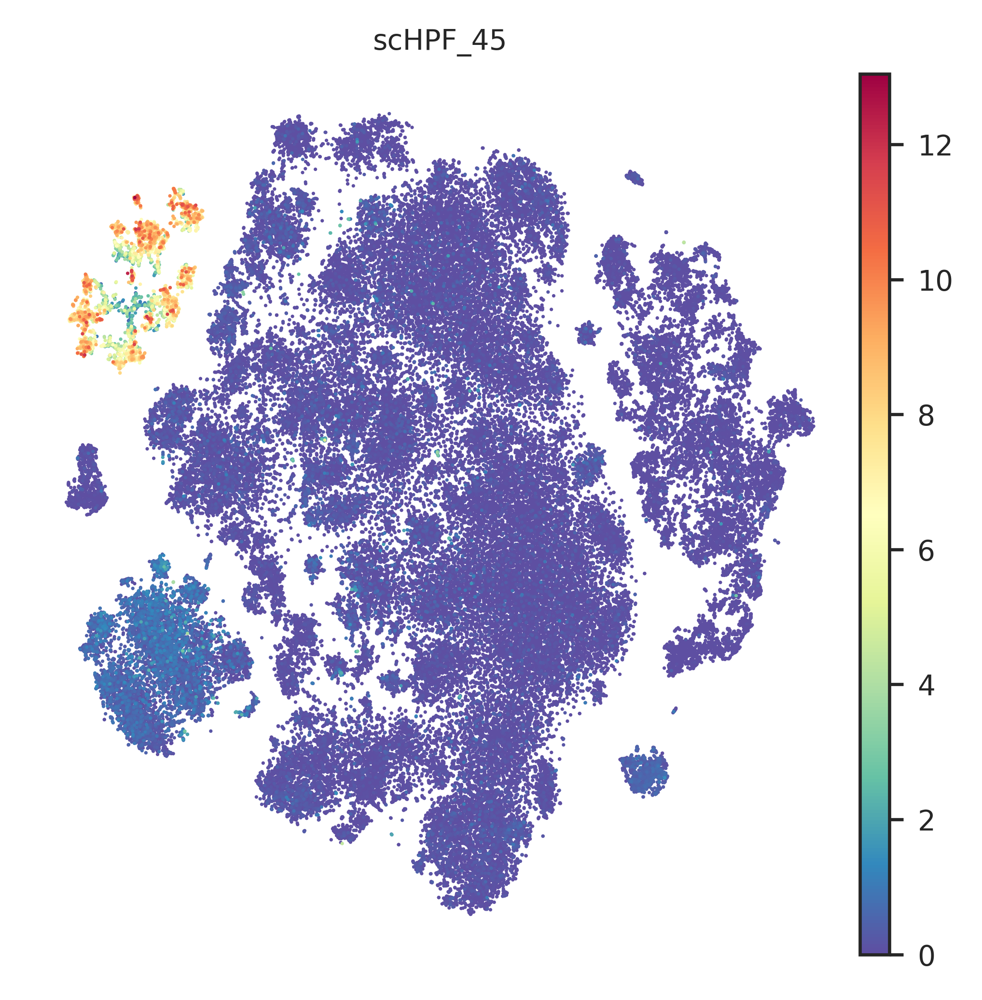

In [64]:
sc.pl.tsne(adata_scHPF, color = ['scHPF_45'], s = 3, cmap='Spectral_r', legend_fontsize = 10,save='Bassez_LYS_scHPF45.svg', vmin=0)

In [75]:
marker_dict = {'IGLL5':'marker',
 'LINC02362':'non-coding',
 'AC012236.1':'unknown',
 'AC233755.2':'unknown',
 'TNFRSF17':'immune-checkpoint',
 'JSRP1':'aberrant',
 'FAM92B':'cytoskeleton',
 'RASSF6':'Ras_signaling',
 'BRSK1':'cell_cycle',
 'TXNDC5':'ER_stress',
 'ITGA8': 'adhesion',
 'DPEP1':'metabolism',
 'SDC1':'marker',
 'CHAC1':'Notch_signaling',
 'SCNN1B':'ion_channel',
 'DERL3':'ER_stress',
 'AC233755.1':'unknown',
 'MZB1':'marker',
 'IGHJ4':'marker',
 'AC007569.1':'unknown',
 'AMPD1':'aberrant',
 'CLDN14': 'adhesion',
 'IGHJ6':'marker',
 'AC141272.1':'unknown',
 'IGKJ1':'marker',
 'JCHAIN':'marker',
 'AC106882.1':'unknown',
 'AC093797.1':'unknown',
 'FCRL5':'development',
 'IGLJ3':'marker',
 'LINC02576':'non-coding',
 'SMPDL3B':'glycolipid_metabolism',
 'AC135068.2':'unknown',
 'C4B':'other',
 'IGLJ2':'marker',
 'LINC01485':'non-coding',
 'AC104699.1':'unknown',
 'SPAG4':'other',
 'E2F5':'transcription_factor',
 'IGKJ3':'marker',
 'LINC01055':'non-coding',
 'CCL25':'chemotaxis',
 'IGHJ5':'marker',
 'AC136616.2':'unknown',
 'MYL2':'aberrant',
 'AC134981.1':'unknown',
 'CPNE5':'adhesion',
 'DNAAF1':'cytoskeleton',
 'IGKC':'marker',
 'B9D1':'cytoskeleton'}

In [76]:
color_dict = { 'ER_protein_synthesis':'#1CE6FF',
 'ER_stress':'#FF34FF',
 'LYS_metabolism':'#FF4A46',
 'NFkB_signaling': '#008941',
 'Notch_signaling':'#006FA6',
 'Ras_signaling': '#A30059',
 'VitB6_metabolism': '#7A4900',
 'aberrant':'#0000A6',
 'adhesion':'#63FFAC',
 'autophagy': '#B79762',
 'calcium_signaling': '#004D43',
 'cell_cycle': '#8FB0FF',
 'chemotaxis':'#997D87',
 'cholesterol_metabolism':'#5A0007',
 'creatinine_metabolism': '#809693',
 'cytoskeleton': '#1B4400',
 'development': '#4FC601',
 'differentiation': '#3B5DFF',
 'disulfide_bond':'#4A3B53',
 'glutathione_metabolism':'#FF2F80',
 'glycolipid_metabolism':'#61615A',
 'hypoxia':'#BA0900',
 'ion_channel': '#6B7900',
 'lipid_metabolims':'#00C2A0',
 'marker':'#FFAA92',
 'non-coding': '#FF90C9',
              'PAMPR':'#f8a487',
 'phospholipid_metabolism': '#B903AA',
 'proliferation': '#D16100',
 'proline_metabolism': '#DDEFFF',
 'protein_glycosylation': '#000035',
 'protein_synthesis':'#7B4F4B',
 'signaling': '#A1C299',
 'survival': '#300018',
 'transcription': '#0AA6D8',
 'transcription_factor': '#013349',
 'unknown': '#00846F',
 'urea_cycle': '#372101',
             'cytokine':'#235f5f',
             'immune-checkpoint':'#f8b5be',
             'cytokine_receptor':'#eecbe1',
             'metabolism':'#757e36',
             'extracellular_matrix':'#1d2356',
             'coagulation':'#f8aca2',
             'antigen-presentation':'#1d2b59',
             'complement':'#396a58',
             'ubiquitin':'#8d8532',
             'other':'#134460'}


In [77]:
#count categories
counts = []
labels=[]
marker_class = [marker_dict[x] for x in scHPF_LYS]

for i in set(marker_class):
    counts.append(marker_class.count(i))
    labels.append(i)

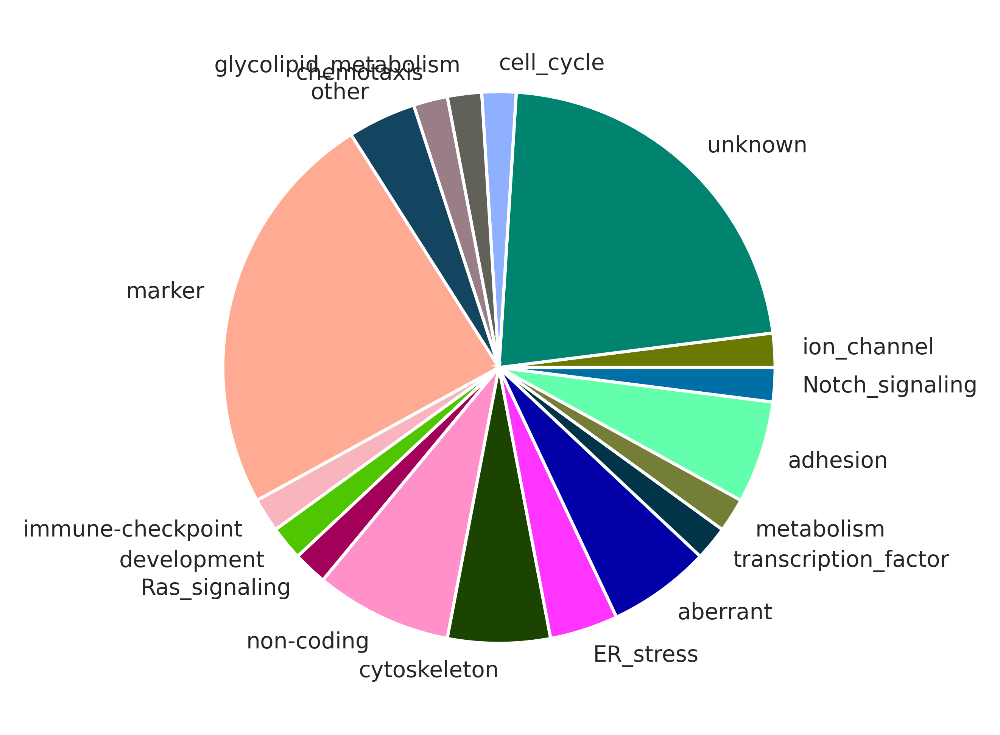

In [79]:
#plot
save_name = 'scHPF45_pie_interpret.svg'
fig, ax = plt.subplots()
plt.pie(counts, labels = labels,colors=[color_dict[x] for x in labels])
plt.savefig(figure_save_path+save_name)

### compare with SLALOM

In [40]:
SLALOM_LYS = list(adata_SLALOM.uns['SLALOM_markers_global']['SLALOM_9'])
SLALOM_LYS

['IGKC',
 'JCHAIN',
 'MZB1',
 'SSR4',
 'XBP1',
 'DERL3',
 'HERPUD1',
 'SEC11C',
 'HSP90B1',
 'FKBP11',
 'ITM2C',
 'PRDX4',
 'CD79A',
 'IGLL5',
 'FKBP2',
 'SSR3',
 'SEC61B',
 'UBE2J1',
 'SPCS2',
 'SPCS1',
 'PIM2',
 'SPCS3',
 'SDF2L1',
 'SELENOS',
 'MYDGF',
 'ERLEC1',
 'PDIA6',
 'LMAN1',
 'PLPP5',
 'TXNDC11',
 'MANF',
 'POU2AF1',
 'CD38',
 'DNAJB9',
 'TENT5C',
 'SDC1',
 'CRELD2',
 'SELENOM',
 'PDIA4',
 'TXNDC15',
 'HDLBP',
 'TNFRSF17',
 'RRBP1',
 'SEL1L',
 'CHPF',
 'SEL1L3',
 'JSRP1',
 'FCRL5',
 'ARSA',
 'LINC02362']

In [90]:
#which marker class of top plasma cell specific

marker_dict ={'IGKC':'marker',
 'JCHAIN':'marker',
 'MZB1':'marker',
 'SSR4':'protein_glycosylation',
 'XBP1':'ER_stress',
 'DERL3':'ER_stress',
 'HERPUD1':'ER_stress',
 'SEC11C':'ER_stress',
 'HSP90B1':'ER_stress',
 'FKBP11':'protein_synthesis',
 'ITM2C':'differentiation',
 'PRDX4':'NFkB_signaling',
 'CD79A':'marker',
 'IGLL5':'marker',
 'FKBP2':'protein_synthesis',
 'SSR3':'ER_stress',
 'SEC61B':'ER_protein_synthesis',
 'UBE2J1':'ER_stress',
 'SPCS2':'LYS_metabolism',
 'SPCS1':'LYS_metabolism',
 'PIM2':'survival',
 'SPCS3':'LYS_metabolism',
 'SDF2L1':'ER_stress',
 'SELENOS':'ER_stress',
 'MYDGF':'proliferation',
 'ERLEC1':'protein_glycosylation',
 'PDIA6':'ER_stress',
 'LMAN1':'protein_glycosylation',
 'PLPP5':'phospholipid_metabolism',
 'TXNDC11':'protein_synthesis',
 'MANF':'ER_stress',
 'POU2AF1':'transcription',
 'CD38':'marker',
 'DNAJB9':'ER_stress',
 'TENT5C':'transcription',
 'SDC1':'marker',
 'CRELD2':'calcium_signaling',
 'SELENOM':'aberrant',
 'PDIA4':'disulfide_bond',
 'TXNDC15':'disulfide_bond',
 'TNFRSF17':'marker',
 'HDLBP':'cholesterol_metabolism',
 'RRBP1':'ER_protein_synthesis',
 'SEL1L':'ER_stress',
 'CHPF':'protein_glycosylation',
 'JSRP1':'aberrant',
 'SEL1L3':'unknown',
 'FCRL5':'development',
 'ARSA':'glycolipid_metabolism',
 'LINC02362':'non-coding'}

In [91]:
len(set(marker_dict.keys()).intersection(set(SLALOM_LYS)))

50

In [92]:
color_dict = {'ER_protein_synthesis':'#1CE6FF',
 'ER_stress':'#FF34FF',
 'LYS_metabolism':'#FF4A46',
 'NFkB_signaling': '#008941',
 'Notch_signaling':'#006FA6',
 'Ras_signaling': '#A30059',
 'VitB6_metabolism': '#7A4900',
 'aberrant':'#0000A6',
 'adhesion':'#63FFAC',
 'autophagy': '#B79762',
 'calcium_signaling': '#004D43',
 'cell_cycle': '#8FB0FF',
 'chemotaxis':'#997D87',
 'cholesterol_metabolism':'#5A0007',
 'creatinine_metabolism': '#809693',
 'cytoskeleton': '#1B4400',
 'development': '#4FC601',
 'differentiation': '#3B5DFF',
 'disulfide_bond':'#4A3B53',
 'glutathione_metabolism':'#FF2F80',
 'glycolipid_metabolism':'#61615A',
 'hypoxia':'#BA0900',
 'ion_channel': '#6B7900',
 'lipid_metabolims':'#00C2A0',
 'marker':'#FFAA92',
 'non-coding': '#FF90C9',
 'phospholipid_metabolism': '#B903AA',
 'proliferation': '#D16100',
 'proline_metabolism': '#DDEFFF',
 'protein_glycosylation': '#000035',
 'protein_synthesis':'#7B4F4B',
 'signaling': '#A1C299',
 'survival': '#300018',
 'transcription': '#0AA6D8',
 'transcription_factor': '#013349',
 'unknown': '#00846F',
 'urea_cycle': '#372101'}


In [93]:
#count categories
counts = []
labels=[]
marker_class = [marker_dict[x] for x in SLALOM_LYS]

for i in set(marker_class):
    counts.append(marker_class.count(i))
    labels.append(i)

In [94]:
labels

['proliferation',
 'glycolipid_metabolism',
 'aberrant',
 'marker',
 'protein_glycosylation',
 'differentiation',
 'ER_protein_synthesis',
 'protein_synthesis',
 'NFkB_signaling',
 'phospholipid_metabolism',
 'LYS_metabolism',
 'calcium_signaling',
 'development',
 'cholesterol_metabolism',
 'disulfide_bond',
 'survival',
 'ER_stress',
 'non-coding',
 'transcription',
 'unknown']

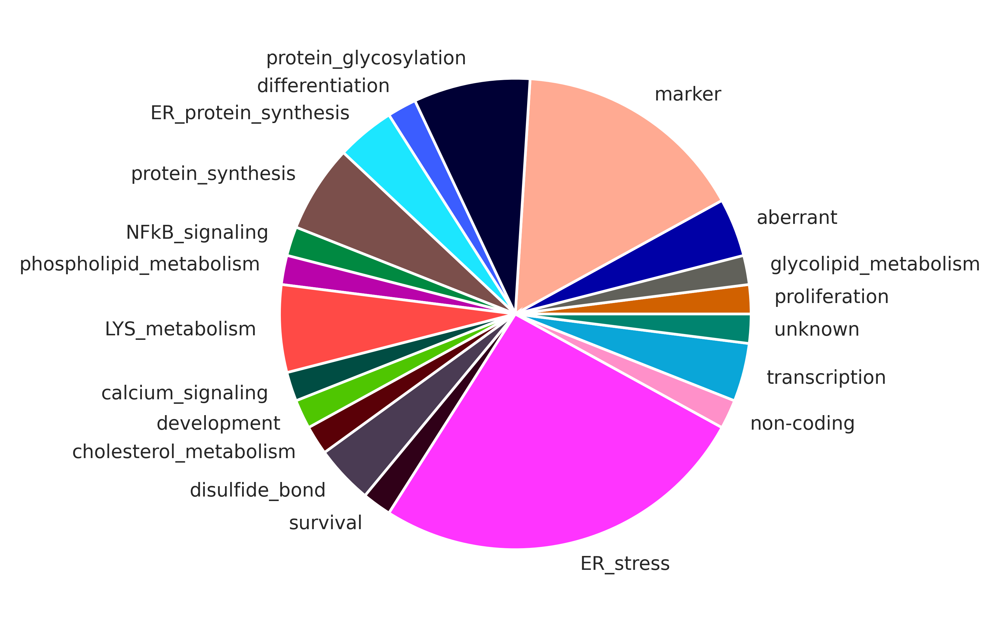

In [95]:
#plot
save_name = 'SLALOM_pie_interpret.svg'
fig, ax = plt.subplots()
plt.pie(counts, labels = labels,colors=[color_dict[x] for x in labels])
plt.savefig(figure_save_path+save_name)

# CD8 T cells

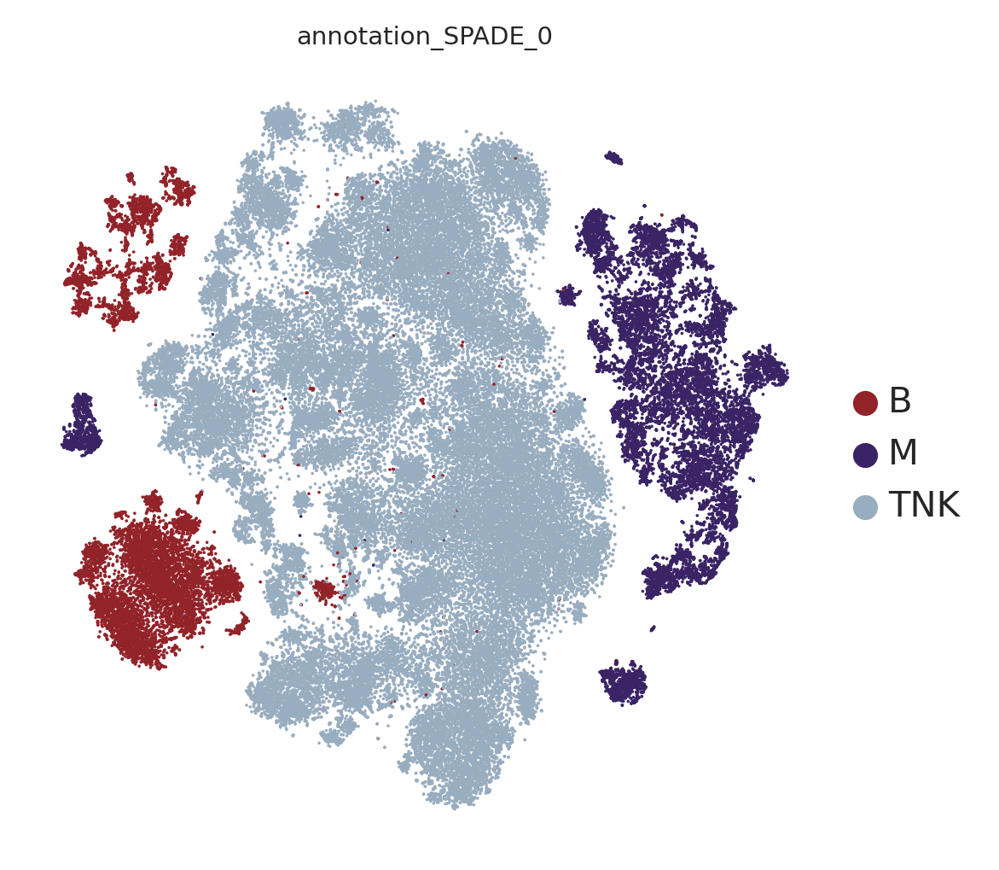

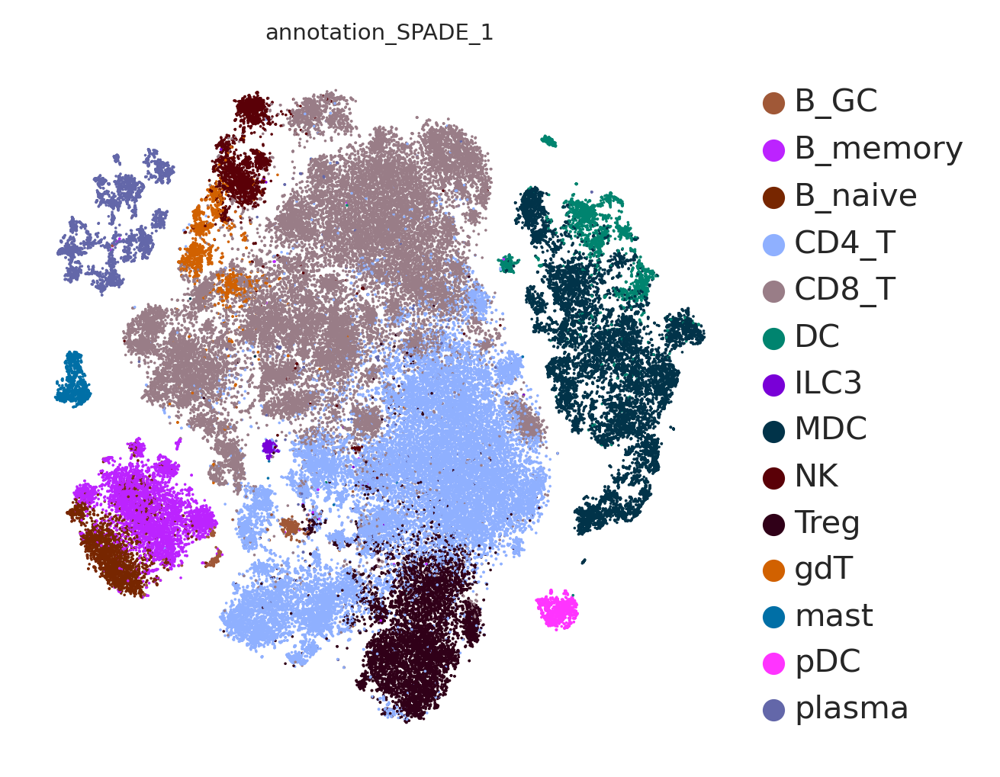

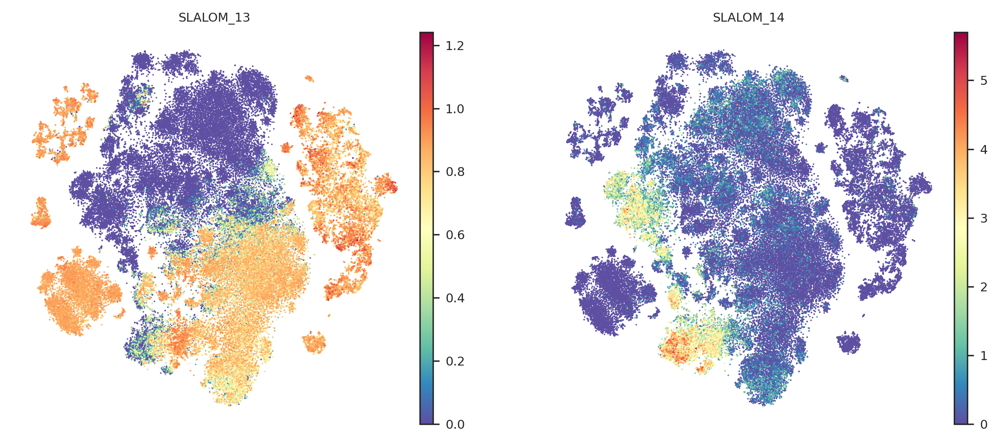

In [24]:
#SLALOM13 = tumor reaction #SLALOM14 = exhaustion
sc.pl.tsne(adata_SLALOM, color = ['annotation_SPADE_0'], s = 3, cmap='Spectral_r', legend_fontsize = 10, vmin=0)
sc.pl.tsne(adata_SLALOM, color = ['annotation_SPADE_1'], s = 3, cmap='Spectral_r', legend_fontsize = 10, vmin=0)
sc.pl.tsne(adata_SLALOM, color = ['SLALOM_13','SLALOM_14'], s = 3, cmap='Spectral_r', legend_fontsize = 10, vmin=0)

In [25]:
#restrict to CD8

adata_SPECTRA_celltype = adata_SPECTRA[adata_SPECTRA.obs['annotation_SPADE_1']=='CD8_T']
adata_SPECTRA_celltype

View of AnnData object with n_obs × n_vars = 31925 × 19984
    obs: 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'batch', 'cohort', 'total_molecules', 'ID', 'age_rounded_up', 'postmenopause', 'TNM_version', 'T_prefix', 'T', 'T_suffix', 'N_prefix', 'N', 'N_suffix', 'M_prefix', 'M', 'M_suffix', 'HER2', 'ER', 'PR', 'CTX', 'KI67_precent_range_prePD1', 'KI67_precent_range_postPD1', 'TCR_clonotype_expansion', 'Bassez_nCount_RNA', 'Bassez_nFeature_RNA', 'Bassez_patient_id', 'Bassez_timepoint', 'Bassez_expansion', 'Bassez_BC_type', 'Bassez_cellType', 'Bassez_cellSubType', 'n_genes', 'percent_mito', 'n_counts', 'doublets', 'major_subsets', 'pheno_k10', 'pheno_k20', 'pheno_k30', 'pheno_k40', 'pheno_k50', 'pheno_k60', 'pheno_k70', 'pheno_k80', 'pheno_k90', 'pheno_k100', 'pheno_var_k10', 'phen

In [26]:
#restrict to CD8

adata_SLALOM_celltype = adata_SLALOM[adata_SLALOM.obs['annotation_SPADE_1']=='CD8_T']
adata_SLALOM_celltype

View of AnnData object with n_obs × n_vars = 31925 × 19984
    obs: 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'batch', 'cohort', 'total_molecules', 'ID', 'age_rounded_up', 'postmenopause', 'TNM_version', 'T_prefix', 'T', 'T_suffix', 'N_prefix', 'N', 'N_suffix', 'M_prefix', 'M', 'M_suffix', 'HER2', 'ER', 'PR', 'CTX', 'KI67_precent_range_prePD1', 'KI67_precent_range_postPD1', 'TCR_clonotype_expansion', 'Bassez_nCount_RNA', 'Bassez_nFeature_RNA', 'Bassez_patient_id', 'Bassez_timepoint', 'Bassez_expansion', 'Bassez_BC_type', 'Bassez_cellType', 'Bassez_cellSubType', 'n_genes', 'percent_mito', 'n_counts', 'doublets', 'major_subsets', 'pheno_k10', 'pheno_k20', 'pheno_k30', 'pheno_k40', 'pheno_k50', 'pheno_k60', 'pheno_k70', 'pheno_k80', 'pheno_k90', 'pheno_k100', 'pheno_var_k10', 'phen

In [27]:
#restrict to CD8

adata_scHPF_celltype = adata_scHPF[adata_scHPF.obs['annotation_SPADE_1']=='CD8_T']
adata_scHPF_celltype

View of AnnData object with n_obs × n_vars = 31925 × 19984
    obs: 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'batch', 'cohort', 'total_molecules', 'ID', 'age_rounded_up', 'postmenopause', 'TNM_version', 'T_prefix', 'T', 'T_suffix', 'N_prefix', 'N', 'N_suffix', 'M_prefix', 'M', 'M_suffix', 'HER2', 'ER', 'PR', 'CTX', 'KI67_precent_range_prePD1', 'KI67_precent_range_postPD1', 'TCR_clonotype_expansion', 'Bassez_nCount_RNA', 'Bassez_nFeature_RNA', 'Bassez_patient_id', 'Bassez_timepoint', 'Bassez_expansion', 'Bassez_BC_type', 'Bassez_cellType', 'Bassez_cellSubType', 'n_genes', 'percent_mito', 'n_counts', 'doublets', 'major_subsets', 'pheno_k10', 'pheno_k20', 'pheno_k30', 'pheno_k40', 'pheno_k50', 'pheno_k60', 'pheno_k70', 'pheno_k80', 'pheno_k90', 'pheno_k100', 'pheno_var_k10', 'phen

(28766, 3)
['all_:_3.6397135507195997%', 'NE_:_0.52%', 'E_:_5.302142172013215%']
saved to: /data/peer/wallet/Jupyter/SPADE_Peer_validation/figures/Bassez-SLALOM_exhaust_correlation-scatter.svg
SpearmanrResult(correlation=-0.21354534602390543, pvalue=6.534191748325361e-294)


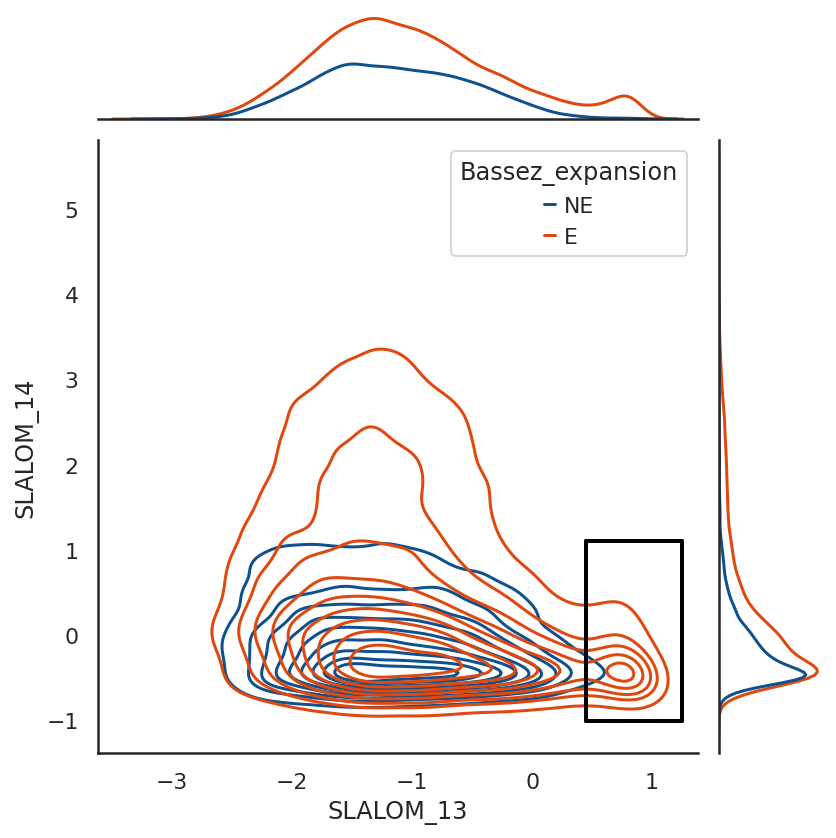

In [29]:
#density of tumor reactivity and exhaustion factors in responders and non-responders - SLALOM
%matplotlib inline
#create df for scatter
save_name = 'Bassez-SLALOM_exhaust_correlation-scatter.svg'
#create dict for batches to sample ids
clinical_var_key = 'Bassez_expansion'
use_gene_expression = True
hue_order = ['NE','E']
factor_list = ["SLALOM_14","SLALOM_13"]

zero_cutoff = None

df = adata_SLALOM_celltype[adata_SLALOM_celltype.obs[clinical_var_key].isin(hue_order)].obs[[clinical_var_key]+factor_list]
print(df.shape)

if zero_cutoff !=None:
    df = df[df[factor_list[0]]>zero_cutoff]
    print(df.shape)
    df = df[df[factor_list[1]]>zero_cutoff]
    print(df.shape)

#calculate correlation
title = scipy.stats.spearmanr(np.array(df[factor_list[0]]), np.array(df[factor_list[1]]), axis=0, nan_policy='propagate')

#plot
sns.set_theme(style="white")
#sns.relplot(x=factor_list[1], y=factor_list[0], hue=clinical_var_key,
  #          sizes=(40, 400), alpha=.5, palette=['#DF480F','#0E518F','#000000'],
 #           height=3, data=df,s=4)

g = sns.jointplot(
    data=df,
    x=df.columns[2], y=df.columns[1] ,hue=df.columns[0],hue_order = hue_order,palette=blue_red,
    kind="kde",
)

draw_square_gate(df, g, clinical_var_key, factor_list[1], factor_list[0], (0.45,1.25),(-1,1.1), 
                 width=2, color='#000000',print_absolute=False)


#plt.title(title)
save_name_complete = figure_save_path + save_name
plt.savefig(save_name_complete)
print('saved to:',save_name_complete)
print(title)

(28766, 3)
['all_:_8.774247375373704%', 'NE_:_8.12%', 'E_:_9.122881807524246%']
saved to: /data/peer/wallet/Jupyter/SPADE_Peer_validation/figures/Bassez-scHPF_exhaust_correlation-scatter.svg
SpearmanrResult(correlation=0.43533756835438586, pvalue=0.0)


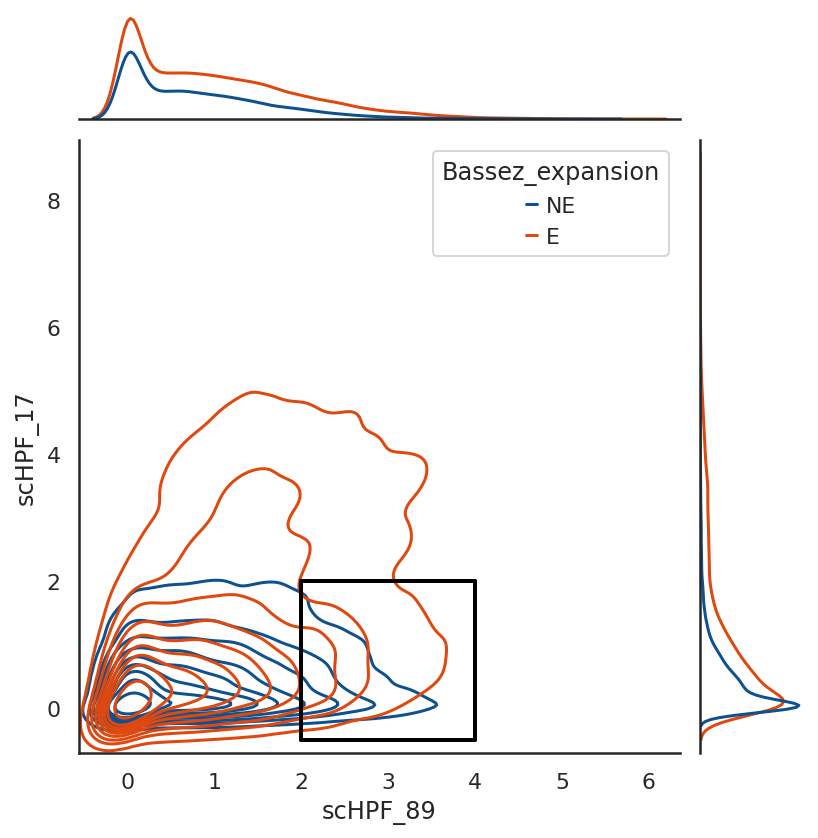

In [30]:
#density of tumor reactivity and exhaustion factors in responders and non-responders - scHPF
%matplotlib inline
#create df for scatter
save_name = 'Bassez-scHPF_exhaust_correlation-scatter.svg'
#create dict for batches to sample ids
clinical_var_key = 'Bassez_expansion'
use_gene_expression = True
hue_order = ['NE','E']
factor_list = ["scHPF_17","scHPF_89"]

zero_cutoff = None

df = adata_scHPF_celltype[adata_scHPF_celltype.obs[clinical_var_key].isin(hue_order)].obs[[clinical_var_key]+factor_list]
print(df.shape)

if zero_cutoff !=None:
    df = df[df[factor_list[0]]>zero_cutoff]
    print(df.shape)
    df = df[df[factor_list[1]]>zero_cutoff]
    print(df.shape)

#calculate correlation
title = scipy.stats.spearmanr(np.array(df[factor_list[0]]), np.array(df[factor_list[1]]), axis=0, nan_policy='propagate')

#plot
sns.set_theme(style="white")
#sns.relplot(x=factor_list[1], y=factor_list[0], hue=clinical_var_key,
  #          sizes=(40, 400), alpha=.5, palette=['#DF480F','#0E518F','#000000'],
 #           height=3, data=df,s=4)

g = sns.jointplot(
    data=df,
    x=df.columns[2], y=df.columns[1] ,hue=df.columns[0],hue_order = hue_order,palette=blue_red,
    kind="kde",
)

draw_square_gate(df, g, clinical_var_key, factor_list[1], factor_list[0], (2,4),(-0.5,2), 
                 width=2, color='#000000',print_absolute=False)


#plt.title(title)
save_name_complete = figure_save_path + save_name
plt.savefig(save_name_complete)
print('saved to:',save_name_complete)
print(title)

(28766, 3)
['all_:_13.397761245915316%', 'NE_:_2.35%', 'E_:_19.28487690504103%']
saved to: /data/peer/wallet/Jupyter/SPADE_Peer_validation/figures/Bassez-SPECTRA_exhaust_correlation-scatter.svg
SpearmanrResult(correlation=0.07206225442876901, pvalue=1.959049984792364e-34)


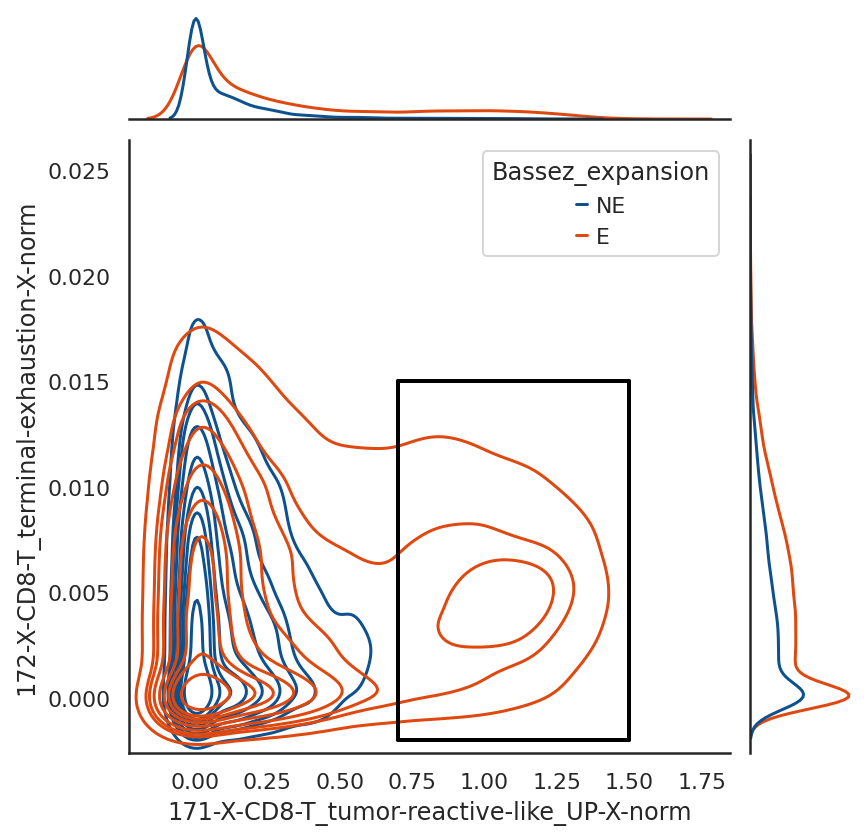

In [31]:
#density of tumor reactivity and exhaustion factors in responders and non-responders - Spectra
%matplotlib inline
#create df for scatter
save_name = 'Bassez-SPECTRA_exhaust_correlation-scatter.svg'
#create dict for batches to sample ids
clinical_var_key = 'Bassez_expansion'
use_gene_expression = True
hue_order = ['NE','E']
factor_list = ['172-X-CD8-T_terminal-exhaustion-X-norm','171-X-CD8-T_tumor-reactive-like_UP-X-norm']

zero_cutoff = None

df = adata_SPECTRA_celltype[adata_SPECTRA_celltype.obs[clinical_var_key].isin(hue_order)].obs[[clinical_var_key]+factor_list]
print(df.shape)

if zero_cutoff !=None:
    df = df[df[factor_list[0]]>zero_cutoff]
    print(df.shape)
    df = df[df[factor_list[1]]>zero_cutoff]
    print(df.shape)

#calculate correlation
title = scipy.stats.spearmanr(np.array(df[factor_list[0]]), np.array(df[factor_list[1]]), axis=0, nan_policy='propagate')

#plot
sns.set_theme(style="white")
#sns.relplot(x=factor_list[1], y=factor_list[0], hue=clinical_var_key,
  #          sizes=(40, 400), alpha=.5, palette=['#DF480F','#0E518F','#000000'],
 #           height=3, data=df,s=4)

g = sns.jointplot(
    data=df,
    x=df.columns[2], y=df.columns[1] ,hue=df.columns[0],hue_order = hue_order,palette=blue_red,
    kind="kde",
)

draw_square_gate(df, g, clinical_var_key, factor_list[1], factor_list[0], (0.7,1.5),(-0.002,0.015), 
                 width=2, color='#000000',print_absolute=False)


#plt.title(title)
save_name_complete = figure_save_path + save_name
plt.savefig(save_name_complete)
print('saved to:',save_name_complete)
print(title)

## compare mean cell scores per sample in CD8 T cells responders vs non-responders

### SLALOM

In [32]:
#calculate aggregate factor loadings per batch

#set parameters0
factor_name_list_corr = ['SLALOM_0', 'SLALOM_1', 'SLALOM_2', 'SLALOM_3', 'SLALOM_4', 'SLALOM_5', 'SLALOM_6', 'SLALOM_7',
                         'SLALOM_8', 'SLALOM_9', 'SLALOM_10', 'SLALOM_11', 
                         'SLALOM_12', 'SLALOM_13', 'SLALOM_14', 'SLALOM_15', 'SLALOM_16', 'SLALOM_17', 'SLALOM_18', 'SLALOM_19']
clinical_var_obs = 'Bassez_timepoint' #obs for clinical variable to correlate with
clinical_var2_obs = 'Bassez_expansion'
patient_obs = 'Bassez_patient_id'
obs_columns = ['clinical_var','clinical_var2','patient'] #these will store the obs above and will be dropped for calculations
zero_cutoff = None
#zero_cutoff = 0.01
#define parameters
#factor_name_list_corr = list(set(adata_SLALOM_celltype.uns['SPADE_markers_global'].keys()))


df_batches = aggregate_cell_scores(adata_SLALOM_celltype,clinical_var_obs,clinical_var2_obs,factor_name_list_corr,batch_key='batch',
                      patient_obs=patient_obs,
                            obs_columns=['clinical_var','clinical_var2','patient'],
                            zero_cutoff =zero_cutoff)



In [240]:
#wilcoxon matched pairs test

result= compare_factors(df_batches[df_batches['clinical_var']=='Pre'], 'SLALOM_13','patient','clinical_var2',
                       ['E','NE'], test='mann-whitney')
result

MannwhitneyuResult(statistic=198.0, pvalue=0.38393711022388266)

In [52]:
df_sub = df_batches[df_batches['clinical_var']=='Pre']
df_sub_1 = df_sub[df_sub['clinical_var2']=='NE']
df_sub_2  = df_sub[df_sub['clinical_var2']=='E']
(np.mean(df_sub_1['SLALOM_13'])-np.mean(df_sub_2['SLALOM_13']))/np.std(list(df_sub_1['SLALOM_13'])+list(df_sub_2['SLALOM_13']))

-0.2485902759113339

In [53]:
df_sub = df_batches[df_batches['clinical_var']=='On']
df_sub_1 = df_sub[df_sub['clinical_var2']=='NE']
df_sub_2  = df_sub[df_sub['clinical_var2']=='E']
(np.mean(df_sub_1['SLALOM_13'])-np.mean(df_sub_2['SLALOM_13']))/np.std(list(df_sub_1['SLALOM_13'])+list(df_sub_2['SLALOM_13']))

0.05923813176103523

In [56]:
#wilcoxon matched pairs test
import scipy
result= compare_factors(df_batches[df_batches['clinical_var']=='On'], 'SLALOM_13','patient','clinical_var2',
                       ['E','NE'], test='mann-whitney')
result

NameError: name 'scipy' is not defined

saved to: /data/peer/wallet/Jupyter/SPADE_Peer_validation/figures/SLALOM_13.svg


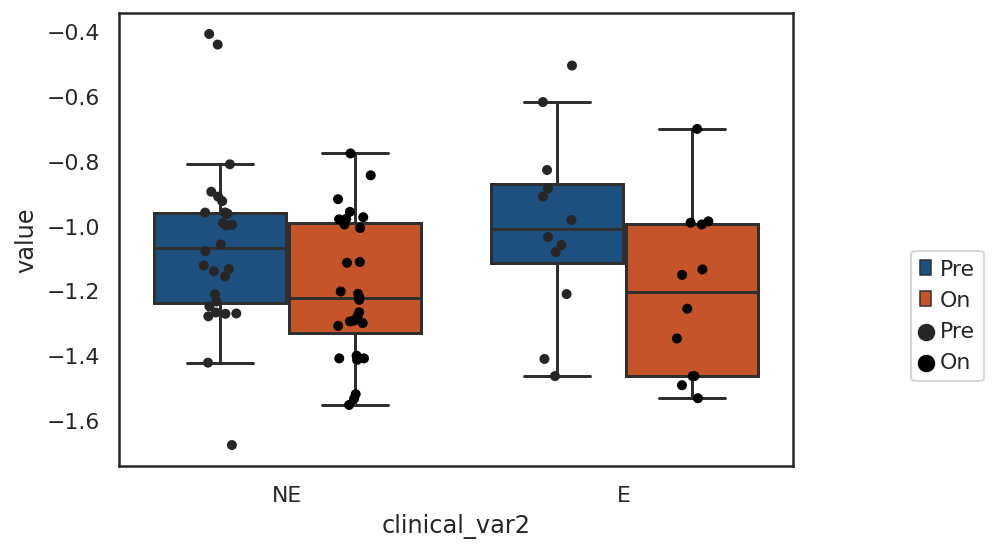

In [57]:
gene_set = 'SLALOM_13'
save_name = gene_set + '.svg'

clinical_var_to_include = ['Pre','On']
clinical_var_to_include2 = ['NE','E',]
sns.set_style('white')
df_plot = df_batches.copy()   
df_plot = df_plot.melt(id_vars=['clinical_var','clinical_var2'])
df_plot = df_plot[df_plot['variable']==gene_set]
df_plot = df_plot[df_plot['clinical_var'].isin(clinical_var_to_include)]
df_plot = df_plot[df_plot['clinical_var2'].isin(clinical_var_to_include2)]

ax = sns.boxplot(x='clinical_var2',y='value',hue='clinical_var',data=df_plot, showfliers = False,
                hue_order=clinical_var_to_include,order=clinical_var_to_include2,palette=timepoint_dict)
sns.stripplot(x='clinical_var2',y='value',hue='clinical_var',data=df_plot, color='#000000',dodge=True,
             hue_order=clinical_var_to_include,order=clinical_var_to_include2)
#ax.set_ylim(0,)
plt.legend(bbox_to_anchor=(0.8, 0., 0.5, 0.5))
save_name_complete = figure_save_path + save_name
plt.savefig(save_name_complete)
print('saved to:',save_name_complete)

## scHPF

In [59]:
#calculate aggregate factor loadings per batch

#set parameters0
factor_name_list_corr = ['scHPF_0', 'scHPF_1', 'scHPF_2', 'scHPF_3', 'scHPF_4', 'scHPF_5', 'scHPF_6', 'scHPF_7', 'scHPF_8', 'scHPF_9',
                         'scHPF_10', 'scHPF_11', 'scHPF_12', 'scHPF_13', 'scHPF_14', 'scHPF_15', 'scHPF_16', 'scHPF_17', 'scHPF_18',
                         'scHPF_19', 'scHPF_20', 'scHPF_21', 'scHPF_22', 'scHPF_23', 'scHPF_24', 'scHPF_25', 'scHPF_26', 'scHPF_27',
                         'scHPF_28', 'scHPF_29', 'scHPF_30', 'scHPF_31', 'scHPF_32', 'scHPF_33', 'scHPF_34', 'scHPF_35', 'scHPF_36',
                         'scHPF_37', 'scHPF_38', 'scHPF_39', 'scHPF_40', 'scHPF_41', 'scHPF_42', 'scHPF_43', 'scHPF_44', 'scHPF_45', 
                         'scHPF_46', 'scHPF_47', 'scHPF_48', 'scHPF_49', 'scHPF_50', 'scHPF_51', 'scHPF_52', 'scHPF_53', 'scHPF_54', 
                         'scHPF_55', 'scHPF_56', 'scHPF_57', 'scHPF_58', 'scHPF_59', 'scHPF_60', 'scHPF_61', 'scHPF_62', 'scHPF_63', 
                         'scHPF_64', 'scHPF_65', 'scHPF_66', 'scHPF_67', 'scHPF_68', 'scHPF_69', 'scHPF_70', 'scHPF_71', 'scHPF_72',
                         'scHPF_73', 'scHPF_74', 'scHPF_75', 'scHPF_76', 'scHPF_77', 'scHPF_78', 'scHPF_79', 
                         'scHPF_80', 'scHPF_81', 'scHPF_82', 'scHPF_83', 'scHPF_84', 'scHPF_85', 'scHPF_86', 'scHPF_87', 
                         'scHPF_88', 'scHPF_89', 'scHPF_90', 'scHPF_91', 'scHPF_92', 'scHPF_93', 'scHPF_94', 'scHPF_95', 
                         'scHPF_96', 'scHPF_97', 'scHPF_98', 'scHPF_99']
clinical_var_obs = 'Bassez_timepoint' #obs for clinical variable to correlate with
clinical_var2_obs = 'Bassez_expansion'
patient_obs = 'Bassez_patient_id'
obs_columns = ['clinical_var','clinical_var2','patient'] #these will store the obs above and will be dropped for calculations
zero_cutoff = 0.001


df_batches = aggregate_cell_scores(adata_scHPF_celltype,clinical_var_obs,clinical_var2_obs,factor_name_list_corr,batch_key='batch',
                      patient_obs=patient_obs,
                            obs_columns=['clinical_var','clinical_var2','patient'],
                            zero_cutoff =zero_cutoff)



/home/wallet/.local/lib/python3.10/site-packages/pandas/core/indexing.py:1684: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead.  To get a de-fragmented frame, use `newframe = frame.copy()`
  self.obj[key] = infer_fill_value(value)


In [232]:
#wilcoxon matched pairs test

result= compare_factors(df_batches[df_batches['clinical_var']=='On'], 'scHPF_89','patient','clinical_var2',
                       ['E','NE'], test='mann-whitney')
result

MannwhitneyuResult(statistic=216.0, pvalue=0.16093968296119787)

In [64]:
df_sub = df_batches[df_batches['clinical_var']=='Pre']
df_sub_1 = df_sub[df_sub['clinical_var2']=='NE']
df_sub_2  = df_sub[df_sub['clinical_var2']=='E']
(np.mean(df_sub_1['scHPF_89'])-np.mean(df_sub_2['scHPF_89']))/np.std(list(df_sub_1['scHPF_89'])+list(df_sub_2['scHPF_89']))

-0.467121616654345

In [231]:
#wilcoxon matched pairs test

result= compare_factors(df_batches[df_batches['clinical_var']=='Pre'], 'scHPF_89','patient','clinical_var2',
                       ['E','NE'], test='mann-whitney')
result

MannwhitneyuResult(statistic=201.0, pvalue=0.33745438856130017)

In [65]:
df_sub = df_batches[df_batches['clinical_var']=='On']
df_sub_1 = df_sub[df_sub['clinical_var2']=='NE']
df_sub_2  = df_sub[df_sub['clinical_var2']=='E']
(np.mean(df_sub_1['scHPF_89'])-np.mean(df_sub_2['scHPF_89']))/np.std(list(df_sub_1['scHPF_89'])+list(df_sub_2['scHPF_89']))

-0.5921749273445479

saved to: /data/peer/wallet/Jupyter/SPADE_Peer_validation/figures/scHPF_89.svg


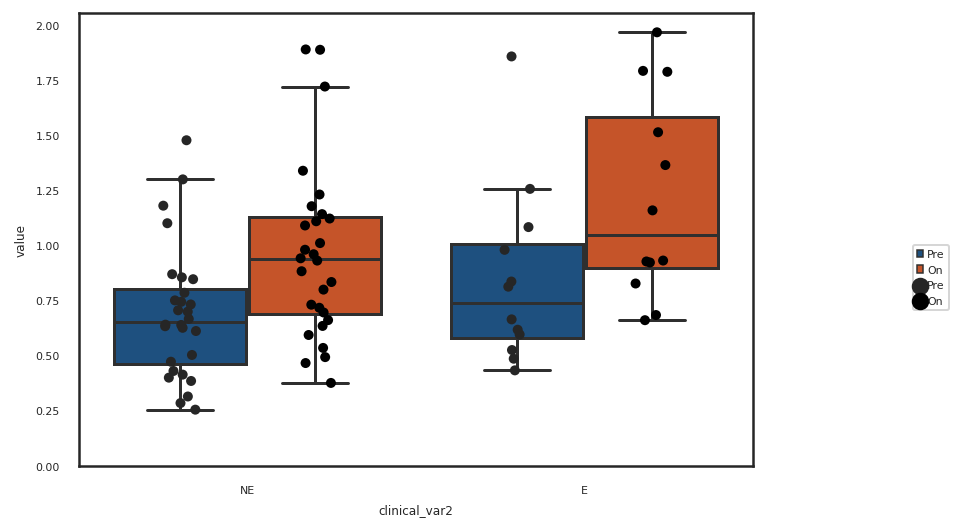

In [173]:
gene_set = 'scHPF_89'
save_name = gene_set + '.svg'

clinical_var_to_include = ['Pre','On']
clinical_var_to_include2 = ['NE','E',]
sns.set_style('white')
df_plot = df_batches.copy()   
df_plot = df_plot.melt(id_vars=['clinical_var','clinical_var2'])
df_plot = df_plot[df_plot['variable']==gene_set]
df_plot = df_plot[df_plot['clinical_var'].isin(clinical_var_to_include)]
df_plot = df_plot[df_plot['clinical_var2'].isin(clinical_var_to_include2)]

ax = sns.boxplot(x='clinical_var2',y='value',hue='clinical_var',data=df_plot, showfliers = False,
                hue_order=clinical_var_to_include,order=clinical_var_to_include2,palette=timepoint_dict)
sns.stripplot(x='clinical_var2',y='value',hue='clinical_var',data=df_plot, color='#000000',dodge=True,
             hue_order=clinical_var_to_include,order=clinical_var_to_include2)
ax.set_ylim(0,)
plt.legend(bbox_to_anchor=(0.8, 0., 0.5, 0.5))
save_name_complete = figure_save_path + save_name
plt.savefig(save_name_complete)
print('saved to:',save_name_complete)

# intersection of tumor reactivity and exhaustion marker genes

In [11]:
#intersection exhaustion and reactivity
a = set(adata_SLALOM.uns['SLALOM_markers_global']['SLALOM_14'])
b = set(adata_SLALOM.uns['SLALOM_markers_global']['SLALOM_13'])

intersection = a.intersection(b)
a_not_b = a - b
b_not_a = b - a


print('intersection:',intersection)
print('only exhausted',a_not_b)
print('only tumor-reactive', b_not_a)

NameError: name 'adata_SLALOM' is not defined

In [14]:
#intersection exhaustion and reactivity
a = set(input_df[input_df['gs.name']=='all_MHC-II-presentation']['g.name'])
b = set(input_df[input_df['gs.name']=='all_type-II-ifn-response']['g.name'])

intersection = a.intersection(b)
a_not_b = a - b
b_not_a = b - a


print('intersection:',intersection)
print('only exhausted',a_not_b)
print('only tumor-reactive', b_not_a)

intersection: {'HLA-DMA', 'HLA-DPB1', 'HLA-DRA', 'HLA-DMB', 'HLA-DPA1', 'HLA-DQB1', 'HLA-DOB', 'HLA-DQA1'}
only exhausted {'RILP', 'HLA-DPA2', 'ARL14', 'AP2A2', 'CREB1', 'HLA-DRB6', 'HLA-DRB9', 'HLA-DPB2', 'RELA', 'NFYB', 'HLA-DRB5', 'RAB7B', 'HLA-DRB1', 'CD83', 'AP2M1', 'AP2A1', 'RAB7A', 'HLA-DPA3', 'HLA-DQA2', 'AP2S1', 'SPI1', 'ARL14EP', 'MYO1E', 'HLA-DQB2', 'CIITA', 'RFX5', 'SP1', 'IRF8', 'CD74', 'HLA-DQB3', 'NFYA', 'AP2B1', 'NFYC'}
only tumor-reactive {'HLA-G', 'MYC', 'IRF1', 'HLA-E', 'CXCL9', 'HLA-DRB4', 'HLA-DRB3', 'CD274', 'CXCL10'}


/data/peer/wallet/Jupyter/SPADE_Peer_validation/figures/Bassez_IFN_MHC_gs_venn.svg


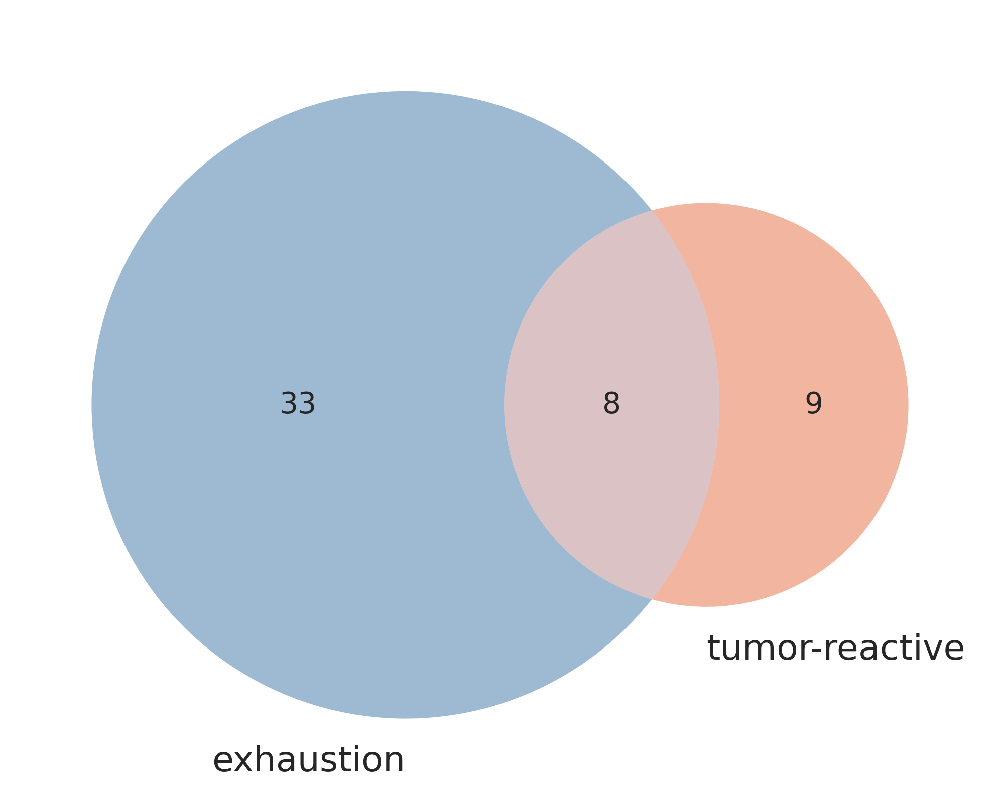

In [15]:
#plot venn
from matplotlib_venn import venn2, venn2_circles, venn2_unweighted
from matplotlib_venn import venn3, venn3_circles
from matplotlib import pyplot as plt

venn2(subsets=(len(a_not_b),len(b_not_a),len(intersection)),set_labels=('exhaustion','tumor-reactive'),
     set_colors= blue_red)
figure_save_path_complete = figure_save_path+'Bassez_IFN_MHC_gs_venn'+'.svg'
plt.savefig(figure_save_path_complete,dpi=300)
print(figure_save_path_complete)

In [62]:
#intersection exhaustion and reactivity
a = set(adata_SPECTRA.uns['SPADE_markers_specific']['CD8_T']['172-X-CD8-T_terminal-exhaustion'])
b = set(adata_SPECTRA.uns['SPADE_markers_specific']['CD8_T']['171-X-CD8-T_tumor-reactive-like_UP'])

intersection = a.intersection(b)
a_not_b = a - b
b_not_a = b - a


print('intersection:',intersection)
print('only exhausted',a_not_b)
print('only tumor-reactive', b_not_a)

intersection: {'NR4A3', 'LCK', 'LAG3', 'HAVCR2'}
only exhausted {'BTG1', 'CCL3L1', 'ENC1', 'LYST', 'NFATC2', 'IRF4', 'SRGN', 'DKK3', 'PRKCH', 'NR4A2', 'HSP90AA1', 'FYN', 'HNRNPLL', 'EOMES', 'DTHD1', 'CXCR4', 'NR4A1', 'TOX', 'IL32', 'DNAJB1', 'CD74', 'ID2', 'RGS1', 'PFN1', 'PDCD1', 'ERN1', 'CMC1', 'HERPUD1', 'TNFSF9', 'DUSP2', 'COTL1', 'CST7', 'CRTAM', 'CEMIP2', 'ACTB', 'TAGAP', 'CD244', 'CD27', 'CD69', 'PRDM1', 'CCL4', 'TIGIT', 'TRAT1', 'SH2D1A', 'CBLB', 'DUSP4'}
only tumor-reactive {'IL10RB', 'GALNT2', 'ITGAE', 'BTN3A2', 'LAYN', 'SLA', 'IFNG', 'CXCL13', 'GZMA', 'GZMM', 'ZBTB32', 'TNFRSF9', 'ENTPD1', 'LINC02195', 'FBXW7', 'SH2D2A', 'LCP2', 'RBPJ', 'TNFRSF18', 'CCL3', 'STAT5A', 'FASLG', 'CCR1', 'CD8B', 'PRF1', 'TESPA1', 'SEMA7A', 'GBP1', 'CIC', 'GFI1', 'TNFRSF4', 'GADD45G', 'GZMH', 'DOK2', 'ITM2A', 'MTHFD2', 'NFATC1', 'RHOH', 'LAX1', 'BATF', 'KRT86', 'CD38', 'LTA', 'GNLY', 'MKI67', 'GZMB'}


/data/peer/wallet/Jupyter/SPADE_Peer_validation/figures/Bassez_SPECTRA_exhaust-reactive_venn.svg


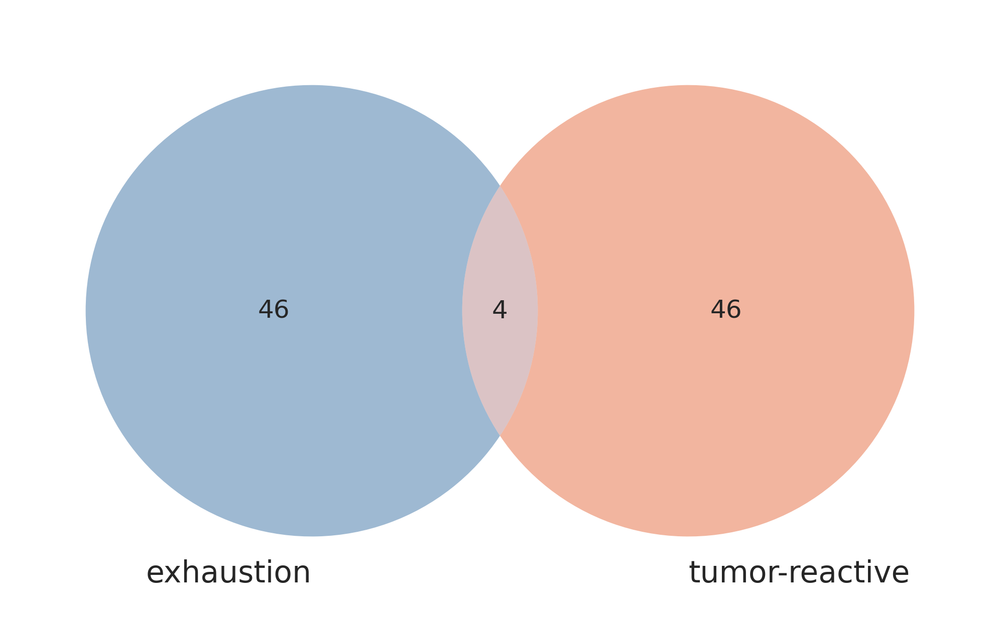

In [63]:
#plot venn
from matplotlib_venn import venn2, venn2_circles, venn2_unweighted
from matplotlib_venn import venn3, venn3_circles
from matplotlib import pyplot as plt

venn2(subsets=(len(a_not_b),len(b_not_a),len(intersection)),set_labels=('exhaustion','tumor-reactive'),
     set_colors= blue_red)
figure_save_path_complete = figure_save_path+'Bassez_SPECTRA_exhaust-reactive_venn'+'.svg'
plt.savefig(figure_save_path_complete,dpi=300)
print(figure_save_path_complete)

In [64]:
#intersection exhaustion and reactivity
a = set(adata_scHPF.uns['scHPF_markers_global']['scHPF_17'])
b = set(adata_scHPF.uns['scHPF_markers_global']['scHPF_89'])

intersection = a.intersection(b)
a_not_b = a - b
b_not_a = b - a


print('intersection:',intersection)
print('only exhausted',a_not_b)
print('only tumor-reactive', b_not_a)

intersection: {'IFNG', 'LAG3', 'AC243829.4'}
only exhausted {'GALNT2', 'ITGAE', 'CD200R1', 'DAPK2', 'GLDC', 'LINC01934', 'DGKH', 'SIRPG', 'CXCL13', 'AC090152.1', 'MIR155HG', 'LINC01871', 'IL13', 'ASMT', 'TOX', 'LINC02195', 'SLC27A2', 'ST6GALNAC3', 'HAVCR2', 'ETV1', 'PTGIS', 'PARD6G', 'PDCD1', 'LRRN3', 'SV2A', 'ITGA2', 'SLC16A8', 'SNAP47', 'SARDH', 'ATP9A', 'GFOD1', 'GFI1', 'OTOF', 'ADGRG1', 'IL26', 'SLC2A8', 'KIAA1671', 'PLPP1', 'TNFSF4', 'RAB27A', 'L1CAM', 'KRT86', 'TIGIT', 'CXCR6', 'FAM166B', 'SH3BGRL2', 'DUSP4'}
only tumor-reactive {'CCL3L1', 'ITGAD', 'VCAM1', 'NSMF', 'B3GAT1', 'CCL4L2', 'GZMA', 'EOMES', 'TIMD4', 'CSF1', 'PLCXD2', 'TNFRSF9', 'PTMS', 'AC103702.2', 'NKG7', 'AC243829.1', 'RUNX3', 'JAKMIP1', 'CCL3', 'KLRC4', 'SLA2', 'FASLG', 'TNFSF9', 'PRF1', 'PPP2R2B', 'SLC6A3', 'TNIP3', 'CCR5', 'KIF5A', 'TTC16', 'AL160291.1', 'CD8A', 'HRASLS2', 'VNN2', 'PIF1', 'CCL5', 'GZMH', 'CST7', 'SYTL3', 'CD244', 'ASCL1', 'VPS37B', 'RCAN2', 'CCL4', 'PRSS23', 'SCD5', 'GZMB'}


/data/peer/wallet/Jupyter/SPADE_Peer_validation/figures/Bassez_scHPF_exhaust-reactive_venn.svg


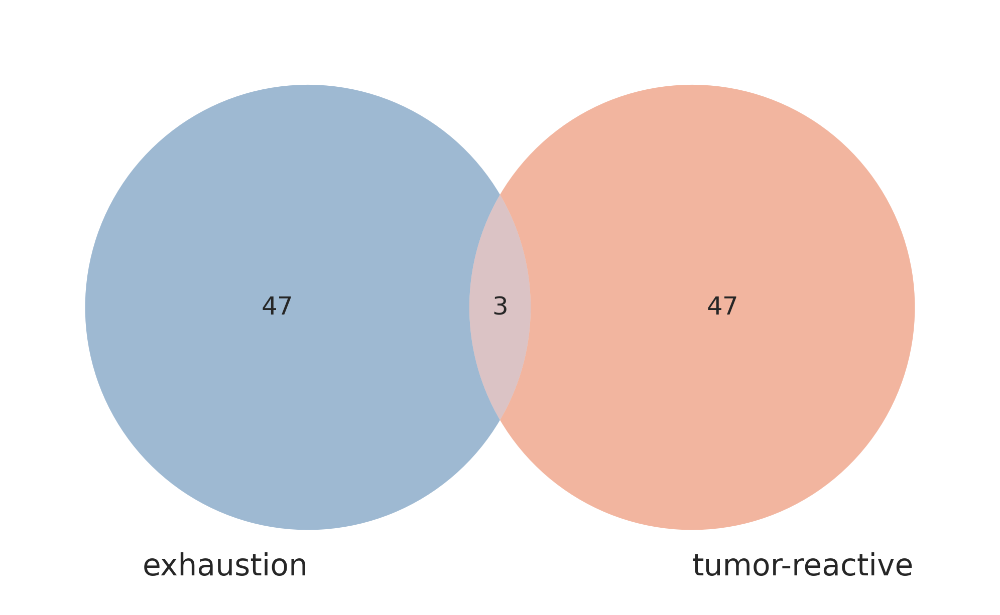

In [65]:
#plot venn
from matplotlib_venn import venn2, venn2_circles, venn2_unweighted
from matplotlib_venn import venn3, venn3_circles
from matplotlib import pyplot as plt

venn2(subsets=(len(a_not_b),len(b_not_a),len(intersection)),set_labels=('exhaustion','tumor-reactive'),
     set_colors= blue_red)
figure_save_path_complete = figure_save_path+'Bassez_scHPF_exhaust-reactive_venn'+'.svg'
plt.savefig(figure_save_path_complete,dpi=300)
print(figure_save_path_complete)